In [1]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
import keras
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(0)
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV
from scipy.stats import multivariate_normal
from keras.optimizers import Adam, SGD, Adadelta



In [2]:
x_train_scaled = pd.read_csv('../260_sample_train_scaled.csv').set_index("Patient_ID")
x_train_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.529274,0.0,0.0,0.364776,0.465986,0.922559,0.854193,0.224260,0.883418,0.0
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.485551,0.0,0.0,0.522378,0.578564,0.522145,0.692076,0.021080,0.517763,0.0
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.682864,0.0,0.0,0.042221,0.025102,0.789751,0.878183,0.048352,0.429987,0.0
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.760504,0.0,0.0,0.517359,0.672548,0.565864,0.505961,0.021080,0.490510,0.0
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.601023,0.0,0.0,0.490289,0.858259,0.686037,0.392018,0.021080,0.633386,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.403338,0.0,0.0,0.568061,0.445374,0.442044,0.695490,0.021080,0.324311,0.0
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.563382,0.0,0.0,0.457702,0.485198,0.507829,0.801229,0.021080,0.574480,0.0
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.278042,0.0,0.0,0.474069,0.769644,0.659954,0.314433,0.167705,0.847694,0.0


In [3]:
x_test_scaled = pd.read_csv('../data/260_sample_test_scaled.csv').set_index("Patient_ID")
x_test_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.841880,0.930171,0.886737,0.835678,0.297964,0.668498,0.266670,0.278122,0.933520,...,0.799811,0.0,0.0,0.315927,0.580699,0.652889,0.283662,0.021080,0.271046,0.0
105_CD_plain,0.853562,0.933532,0.942213,0.794578,0.890482,0.206529,0.298987,0.350745,0.495663,0.849038,...,0.843182,0.0,0.0,0.233173,0.420656,0.461041,0.783732,0.050226,0.510625,0.0
2_CD_plain,0.165531,0.141475,0.263684,0.198091,0.160503,0.888878,0.000000,0.134461,0.989132,0.202203,...,0.442893,0.0,0.0,1.044816,0.972319,0.998363,0.013298,0.021080,0.674434,0.0
184_CD_plain,0.717121,0.660314,0.769417,0.752737,0.694874,0.514735,0.692365,0.271127,0.650742,0.694599,...,0.511169,0.0,0.0,0.457879,0.591956,0.665982,0.460966,0.066515,0.616797,0.0
312_CD_plain,0.730072,0.722909,0.713076,0.743545,0.679258,0.308459,0.399235,0.129019,0.597529,0.720390,...,0.498080,0.0,0.0,0.583310,0.741909,0.691929,0.483119,0.021080,0.646119,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.273104,0.0,0.0,0.511460,0.571813,0.718136,0.624635,0.021080,0.939056,0.0
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.540150,0.0,0.0,0.967121,0.690670,0.586834,0.731743,0.021080,0.312015,0.0
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.561707,0.0,0.0,0.532892,0.827410,0.584298,0.217127,0.195470,0.876301,0.0


In [4]:
sh = x_train_scaled.head(1).shape

In [5]:
patient_ids_train = np.array(x_train_scaled.index)
patient_ids_test = np.array(x_test_scaled.index)
patient_ids_train

array(['55_control', '168_CD_plain', '72_control', '120_control',
       '258_CD_plain', '254_CD_deep_ulcer', '9_CD_plain', '111_CD_plain',
       '57_CD_plain', '216_CD_deep_ulcer', '263_CD_deep_ulcer',
       '95_CD_deep_ulcer', '31_control', '172_CD_plain', '310_CD_plain',
       '68_CD_plain', '65_control', '285_CD_plain', '201_CD_plain',
       '223_CD_deep_ulcer', '320_CD_plain', '8_CD_plain',
       '99_CD_deep_ulcer', '90_control', '296_CD_deep_ulcer',
       '219_CD_deep_ulcer', '138_CD_deep_ulcer', '38_control',
       '113_CD_plain', '76_control', '146_CD_deep_ulcer',
       '147_CD_deep_ulcer', '186_CD_plain', '158_CD_plain',
       '299_CD_plain', '178_CD_plain', '189_CD_plain', '266_CD_plain',
       '231_CD_deep_ulcer', '198_CD_plain', '6_CD_deep_ulcer',
       '30_CD_plain', '265_CD_plain', '181_CD_deep_ulcer', '16_CD_plain',
       '264_CD_deep_ulcer', '209_CD_plain', '83_control', '214_CD_plain',
       '193_CD_deep_ulcer', '104_CD_plain', '66_CD_plain', '188_CD_plain

In [6]:
def classify(x):
    if "_control" in x: # control
        return 0
    elif "CD_plain" in x: # Crohn's Disease no deep ulcer
#         print(x)
        return 1
    elif "CD_deep_ulcer" in x: # Crohn's Disease deep ulcer
#         print(x)
        return 2
    else:
        return 3 # Ulcerative Collitis

vec = np.vectorize(classify)

disease_labels_train = vec(patient_ids_train)
disease_labels_test = vec(patient_ids_test)
disease_labels_train

array([0, 1, 0, 0, 1, 2, 1, 1, 1, 2, 2, 2, 0, 1, 1, 1, 0, 1, 1, 2, 1, 1,
       2, 0, 2, 2, 2, 0, 1, 0, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2,
       1, 2, 1, 0, 1, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1,
       1, 1, 2, 2, 2, 1, 0, 0, 0, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 0, 1, 2,
       1, 2, 0, 0, 1, 2, 2, 1, 1, 2, 2, 0, 1, 2, 1, 2, 1, 0, 2, 1, 1, 1,
       2, 1, 1, 1, 1, 2, 1, 1, 1, 0, 1, 0, 1, 1, 0, 2, 2, 2, 0, 1, 1, 2,
       2, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 0, 1, 1, 1, 1, 2, 1, 1,
       1, 2, 1, 1, 0, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 2, 0,
       0, 1, 1, 1, 1, 1])

## Add layers to encoder to build classifier

In [7]:
n_inputs = 220
n_bottleneck = 32
encoder_base = Sequential(
            [

#                 Input(shape=(n_inputs,)),
                # encoder level 1
                Dense(n_inputs*2),
                BatchNormalization(),
                LeakyReLU(),
                # encoder level 2
                Dense(n_inputs),
                BatchNormalization(),
                LeakyReLU(),
                # bottleneck
                Dense(n_bottleneck)
            ]
        )

In [8]:
encoder_base.load_weights("../data/models/encoder_ckpt")

In [9]:
# encoder_base.trainable = False
encoder_base.build(sh) 
encoder_base.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (1, 440)                  97240     
                                                                 
 batch_normalization (BatchN  (1, 440)                 1760      
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (1, 440)                  0         
                                                                 
 dense_1 (Dense)             (1, 220)                  97020     
                                                                 
 batch_normalization_1 (Batc  (1, 220)                 880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (1, 220)                  0

In [10]:
## Logistic regression

In [13]:

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import MinMaxScaler



# encode data
X_train_encode = encoder_base(x_train_scaled.values)
X_test_encode = encoder_base(x_test_scaled.values)

t = MinMaxScaler()
t.fit(X_train_encode)
X_train = t.transform(X_train_encode)
X_test = t.transform(X_test_encode)

model = LogisticRegression()
model.fit(X_train, disease_labels_train)
y_pred = model.predict(X_test)

accuracy = accuracy_score(disease_labels_test, y_pred)
print(accuracy)


0.6410256410256411


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [14]:
x_train_scaled.shape

(182, 220)

In [15]:
# inputs = keras.Input(shape=(219,))
# x = encoder_base(inputs, training=False)
inter = Dense(24, activation='relu')

In [33]:
# inter = Dense(24, activation='relu')(x)
# outputs = Dense(3, activation='softmax')(inter)
# compound_model = Model(inputs, outputs)

init_fn = tf.keras.initializers.GlorotUniform() # maybe update

compound_model = keras.models.clone_model(encoder_base) 
compound_model.add(Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros()))
compound_model.add(Dense(3, activation='softmax', kernel_initializer=init_fn, bias_initializer=initializers.Zeros()))

In [34]:
x_train_scaled.head(1).values.flatten().shape

(220,)

In [35]:
y = compound_model(x_train_scaled.head(1).values)

In [36]:
compound_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 440)               97240     
                                                                 
 batch_normalization (BatchN  (None, 440)              1760      
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 440)               0         
                                                                 
 dense_1 (Dense)             (None, 220)               97020     
                                                                 
 batch_normalization_1 (Batc  (None, 220)              880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 220)               0

### Freeze encoder layers

In [37]:
for i in range(7):
    compound_model.layers[i].trainable = False

compound_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 440)               97240     
                                                                 
 batch_normalization (BatchN  (None, 440)              1760      
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 440)               0         
                                                                 
 dense_1 (Dense)             (None, 220)               97020     
                                                                 
 batch_normalization_1 (Batc  (None, 220)              880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 220)               0

## Grid search over hyperparameters

In [21]:
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta

In [22]:
def get_init(init_fn):
    if init_fn == 'init_xavier_uniform':
        initializer = tf.keras.initializers.GlorotUniform()
    elif init_fn == 'init_xavier_normal':
        initializer = tf.keras.initializers.GlorotNormal()
    elif init_fn == 'zeros':
        initializer = tf.keras.initializers.Zeros()
    elif init_fn == 'ones':
        initializer = tf.keras.initializers.Ones()
    elif init_fn == 'he_uniform':
        initializer = tf.keras.initializers.heUniform()
    elif init_fn == 'he_normal':
        initializer = tf.keras.initializers.heNormal()
        
    return initializer


def create_model(optimizer, learn_rate, init):
#     <return a compiled but untrained keras model>
    n_bottleneck = 32 ####
    init_fn = get_init(init)
    
    if optimizer=="Adam":
        opt = Adam(learning_rate=learn_rate)
    elif optimizer=="SGD":
        opt = SGD(learning_rate=learn_rate)
    else:
        opt = Adadelta(learning_rate=learn_rate) # need some default 
#     auto_encoder = AutoEncoder(len(x_train_scaled.columns), init_fn, n_bottleneck)
#     auto_encoder.compile(optimizer=opt, loss='mse', metrics=['mse'])
    
    
    comp_model = keras.models.clone_model(compound_model)
#     compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
#     compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
    comp_model.build(sh) # replace 10 with number of variables in input layer
    comp_model.compile(optimizer=opt,
                  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
                  metrics=['accuracy'])
    return comp_model

# scorer = make_scorer(mean_squared_error, greater_is_better=False)
model = KerasClassifier(build_fn = create_model)
#now write out all the parameters you want to try out for the grid search
# activation = ['relu', 'tanh', 'sigmoid'...]
# learn_rate = [0.1, 0.2, 0.3]
learn_rate = [0.0001, 0.001, 0.01, 0.1, 0.2]
init = ['init_xavier_uniform', 'init_xavier_normal', 'zeros', 'ones', 'he_uniform', 'he_normal']
batch_size = [16, 32, 60, 100, 150, 182]

param_grid = {'optimizer':['SGD', 'Adam'], 'epochs':[150], 'batch_size':batch_size, 'learn_rate':learn_rate, 'init':init}
# param_grid = {'optimizer':['Adam'], 'epochs':[100], 'batch_size':[182], 'learn_rate':[0.01], 'init':['init_xavier_uniform', 'zeros']}
# param_grid = {'epochs':[80,100]}
grid = GridSearchCV(estimator=model, scoring='accuracy', param_grid=param_grid)
result = grid.fit(x_train_scaled, disease_labels_train)
print(result)

Epoch 1/150


C:\Users\shard\AppData\Local\Temp\ipykernel_30652\3229801034.py:43: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasClassifier(build_fn = create_model)


10/10 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5517
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 11/150
10/10 [=

10/10 [==============================] - 0s 1ms/step - loss: 1.0910 - accuracy: 0.5724
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5724
Epoch 84/150
10/10 [==============================] - 0s 889us/step - loss: 1.0909 - accuracy: 0.5724
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5724
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5724
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0906 - accuracy: 0.5724
Epoch 88/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0905 - accuracy: 0.5724
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5724
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5724
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0902 - accuracy: 0.5724
Epoch 92

10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5448
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5448
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0973 - accuracy: 0.5448
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 2

10/10 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 94/150
10/10 [==============================] - 0s 889us/step - loss: 1.0922 - accuracy: 0.5448
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5448
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5448
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 1.0920 - accuracy: 0.5448
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5448
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5448
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0916 - accuracy: 0.5448
Epo

10/10 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5822
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0959 - accuracy: 0.5822
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 33/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0886 - accuracy: 0.5822
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0885 - accuracy: 0.5822
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0884 - accuracy: 0.5822
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5822
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0882 - accuracy: 0.5822
Epoch 112/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0881 - accuracy: 0.5822
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0880 - accuracy: 0.582

10/10 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0961 - accuracy: 0.5479
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0957 - accuracy: 0.5479
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 1.0905 - accuracy: 0.5479
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5479
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0904 - accuracy: 0.5479
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0903 - accuracy: 0.5479
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5479
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5479
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 1.0900 - accuracy: 0.5479
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0899 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 49/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0952 - accuracy: 0.5274
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 56/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5274
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5274
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5274
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0894 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0891 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5724
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5724
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0810 - accuracy: 0.5724
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5724
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5724
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5724
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0792 - accuracy: 0.5724
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5724
Epoch 61/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0590 - accuracy: 0.5724
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0587 - accuracy: 0.5724
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0584 - accuracy: 0.5724
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0581 - accuracy: 0.5724
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0579 - accuracy: 0.5724
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0577 - accuracy: 0.5724
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0574 - accuracy: 0.5724
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0570 - accuracy: 0.5724
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0568 - accuracy: 0.5724
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0565 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0834 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5448
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0828 - accuracy: 0.5448
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0826 - accuracy: 0.5448
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0823 - accuracy: 0.5448
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0821 - accuracy: 0.5448
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0819 - accuracy: 0.5448
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0817 - accuracy: 0.5448
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5448
Epoch 66/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0651 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0649 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0647 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0645 - accuracy: 0.5448
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0643 - accuracy: 0.5448
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0641 - accuracy: 0.5448
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0640 - accuracy: 0.5448
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0637 - accuracy: 0.5448
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0635 - accuracy: 0.5448
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0633 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0738 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0735 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0732 - accuracy: 0.5822
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0728 - accuracy: 0.5822
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0725 - accuracy: 0.5822
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0722 - accuracy: 0.5822
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0719 - accuracy: 0.5822
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0716 - accuracy: 0.5822
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0713 - accuracy: 0.5822
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5822
Epoch 7

10/10 [==============================] - 0s 1000us/step - loss: 1.0495 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.4863
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5479
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 9/150
10/10 [==============================] - 

10/10 [==============================] - 0s 1ms/step - loss: 1.0752 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0750 - accuracy: 0.5479
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0747 - accuracy: 0.5479
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0745 - accuracy: 0.5479
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0742 - accuracy: 0.5479
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0739 - accuracy: 0.5479
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0736 - accuracy: 0.5479
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0733 - accuracy: 0.5479
Epoch 88/150
10/10 [==============================] - 0s 2ms/step - loss: 1.0731 - accuracy: 0.5479
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0728 - accuracy: 0.5479
Epoch 90/150


Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5274
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0939 - accuracy: 0.5274
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0936 - accuracy: 0.5274
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5274
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 1.0729 - accuracy: 0.5274
Epoch 93/150
10/10 [==============================] - 0s 889us/step - loss: 1.0726 - accuracy: 0.5274
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0724 - accuracy: 0.5274
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0721 - accuracy: 0.5274
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0719 - accuracy: 0.5274
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0717 - accuracy: 0.5274
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0714 - accuracy: 0.5274
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5274
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5274
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5274
Epoch 102

10/10 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 1.0793 - accuracy: 0.5724
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5724
Epoch 25/150
10/10 [==============================] - 0s 944us/step - loss: 1.0776 - accuracy: 0.5724
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0767 - accuracy: 0.5724
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0758 - accuracy: 0.5724
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0751 - accuracy: 0.5724
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0746 - accuracy: 0.5724
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0739 - accuracy: 0.5724
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0730 - accuracy: 0.5724
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 1.0290 - accuracy: 0.5724
Epoch 104/150
10/10 [==============================] - 0s 945us/step - loss: 1.0284 - accuracy: 0.5724
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0279 - accuracy: 0.5724
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0273 - accuracy: 0.5724
Epoch 107/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0269 - accuracy: 0.5724
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0264 - accuracy: 0.5724
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0260 - accuracy: 0.5724
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0256 - accuracy: 0.5724
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0253 - accuracy: 0.5724
Epoch 112/150
10/10 [==============================] - 0s 945us/step - loss: 1.0249 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 1.0764 - accuracy: 0.5448
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0757 - accuracy: 0.5448
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0753 - accuracy: 0.5448
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0749 - accuracy: 0.5448
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0742 - accuracy: 0.5448
Epoch 38/150
10/10 [==============================] - 0s 889us/step - loss: 1.0736 - accuracy: 0.5448
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0729 - accuracy: 0.5448
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0725 - accuracy: 0.5448
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0719 - accuracy: 0.5448
Epoch 42/150
10/10 [==============================] - 0s 889us/step - loss: 1.0715 - accuracy: 0.5448


10/10 [==============================] - 0s 1000us/step - loss: 1.0411 - accuracy: 0.5448
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0407 - accuracy: 0.5448
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0404 - accuracy: 0.5448
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0400 - accuracy: 0.5448
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0396 - accuracy: 0.5448
Epoch 119/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0394 - accuracy: 0.5448
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0392 - accuracy: 0.5448
Epoch 121/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0388 - accuracy: 0.5448
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0384 - accuracy: 0.5448
Epoch 123/150
10/10 [==============================] - 0s 889us/step - loss: 1.0382 - accurac

10/10 [==============================] - 0s 945us/step - loss: 1.0631 - accuracy: 0.5822
Epoch 45/150
10/10 [==============================] - 0s 889us/step - loss: 1.0623 - accuracy: 0.5822
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0618 - accuracy: 0.5822
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0611 - accuracy: 0.5822
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0604 - accuracy: 0.5822
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0597 - accuracy: 0.5822
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0590 - accuracy: 0.5822
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0583 - accuracy: 0.5822
Epoch 52/150
10/10 [==============================] - 0s 945us/step - loss: 1.0575 - accuracy: 0.5822
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0566 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0172 - accuracy: 0.5822
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0167 - accuracy: 0.5822
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0162 - accuracy: 0.5822
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0158 - accuracy: 0.5822
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0153 - accuracy: 0.5822
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0148 - accuracy: 0.5822
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0144 - accuracy: 0.5822
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0140 - accuracy: 0.5822
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5822
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0133 - accuracy: 0.5822
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0632 - accuracy: 0.5479
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5479
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0623 - accuracy: 0.5479
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0619 - accuracy: 0.5479
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0614 - accuracy: 0.5479
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0608 - accuracy: 0.5479
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0604 - accuracy: 0.5479
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0600 - accuracy: 0.5479
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0596 - accuracy: 0.5479
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0591 - accuracy: 0.5479
Epoch 66/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0313 - accuracy: 0.5479
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0311 - accuracy: 0.5479
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0308 - accuracy: 0.5479
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0305 - accuracy: 0.5479
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0302 - accuracy: 0.5479
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0299 - accuracy: 0.5479
Epoch 143/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0297 - accuracy: 0.5479
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0293 - accuracy: 0.5479
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0290 - accuracy: 0.5479
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0286 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 1.0600 - accuracy: 0.5274
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0596 - accuracy: 0.5274
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0592 - accuracy: 0.5274
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0587 - accuracy: 0.5274
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0583 - accuracy: 0.5274
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0579 - accuracy: 0.5274
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0574 - accuracy: 0.5274
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0568 - accuracy: 0.5274
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0564 - accuracy: 0.5274
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0558 - accuracy: 0.5274
Epoch 77/150


10/10 [==============================] - 0s 1000us/step - loss: 1.0304 - accuracy: 0.5274
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0301 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5310
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5724
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5724
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0771 - accuracy: 0.5724
Epoch 8/150
10/10 [==============================] 

10/10 [==============================] - 0s 1ms/step - loss: 0.9736 - accuracy: 0.5724
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9730 - accuracy: 0.5724
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9724 - accuracy: 0.5724
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9718 - accuracy: 0.5724
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9714 - accuracy: 0.5724
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9710 - accuracy: 0.5724
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9706 - accuracy: 0.5724
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9702 - accuracy: 0.5724
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9694 - accuracy: 0.5724
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9690 - accuracy: 0.5724
Epoch 89/1

10/10 [==============================] - 0s 1000us/step - loss: 1.0760 - accuracy: 0.5448
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0734 - accuracy: 0.5448
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0711 - accuracy: 0.5448
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5448
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0671 - accuracy: 0.5448
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0655 - accuracy: 0.5448
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0636 - accuracy: 0.5448
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0614 - accuracy: 0.5448
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0590 - accuracy: 0.5448
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0572 - accuracy: 0.5448
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9994 - accuracy: 0.5448
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5448
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9983 - accuracy: 0.5448
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9983 - accuracy: 0.5448
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9981 - accuracy: 0.5448
Epo

10/10 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5822
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0312 - accuracy: 0.5822
Epoch 23/150
10/10 [==============================] - 0s 945us/step - loss: 1.0289 - accuracy: 0.5822
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0271 - accuracy: 0.5822
Epoch 25/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0253 - accuracy: 0.5822
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0236 - accuracy: 0.5822
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0217 - accuracy: 0.5822
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0198 - accuracy: 0.5822
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0177 - accuracy: 0.5822
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0156 - accuracy: 0.5822
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5822
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5822
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0283 - accuracy: 0.5479
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0269 - accuracy: 0.5479
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0254 - accuracy: 0.5479
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0243 - accuracy: 0.5479
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0232 - accuracy: 0.5479
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0219 - accuracy: 0.5479
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0207 - accuracy: 0.5479
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0194 - accuracy: 0.5479
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0182 - accuracy: 0.5479
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0171 - accuracy: 0.5479
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0156 - accuracy: 0.5274
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0147 - accuracy: 0.5274
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0138 - accuracy: 0.5274
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0127 - accuracy: 0.5274
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0116 - accuracy: 0.5274
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0106 - accuracy: 0.5274
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0098 - accuracy: 0.5274
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5274
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0076 - accuracy: 0.5274
Epoch 55/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9845 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5724
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9597 - accuracy: 0.5724
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 67/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 143/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 79/1

10/10 [==============================] - 0s 945us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5685
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0772 - accuracy: 0.5822
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0703 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0643 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0560 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0494 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0422 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] 

10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 90/150


10/10 [==============================] - 0s 1000us/step - loss: 1.0468 - accuracy: 0.5479
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0421 - accuracy: 0.5479
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0377 - accuracy: 0.5479
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0337 - accuracy: 0.5479
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0301 - accuracy: 0.5479
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0273 - accuracy: 0.5479
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0242 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0211 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0190 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0165 - accuracy: 0.5479
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 101

10/10 [==============================] - 0s 1ms/step - loss: 1.0170 - accuracy: 0.5274
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0143 - accuracy: 0.5274
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0122 - accuracy: 0.5274
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 1.0117 - accuracy: 0.5274
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0101 - accuracy: 0.5274
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0082 - accuracy: 0.5274
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0067 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0053 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0040 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5274
Epoch 31

10/10 [==============================] - 0s 889us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 104/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274

10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9589 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9598 - accuracy: 0.5724
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9562 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 54/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 66/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 78/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0873 - accuracy: 0.4726
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0566 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0355 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0178 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0064 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 

10/10 [==============================] - 0s 1000us/step - loss: 0.9830 - accuracy: 0.5274
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9578 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9579 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 889us/step - loss: 0.9593 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 889us/step - loss: 0.9593 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 0.9611 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch

10/10 [==============================] - 0s 889us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9972 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9979 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 945us/step - loss: 0.9983 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9970 - accuracy: 0.5448


10/10 [==============================] - 0s 889us/step - loss: 0.9963 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 0.9968 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 889us/step - loss: 0.9984 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 945us/step - loss: 0.9957 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 889us/step - loss: 0.9971 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0

10/10 [==============================] - 0s 945us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9584 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9576 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 889us/step - loss: 0.9581 - accuracy: 0.5822
Epo

10/10 [==============================] - 0s 889us/step - loss: 0.9578 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 945us/step - loss: 0.9588 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9584 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 53/1

10/10 [==============================] - 0s 889us/step - loss: 0.9906 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 0.9907 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 889us/step - loss: 0.9913 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.547

10/10 [==============================] - 0s 1000us/step - loss: 0.9846 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 64/1

10/10 [==============================] - 0s 1000us/step - loss: 0.9846 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 889us/step - loss: 0.9836 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9859 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 0.9834 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9688 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9778 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9702 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9736 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9685 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9671 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 75/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9717 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9630 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9649 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 2ms/step - loss: 1.0313 - accuracy: 0.4897
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0028 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0077 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9994 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0182 - accuracy: 0.5448
Epoch 6/150
10/10 [============================

10/10 [==============================] - 0s 1ms/step - loss: 1.0119 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0163 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0009 - accuracy: 0.5448
Epoch 87/150


10/10 [==============================] - 0s 889us/step - loss: 0.9597 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9762 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9781 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 945us/step - loss: 0.9735 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9661 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9698 - accuracy: 0.5822
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9624 - accuracy: 0.5822
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9535 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9691 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9736 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9747 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9679 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 98/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0020 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9921 - accuracy: 0.5479
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5479
Epoch 28/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9960 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0000 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9916 - accuracy: 0.5479
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.547

Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0097 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9871 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9872 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9870 - accuracy: 0.52

10/10 [==============================] - 0s 1ms/step - loss: 0.9872 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9883 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9866 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9884 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5274
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9866 - accuracy: 0.5274
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9603 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9641 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9624 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9644 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9600 - accuracy: 0.5724
Epoch 48/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9625 - accuracy: 0.5724
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9638 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9637 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9630 - accuracy: 0.5724
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.572

10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 889us/step - loss: 1.0013 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 945us/step - loss: 0.9968 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 889us/step - loss: 0.9981 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 889us/step - loss: 0.9995 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9995 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0002 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 59/150
10/10 [==============================] - 0s 889us/step - loss: 0.9991 - accuracy: 0.5448
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448


10/10 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 0.9986 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 0.9989 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 1.0014 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0034 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 0.9984 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 946us/step - loss: 1.0003 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0009 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0

10/10 [==============================] - 0s 1000us/step - loss: 0.9585 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9617 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 889us/step - loss: 0.9620 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 889us/step - loss: 0.9642 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 889us/step - loss: 0.9587 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 889us/step - loss: 0.9602 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5822

10/10 [==============================] - 0s 945us/step - loss: 0.9633 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 0.9588 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 0.9598 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 889us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [=============

10/10 [==============================] - 0s 889us/step - loss: 0.9932 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 945us/step - loss: 0.9945 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9942 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 889us/step - loss: 0.9913 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9906 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9929 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9913 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 889us/step - loss: 0.9933 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 1.0553 - accuracy: 0.4726
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0021 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9875 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9879 - accuracy: 0.5274
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 11/150
10/10

10/10 [==============================] - 0s 1ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9862 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9876 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9879 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 9

10/10 [==============================] - 0s 1ms/step - loss: 0.9665 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 889us/step - loss: 0.9748 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9663 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9706 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9654 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9835 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9665 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9649 - accuracy: 0.5724
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9836 - accuracy: 0.5724

10/10 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9774 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9733 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5724
Epoch 1

10/10 [==============================] - 0s 1ms/step - loss: 1.0023 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0323 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0101 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0094 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0045 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0273 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0349 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 945us/step - loss: 1.0238 - accuracy: 0.5448
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0099 - accuracy: 0.5448
Epoch

10/10 [==============================] - 0s 1000us/step - loss: 1.0261 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0058 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0315 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0262 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0225 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0086 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0215 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0248 - accuracy: 0.5448
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0317 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9727 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9745 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9757 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9687 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9814 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9703 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9683 - accuracy: 0.5822
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9610 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9677 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9678 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9675 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9626 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9643 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9660 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.5822
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9719 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0235 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0045 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0306 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0211 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0109 - accuracy: 0.5479
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0131 - accuracy: 0.5479
Epoch 5

10/10 [==============================] - 0s 1ms/step - loss: 1.0210 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0165 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0082 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0187 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9967 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0237 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0052 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 945us/step - loss: 0.9956 - accuracy: 0.5479
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 945us/step - loss: 0.9836 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0149 - accuracy: 0.3699
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0049 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5274
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Ep

10/10 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9864 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0275 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0103 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5274
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.527

10/10 [==============================] - 0s 946us/step - loss: 1.0924 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0923 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0922 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0920 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 889us/step - loss: 1.0919 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 75/150
10/10 [==============================] - 0s 889us/step - loss: 1.0917 - accuracy: 0.5724
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0916 - accuracy: 0.572

10/10 [==============================] - 0s 1ms/step - loss: 1.0852 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0851 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 889us/step - loss: 1.0851 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4966
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0983 - accuracy: 0.5448
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 7/150
10/10 [=========================

10/10 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0930 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 945us/step - loss: 1.0928 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0927 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch

10/10 [==============================] - 0s 889us/step - loss: 1.0980 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0975 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 17/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0902 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 1.0901 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 889us/step - loss: 1.0899 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0899 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 889us/step - loss: 1.0897 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0972 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5479
Epoch 28/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0912 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0911 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0910 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5479
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5479
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 889us/step - loss: 1.0963 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0961 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 889us/step - loss: 1.0960 - accuracy: 0.5274
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 

Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0907 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0906 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0905 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 119/150
10/10 [==============================] - 0s 1000us/step - loss: 1.09

10/10 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0845 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0838 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0834 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5724
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0828 - accuracy: 0.5724
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0825 - accuracy: 0.5724
Epoch 50/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0623 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0621 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0617 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0615 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0612 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0609 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0606 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0603 - accuracy: 0.5724
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0600 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0597 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0851 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0849 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0846 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0843 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0839 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5448
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0834 - accuracy: 0.5448
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5448
Epoch 6

10/10 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0655 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0653 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0651 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0649 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0647 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 946us/step - loss: 1.0645 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0642 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0640 - accuracy: 0.5448
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0638 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 1.0761 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0758 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0755 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0751 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0748 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0744 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0740 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0737 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0733 - accuracy: 0.5822
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0730 - accuracy: 0.5822
Epoch 7

10/10 [==============================] - 0s 1ms/step - loss: 1.0510 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0507 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0504 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0502 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0499 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0496 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0493 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5000
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 3/150
10/10 [======================

10/10 [==============================] - 0s 1ms/step - loss: 1.0771 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0769 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0767 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0764 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0759 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0756 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0754 - accuracy: 0.5479
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0752 - accuracy: 0.5479
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0749 - accuracy: 0.5479
Epoch 84/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0968 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 14/150
10

10/10 [==============================] - 0s 1000us/step - loss: 1.0746 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0744 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0741 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0738 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0736 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0733 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0730 - accuracy: 0.5274
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0728 - accuracy: 0.5274
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0725 - accuracy: 0.5274
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0723 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0862 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0844 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0837 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0827 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0820 - accuracy: 0.5724
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0810 - accuracy: 0.5724
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0801 - accuracy: 0.5724
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 1.0791 - accuracy: 0.5724
Epoch 24/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0782 - accuracy: 0.5

10/10 [==============================] - 0s 889us/step - loss: 1.0334 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0328 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0322 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 889us/step - loss: 1.0319 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0313 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0307 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 945us/step - loss: 1.0301 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0296 - accuracy: 0.5724
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0290 - accuracy: 0.5724
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 1.0284 - accuracy

10/10 [==============================] - 0s 889us/step - loss: 1.0827 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0822 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0817 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0810 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 945us/step - loss: 1.0802 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 889us/step - loss: 1.0795 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0791 - accuracy: 0.5448
Epoch 32/150
10/10 [==============================] - 0s 889us/step - loss: 1.0787 - accuracy: 0.5448
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0782 - accuracy: 0.5448
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0775 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 1.0460 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0457 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 889us/step - loss: 1.0453 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0449 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 945us/step - loss: 1.0444 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 889us/step - loss: 1.0440 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 1.0435 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0433 - accuracy: 0.5448
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0429 - accuracy: 0.5448
Epoch 114/150
10/10 [==============================] - 0s 889us/step - loss: 1.0425 - accuracy: 0

10/10 [==============================] - 0s 945us/step - loss: 1.0683 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0676 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0668 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0659 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0651 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0642 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0635 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0629 - accuracy: 0.5822
Epoch 43/150
10/10 [==============================] - 0s 778us/step - loss: 1.0620 - accuracy: 0.5822
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0614 - accuracy: 0.58

10/10 [==============================] - 0s 945us/step - loss: 1.0206 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0203 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 889us/step - loss: 1.0199 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 889us/step - loss: 1.0194 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0190 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 889us/step - loss: 1.0186 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 1.0182 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0177 - accuracy: 0.5822
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0173 - accuracy: 0.5822
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0169 - accur

10/10 [==============================] - 0s 945us/step - loss: 1.0692 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0687 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0674 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0668 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0662 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 889us/step - loss: 1.0653 - accuracy: 0.5479
Epoch 54/150
10/10 [==============================] - 0s 945us/step - loss: 1.0648 - accuracy: 0.5479
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0643 - accuracy: 0.5479
Epoc

10/10 [==============================] - 0s 1000us/step - loss: 1.0355 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0352 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0348 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0346 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0343 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 889us/step - loss: 1.0341 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0337 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0335 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0332 - accuracy: 0.5479
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0329 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 1.0653 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0650 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 889us/step - loss: 1.0644 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0639 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0635 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0629 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0624 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 889us/step - loss: 1.0619 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0614 - accuracy: 0.5274
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0609 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 1.0335 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0333 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0330 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0326 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0323 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0320 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0317 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 1.0314 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0311 - accuracy: 0.5274
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0309 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 0.9795 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9788 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9785 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9778 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9771 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9766 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9759 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9751 - accuracy: 0.5724
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9746 - accuracy: 0.5724
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9741 - accuracy: 0.5724
Epoch 77/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.4897
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0944 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0890 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0867 - accuracy: 0.5448
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5448
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 8/150
10/10 [=============================

Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5448
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448


10/10 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0645 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0612 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0575 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0545 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0512 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0484 - accuracy: 0.5822
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0455 - accuracy: 0.5822
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0425 - accuracy: 0.5822
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0397 - accuracy: 0.5822
Epoch 19/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9641 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9636 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9633 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9627 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5822
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 1

10/10 [==============================] - 0s 1ms/step - loss: 1.0494 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0475 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0456 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0439 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0423 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0407 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0394 - accuracy: 0.5479
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0382 - accuracy: 0.5479
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0366 - accuracy: 0.5479
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0350 - accuracy: 0.5479
Epoch 30/1

10/10 [==============================] - 0s 1000us/step - loss: 0.9925 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9919 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9917 - accuracy: 0.5479
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9916 - accuracy: 0.5479
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 1.0297 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0281 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0265 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0253 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0241 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0229 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0216 - accuracy: 0.5274
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0206 - accuracy: 0.5274
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0196 - accuracy: 0.5274
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0186 - accuracy: 0.5274
Epoch 4

10/10 [==============================] - 0s 1000us/step - loss: 0.9861 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9859 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 999us/step - loss: 0.9858 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9855 - accuracy: 0.5274
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9852 - accuracy: 0.5274
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9851 - accuracy: 0.5274
Epoch 121/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9849 - a

10/10 [==============================] - 0s 1ms/step - loss: 0.9656 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9647 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 889us/step - loss: 0.9642 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9639 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 889us/step - loss: 0.9634 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 48/150
10/10 [==============================] - 0s 889us/step - loss: 0.9634 - accuracy: 0.5724
Epoch 49/150
10/10 [==============================] - 0s 889us/step - loss: 0.9632 - accuracy: 0.5724
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9635 - accuracy: 0.5724
Epoch 51/150
10/10 [==============================] - 0s 889us/step - loss: 0.9628 - accuracy: 0.57

10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 945us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 889us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 889us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accu

10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 945us/step - loss: 0.9974 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9971 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 0.9969 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9967 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 889us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 141/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.544

10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 72/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5000
Epoch 2/150
10/10 [==============

10/10 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 945us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 889us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 945us/step - loss: 0.9893 - accuracy: 0.547

10/10 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 945us/step - loss: 1.0744 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0687 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0525 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0488 - accuracy: 0.5274
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0447 - accuracy: 0.5274
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0403 - accuracy: 0.5274
Epoch 12/

10/10 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9841 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9835 - accuracy: 0.5274
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 945us/step - loss: 0.9581 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9583 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9590 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 945us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9972 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9961 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9956 - accuracy: 0.5448
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Ep

10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 945us/step - loss: 0.9950 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9956 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 45/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 945us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 55/150
10/10 [==============================] - 0s 945us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.547

10/10 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.527

10/10 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
E

10/10 [==============================] - 0s 889us/step - loss: 0.9583 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9605 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 889us/step - loss: 0.9612 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 945us/step - loss: 0.9590 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 889us/step - loss: 0.9598 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 889us/step - loss: 0.9610 - accuracy: 0.5724
Epoch 75/150
10/10 [==============================] - 0s 889us/step - loss: 0.9582 - accuracy: 0.5724
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.

10/10 [==============================] - 0s 889us/step - loss: 0.9587 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9589 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0755 - accuracy: 0.4828
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0286 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 1.0217 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 834us/step - loss: 1.0069 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0030 - accuracy: 0.5448
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoch 7/150
10/10 [========================

10/10 [==============================] - 0s 889us/step - loss: 0.9996 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9970 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 915us/step - loss: 0.9986 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 889us/step - loss: 0.9964 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 889us/step - loss: 0.9975 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 889us/step - loss: 0.9979 - accuracy: 0.5448
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9988 - accuracy: 0.54

10/10 [==============================] - 0s 1000us/step - loss: 0.9627 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 889us/step - loss: 0.9592 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 889us/step - loss: 0.9606 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 830us/step - loss: 0.9610 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 945us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 889us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 889us/step - loss: 0.9588 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 834us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 889us/step - loss: 0.9585 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 889us/step - loss: 0.9615 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 889us/step - loss: 0.9594 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 889us/step - loss: 0.9585 - accuracy: 0.5822

Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 889us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9912 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 0.9909 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 945us/step - loss: 0.9909 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 27/150
10/10 [==============================] - 0s 889us/step - loss: 0.9914 - acc

10/10 [==============================] - 0s 889us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 889us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 889us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 889us/step - loss: 0.9905 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 945us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 889us/step - loss: 0.9916 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 889us/step - loss: 0.9907 - accur

10/10 [==============================] - 0s 945us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 889us/step - loss: 0.9844 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9848 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 889us/step - loss: 0.9866 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9843 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 889us/step - loss: 0.9841 - accuracy: 0.5274

10/10 [==============================] - 0s 889us/step - loss: 0.9845 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 889us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 889us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 0.9847 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 889us/step - loss: 0.9842 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9860 - accura

10/10 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9664 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9655 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9678 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9699 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9561 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1000us/step - loss: 0.9699 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9685 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9762 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9714 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9761 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9700 - accuracy: 0.572

10/10 [==============================] - 0s 1ms/step - loss: 1.0052 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0067 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0112 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0035 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0128 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0097 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0017 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0088 - accuracy: 0.5448
Epoch 5

10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0283 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0086 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0065 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0094 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0029 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0255 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0088 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 945us/step - loss: 0.9625 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9627 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9677 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9546 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 70

10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9561 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 945us/step - loss: 0.9759 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9550 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9634 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0140 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 889us/step - loss: 0.9954 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9984 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5479
Epoch 80

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0189 - accuracy: 0.5137
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0028 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9941 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9898 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9881 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9856 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 10/150
10/10 [=============================

10/10 [==============================] - 0s 889us/step - loss: 0.9814 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9865 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9854 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5274
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9619 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9597 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 889us/step - loss: 0.9633 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9683 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 945us/step - loss: 0.9593 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epo

10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9624 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 889us/step - loss: 0.9626 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9670 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9680 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 889us/step - loss: 0.9603 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9643 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 927us/step - loss: 0.9620 - accuracy: 0.5724
Ep

10/10 [==============================] - 0s 916us/step - loss: 1.0006 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 0.9974 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 1.0000 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 889us/step - loss: 1.0014 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 1.0005 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 889us/step - loss: 0.9992 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0009 - accuracy: 0.5448
E

10/10 [==============================] - 0s 889us/step - loss: 0.9987 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 889us/step - loss: 0.9974 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0036 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 0.9991 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 945us/step - loss: 1.0039 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 889us/step - loss: 1.0010 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 889us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 889us/step - loss: 1.0012 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 0.9969 - accur

10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 945us/step - loss: 0.9624 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9634 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9607 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 889us/step - loss: 0.9625 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 889us/step - loss: 0.9602 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9595 - accuracy: 0.582

Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 0.9603 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 889us/step - loss: 0.9604 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 889us/step - loss: 0.9653 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 889us/step - loss: 0.9622 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9612 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 0.9

10/10 [==============================] - 0s 945us/step - loss: 0.9956 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9920 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 889us/step - loss: 0.9911 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9928 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9978 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 889us/step - loss: 0.9937 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.547

10/10 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 0.9920 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 0.9920 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 0.9942 - accuracy: 0.547

10/10 [==============================] - 0s 1000us/step - loss: 0.9878 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9842 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9847 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9851 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 889us/step - loss: 0.9851 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9867 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9851 - accuracy: 

10/10 [==============================] - 0s 889us/step - loss: 0.9906 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 0.9841 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 945us/step - loss: 0.9864 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9852 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 889us/step - loss: 0.9858 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accurac

10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5724
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5724
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0079 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0161 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9778 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9727 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9649 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9723 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0078 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9820 - accuracy: 0.5724
Epoch 73/1

Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9728 - accuracy: 0.5724
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9810 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9794 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9652 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9688 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0186 - accuracy: 0.5034
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0187 - accuracy: 0.5172
Epoch 4/150
10/10 [==========

10/10 [==============================] - 0s 945us/step - loss: 1.0148 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0467 - accuracy: 0.5448
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0031 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0087 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0035 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0073 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0124 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0036 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0185 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9819 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9599 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9700 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9745 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9661 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9748 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9713 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9790 - accuracy: 0.5822
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9729 - accuracy: 0.5822
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9707 - accuracy: 0.5822
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9678 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9626 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9691 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9724 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9755 - accuracy: 0.5822
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0193 - accuracy: 0.5479
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0171 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0299 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0040 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0122 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0006 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9972 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5479
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5479
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0035 - accuracy: 0.5479
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0233 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0102 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0066 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0105 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0121 - accuracy: 0.5479
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0050 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 35/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0101 - accuracy: 0.5205
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0239 - accuracy: 0.3493
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0950 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0948 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0880 - accuracy: 0.5724
Epoch 119/150
10/10 [==============================] - 0s 945us/step - loss: 1.0879 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0878 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 889us/step - loss: 1.0876 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0875 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 889us/step - loss: 1.0874 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 889us/step - loss: 1.0873 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0872 - accu

10/10 [==============================] - 0s 1000us/step - loss: 1.0954 - accuracy: 0.5448
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5448
Epoch 49/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0952 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0950 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 945us/step - loss: 1.0949 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0947 - accuracy: 0.5448

10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5448
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0898 - accuracy: 0.5448
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0895 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.544

10/10 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0928 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 889us/step - loss: 1.0927 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 889us/step - loss: 1.0926 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 889us/step - loss: 1.0925 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 945us/step - loss: 1.0924 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5822
Ep

10/10 [==============================] - 0s 1000us/step - loss: 1.0858 - accuracy: 0.5822
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5822
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0853 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0852 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0850 - accuracy:

10/10 [==============================] - 0s 945us/step - loss: 1.0937 - accuracy: 0.5479
Epoch 68/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0936 - accuracy: 0.5479
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0936 - accuracy: 0.5479
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 889us/step - loss: 1.0934 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5479
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 1.0880 - accuracy: 0.5479
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0879 - accuracy: 0.5479
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0878 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0986 - accuracy: 0.4589
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0983 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0983 - accuracy: 0.5274
Epoch 7/150
10/10 [=====================

10/10 [==============================] - 0s 889us/step - loss: 1.0932 - accuracy: 0.5274
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0931 - accuracy: 0.5274
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5274
Epoch 80/150
10/10 [==============================] - 0s 945us/step - loss: 1.0930 - accuracy: 0.5274
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0929 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0928 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 889us/step - loss: 1.0927 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0926 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0926 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0951 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5724
Epoch 17/150

10/10 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5724
Epoch 89/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0705 - accuracy: 0.5724
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.5724
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0699 - accuracy: 0.5724
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0696 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0693 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0690 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0685 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0682 - accuracy: 0.5724
Epoch 9

10/10 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5448
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5448
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0926 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0922 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0919 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0913 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0910 - accuracy: 0.5448
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0727 - accuracy: 0.5448
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0725 - accuracy: 0.5448
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0723 - accuracy: 0.5448
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0721 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0720 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0718 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0715 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0710 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0708 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5822
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5822
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0864 - accuracy: 0.5822
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0860 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0849 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0845 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0837 - accuracy: 0.5822
Epoch 3

10/10 [==============================] - 0s 1ms/step - loss: 1.0592 - accuracy: 0.5822
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0589 - accuracy: 0.5822
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0586 - accuracy: 0.5822
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0583 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0580 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0577 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0574 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0571 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0568 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0565 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0862 - accuracy: 0.5479
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0859 - accuracy: 0.5479
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0854 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0851 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0848 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0845 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0843 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0840 - accuracy: 0.5479
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0653 - accuracy: 0.5479
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0650 - accuracy: 0.5479
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0648 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0646 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0643 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0641 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0639 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0636 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0634 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0632 - accuracy: 0.547

10/10 [==============================] - 0s 1ms/step - loss: 1.0833 - accuracy: 0.5274
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0830 - accuracy: 0.5274
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0828 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0825 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0822 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0819 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0816 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0814 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0811 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1000us/step - loss: 1.0626 - accuracy: 0.5274
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0624 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0621 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0619 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0616 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0614 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0612 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0610 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0607 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0605 - accuracy:

10/10 [==============================] - 0s 1000us/step - loss: 1.0506 - accuracy: 0.5724
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0498 - accuracy: 0.5724
Epoch 64/150
10/10 [==============================] - 0s 889us/step - loss: 1.0493 - accuracy: 0.5724
Epoch 65/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0488 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0481 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0474 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 889us/step - loss: 1.0469 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0462 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 945us/step - loss: 1.0457 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0450 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 1.0111 - accuracy: 0.5724
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5724
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0105 - accuracy: 0.5724
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0101 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0097 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0094 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 889us/step - loss: 1.0090 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0087 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.4828
Epoch 2/150
10/10 [============

10/10 [==============================] - 0s 1ms/step - loss: 1.0579 - accuracy: 0.5448
Epoch 73/150
10/10 [==============================] - 0s 889us/step - loss: 1.0574 - accuracy: 0.5448
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0568 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 889us/step - loss: 1.0563 - accuracy: 0.5448
Epoch 76/150
10/10 [==============================] - 0s 889us/step - loss: 1.0560 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 889us/step - loss: 1.0556 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0551 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 889us/step - loss: 1.0548 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0543 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0537 - accuracy: 0.5448


10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0926 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0889 - accuracy: 0.5822
Epoch 12/150
10/1

10/10 [==============================] - 0s 1ms/step - loss: 1.0366 - accuracy: 0.5822
Epoch 84/150
10/10 [==============================] - 0s 945us/step - loss: 1.0361 - accuracy: 0.5822
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0357 - accuracy: 0.5822
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0353 - accuracy: 0.5822
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0347 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 1.0342 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0336 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0330 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0325 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0320 - accuracy: 0.5822
Epoch 93/

10/10 [==============================] - 0s 1000us/step - loss: 1.0898 - accuracy: 0.5479
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5479
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0884 - accuracy: 0.5479
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0872 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0858 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0847 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5479
Epoch 2

10/10 [==============================] - 0s 1000us/step - loss: 1.0465 - accuracy: 0.5479
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0461 - accuracy: 0.5479
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0457 - accuracy: 0.5479
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0454 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0450 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0446 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0442 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0438 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0434 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0431 - accuracy: 0.5479


10/10 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5274
Epoch 25/150
10/10 [==============================] - 0s 889us/step - loss: 1.0827 - accuracy: 0.5274
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 1.0820 - accuracy: 0.5274
Epoch 27/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0815 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0809 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0803 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 889us/step - loss: 1.0797 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0791 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0780 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 1.0431 - accuracy: 0.5274
Epoch 106/150
10/10 [==============================] - 0s 889us/step - loss: 1.0428 - accuracy: 0.5274
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0423 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0420 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 889us/step - loss: 1.0416 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0412 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 945us/step - loss: 1.0408 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0405 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 1.0403 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 889us/step - loss: 1.0400 - accuracy: 0

10/10 [==============================] - 0s 1ms/step - loss: 1.0083 - accuracy: 0.5724
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0072 - accuracy: 0.5724
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5724
Epoch 45/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9620 - accuracy: 0.5724
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9613 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0230 - accuracy: 0.5448
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0221 - accuracy: 0.5448
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0214 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0205 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0194 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0183 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0174 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0165 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0159 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0151 - accuracy: 0.5448
Epoch 57/1

10/10 [==============================] - 0s 1000us/step - loss: 0.9968 - accuracy: 0.5448
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9963 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.

Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9798 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9792 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9785 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9779 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9773 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9766 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9760 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9754 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9750 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9743 - accuracy: 0.58

Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9580 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9579 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9579 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 

10/10 [==============================] - 0s 1000us/step - loss: 0.9997 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9991 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9972 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5479
E

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.4795
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0940 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0876 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0843 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0790 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0764 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0738 - accuracy: 0.5274
Epoch 10/150
10/10 [=============================

Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 945us/step - loss: 0.9915 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 0.9907 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9903 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 1.0235 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0184 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0066 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0027 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5724
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 889us/step - loss: 0.9577 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724

10/10 [==============================] - 0s 1ms/step - loss: 1.0181 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 889us/step - loss: 1.0160 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 947us/step - loss: 1.0157 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0136 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0103 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0087 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0075 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0074 - accuracy: 0.5448
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0062 - accuracy: 0.5448
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 945us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 0.9704 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 889us/step - loss: 0.9692 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 889us/step - loss: 0.9687 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9682 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 834us/step - loss: 0.9672 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 889us/step - loss: 0.9664 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9656 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9640 - accuracy: 0.5822
Epoch 43/150
10/10 [==============================] - 0s 889us/step - loss: 0.9640 - accuracy: 0.5822


10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.582

10/10 [==============================] - 0s 1000us/step - loss: 0.9957 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 889us/step - loss: 0.9937 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 889us/step - loss: 0.9936 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 945us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 889us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0

10/10 [==============================] - 0s 945us/step - loss: 0.9890 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9883 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 889us/step - loss: 0.9880 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9875 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9873 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 889us/step - loss: 0.9871 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 945us/step - loss: 0.9869 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9868 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 945us/step - loss: 0.9829 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5

10/10 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.572

10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.4828
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0545 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 1.0363 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0258 - accuracy: 0.5448
Epoch 5/150
10/10 [=====================

10/10 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9941 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 8

10/10 [==============================] - 0s 1ms/step - loss: 0.9756 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9705 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9650 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9580 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9579 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
E

10/10 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 945us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Ep

10/10 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch

10/10 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 889us/step - loss: 0.9832 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Ep

10/10 [==============================] - 0s 1000us/step - loss: 0.9819 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9824 - accura

10/10 [==============================] - 0s 889us/step - loss: 0.9586 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9595 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9601 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 945us/step - loss: 0.9590 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9582 - accuracy: 0.5724
Epoch 48/150
10/10 [==============================] - 0s 889us/step - loss: 0.9588 - accuracy: 0.

10/10 [==============================] - 0s 1000us/step - loss: 0.9620 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9618 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9581 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.

10/10 [==============================] - 0s 889us/step - loss: 0.9981 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 889us/step - loss: 0.9972 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 945us/step - loss: 0.9961 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 0.9989 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch

10/10 [==============================] - 0s 945us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9971 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9969 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accurac

10/10 [==============================] - 0s 1000us/step - loss: 0.9590 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9586 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 889us/step - loss: 0.9586 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9601 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 945us/step - loss: 0.9576 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822


10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 834us/step - loss: 0.9585 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9586 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 0.9578 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9582 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 889us/step - loss: 0.9594 - accura

10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9904 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 889us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 79

10/10 [==============================] - 0s 1000us/step - loss: 0.9903 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0743 - accuracy: 0.4932
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0266 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 1.0109 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9969 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9856 - accuracy: 0.5274
Epoch 9/150
10/10 [==========================

10/10 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 80/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 81/150
10/10 [==============================] - 0s 889us/step - loss: 0.9840 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 889us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 889us/step - loss: 0.9842 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9839 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9691 - accuracy: 0.5724
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 11/150
10/10 [==============================] - 0s 889us/step - loss: 0.9661 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9623 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9630 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9559 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9672 - accuracy: 0.5724
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9652 - accuracy: 0.5724
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9695 - accuracy: 0.5724
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9806 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9650 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9675 - accuracy: 0.5724
Epoch 100/150

10/10 [==============================] - 0s 945us/step - loss: 0.9992 - accuracy: 0.5448
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 1.0182 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0172 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0089 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 945us/step - loss: 1.0252 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0057 - accuracy: 0.5448
Epoch 3

10/10 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5448
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0084 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0267 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0160 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0024 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0044 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9695 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9597 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9690 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9709 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9679 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9682 - accuracy: 0.5822
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5822
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9588 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9694 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9668 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9743 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9653 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5479
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9981 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9982 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5479
Epoch 52/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0035 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0045 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9916 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9939 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 957us/step - loss: 0.9956 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 0.9878 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9881 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9836 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5274
Epoch 6

10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9936 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1000us/step - loss: 0.9588 - accuracy: 0.5724
Epoch 65/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9609 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9634 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9622 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9659 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9664 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9712 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9669 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9620 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0607 - accuracy: 0.4759
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0110 - accuracy: 0.5448
Epoch 4/150
10/10 [=====================

10/10 [==============================] - 0s 1000us/step - loss: 0.9989 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0065 - accuracy: 0.5448
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0006 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0032 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0041 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5448
Epoc

Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 889us/step - loss: 0.9601 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 889us/step - loss: 0.9603 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9664 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822

10/10 [==============================] - 0s 889us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9636 - accuracy: 0.5822
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 0.9589 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9624 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epo

10/10 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9913 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 25/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 97/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9908 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 889us/step - loss: 0.9935 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 889us/step - loss: 0.9936 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 889us/step - loss: 0.9950 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 0.9958 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9909 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 0.9878 - accuracy: 0.5274
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9872 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9884 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5274
Epoch 36/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9920 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9833 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0051 - accuracy: 0.4621
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9852 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9798 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9697 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.5724
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.5724
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9763 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9846 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5724
E

Epoch 49/150
10/10 [==============================] - 0s 945us/step - loss: 1.0052 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0061 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0252 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0111 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0229 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0011 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0065 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0283 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0107 - acc

10/10 [==============================] - 0s 1000us/step - loss: 0.9994 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0278 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0078 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0142 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0058 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0126 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0178 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0003 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0350 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 0.9749 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9811 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9681 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9807 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9800 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9650 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 69/150


10/10 [==============================] - 0s 1000us/step - loss: 0.9883 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9670 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9513 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9735 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9753 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9739 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9749 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9994 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0087 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0048 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0125 - accuracy: 0.547

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0428 - accuracy: 0.4658
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0074 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0002 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9908 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9890 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0032 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.4315
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9813 - accuracy: 0.5274
Epoch 10/150
10/10 [=============================

10/10 [==============================] - 0s 889us/step - loss: 0.9876 - accuracy: 0.5274
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0070 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9877 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0042 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0207 - accuracy: 0.4041
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.4863
Epoch 90

10/10 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 11/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0973 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0972 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0971 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 889us/step - loss: 1.0970 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5724

10/10 [==============================] - 0s 889us/step - loss: 1.0902 - accuracy: 0.5724
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 889us/step - loss: 1.0900 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0899 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0898 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0897 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0896 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0895 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.5

Epoch 21/150
10/10 [==============================] - 0s 889us/step - loss: 1.0971 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 889us/step - loss: 1.0970 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 889us/step - loss: 1.0968 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 889us/step - loss: 1.0968 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 889us/step - loss: 1.0966 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0965 - accu

10/10 [==============================] - 0s 1000us/step - loss: 1.0916 - accuracy: 0.5448
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0915 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 889us/step - loss: 1.0914 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 889us/step - loss: 1.0913 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 945us/step - loss: 1.0912 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 889us/step - loss: 1.0911 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0910 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 889us/step - loss: 1.0909 - ac

10/10 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 31/150
10/10 [==============================] - 0s 945us/step - loss: 1.0957 - accuracy: 0.5822
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0954 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 889us/step - loss: 1.0953 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0952 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5822


10/10 [==============================] - 0s 1000us/step - loss: 1.0884 - accuracy: 0.5822
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5822
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0882 - accuracy: 0.5822
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0881 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0880 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0880 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0878 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0876 - accuracy: 0.5822
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 42/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5479
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 889us/step - loss: 1.0952 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 50

Epoch 121/150
10/10 [==============================] - 0s 889us/step - loss: 1.0898 - accuracy: 0.5479
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5479
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5479
Epoch 124/150
10/10 [==============================] - 0s 889us/step - loss: 1.0896 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 889us/step - loss: 1.0895 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 889us/step - loss: 1.0894 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 889us/step - loss: 1.0893 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0892

10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 52/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0949 - accuracy: 0.5274
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 1.0946 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0945 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0944 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0943 - accuracy: 0.5274

Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.5274
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0893 - accuracy: 0.5274
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0891 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0890 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0889 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0887 

10/10 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5724
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5724
Epoch 65/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0771 - accuracy: 0.5724
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0768 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0765 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 945us/step - loss: 1.0762 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0759 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0756 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0754 - accuracy: 0.5724

10/10 [==============================] - 0s 1ms/step - loss: 1.0542 - accuracy: 0.5724
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0540 - accuracy: 0.5724
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0537 - accuracy: 0.5724
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0534 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0531 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0529 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0527 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.4966
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 3/150
10/10 [=========================

10/10 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5448
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5448
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0779 - accuracy: 0.5448
Epoch 84/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0949 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 14/150
10

10/10 [==============================] - 0s 1ms/step - loss: 1.0686 - accuracy: 0.5822
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0683 - accuracy: 0.5822
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0679 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0676 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0672 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0666 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0662 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0659 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0656 - accuracy: 0.5822
Epoch 9

10/10 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5479
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5479
Epoch 25/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0710 - accuracy: 0.5479
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 945us/step - loss: 1.0705 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0700 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0697 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0694 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0692 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0689 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0687 - accuracy: 0.5479

10/10 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0901 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0889 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0886 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0880 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5274
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0685 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0683 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0681 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0679 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0676 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0674 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0672 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0666 - accuracy: 0.5274
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0679 - accuracy: 0.5724
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0673 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0667 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0653 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0647 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0639 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0630 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0622 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0616 - accuracy: 0.5724
E

10/10 [==============================] - 0s 1ms/step - loss: 1.0215 - accuracy: 0.5724
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0212 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0207 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0205 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0200 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0194 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0191 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0188 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0185 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 889us/step - loss: 1.0182 - accuracy: 0.5724
Ep

10/10 [==============================] - 0s 889us/step - loss: 1.0716 - accuracy: 0.5448
Epoch 49/150
10/10 [==============================] - 0s 945us/step - loss: 1.0711 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0705 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0699 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0695 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0682 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0678 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 1.0674 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0670 - accuracy: 0.5448
E

10/10 [==============================] - 0s 889us/step - loss: 1.0377 - accuracy: 0.5448
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0373 - accuracy: 0.5448
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 1.0371 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 889us/step - loss: 1.0367 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0365 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0363 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 945us/step - loss: 1.0360 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0357 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 1.0354 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0352 - accuracy

10/10 [==============================] - 0s 1ms/step - loss: 1.0519 - accuracy: 0.5822
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0513 - accuracy: 0.5822
Epoch 60/150
10/10 [==============================] - 0s 889us/step - loss: 1.0505 - accuracy: 0.5822
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0499 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0493 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0485 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 945us/step - loss: 1.0478 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0472 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 889us/step - loss: 1.0465 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 889us/step - loss: 1.0461 - accuracy: 0.5822
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 1.0120 - accuracy: 0.5822
Epoch 139/150
10/10 [==============================] - 0s 889us/step - loss: 1.0115 - accuracy: 0.5822
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0112 - accuracy: 0.5822
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0103 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0100 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0096 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0093 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0088 - accuracy: 0.5

10/10 [==============================] - 0s 1ms/step - loss: 1.0578 - accuracy: 0.5479
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0574 - accuracy: 0.5479
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0569 - accuracy: 0.5479
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0564 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0560 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0556 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0550 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0545 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0540 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 889us/step - loss: 1.0536 - accuracy: 0.5479
Epoch 78/15

10/10 [==============================] - 0s 1ms/step - loss: 1.0279 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.4726
Epoch 2/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0976 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0964 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================]

10/10 [==============================] - 0s 1ms/step - loss: 1.0538 - accuracy: 0.5274
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0533 - accuracy: 0.5274
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0529 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0525 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0521 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0518 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0513 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0508 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0505 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0500 - accuracy: 0.5274
Epoch 90/150


10/10 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5724
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0629 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0599 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0566 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0538 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0521 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0502 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0484 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0461 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0436 - accuracy: 0.5724
Epoch 2

10/10 [==============================] - 0s 1ms/step - loss: 0.9681 - accuracy: 0.5724
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9680 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9677 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9673 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9663 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9661 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9660 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9658 - accuracy: 0.5724
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 1.0508 - accuracy: 0.5448
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0486 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0465 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0450 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0434 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0420 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0407 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0393 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0378 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0361 - accuracy: 0.5448
Epoch 3

10/10 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5448
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9976 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9974 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9971 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9968 - accuracy:

10/10 [==============================] - 0s 1ms/step - loss: 1.0110 - accuracy: 0.5822
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0091 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0074 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0061 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0042 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5822
Epoch 42/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9589 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9585 - accuracy: 0.

10/10 [==============================] - 0s 1000us/step - loss: 1.0161 - accuracy: 0.5479
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0151 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0142 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0134 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0123 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0116 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0110 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0104 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0097 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 889us/step - loss: 1.0088 - accuracy: 0.5479

10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.

Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0057 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0049 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0044 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0039 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0031 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0027 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.52

10/10 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9594 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9588 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 945us/step - loss: 0.9591 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 75/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5724
Ep

10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5172
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0905 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0828 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 889us/step - loss: 1.0779 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0713 - accuracy: 0.5448
Epoch 6/150
10/10 [=======================

10/10 [==============================] - 0s 889us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 78/150
10/10 [==============================] - 0s 889us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 945us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9950 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 1.0572 - accuracy: 0.5822
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0493 - accuracy: 0.5822
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0431 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0378 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 945us/step - loss: 1.0337 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0276 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 889us/step - loss: 1.0229 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0185 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 889us/step - loss: 1.0136 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 917us/step - loss: 1.0089 - accuracy: 0.5822
Epoch 16

10/10 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 88/150
10/10 [==============================] - 0s 889us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 89/150
10/10 [==============================] - 0s 889us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 889us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 889us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 945us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.582

10/10 [==============================] - 0s 1000us/step - loss: 1.0275 - accuracy: 0.5479
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0243 - accuracy: 0.5479
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0225 - accuracy: 0.5479
Epoch 19/150
10/10 [==============================] - 0s 889us/step - loss: 1.0205 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 945us/step - loss: 1.0179 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0155 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0146 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0130 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0117 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0104 - accuracy: 0.54

10/10 [==============================] - 0s 889us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 98/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 889us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5

10/10 [==============================] - 0s 889us/step - loss: 1.0051 - accuracy: 0.5274
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0038 - accuracy: 0.5274
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0030 - accuracy: 0.5274
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 889us/step - loss: 0.9996 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 889us/step - loss: 0.9975 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 945us/step - loss: 0.9967 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5274
Ep

10/10 [==============================] - 0s 889us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 109/150
10/10 [==============================] - 0s 889us/step - loss: 0.9829 - accuracy: 0.5274
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 111/150
10/10 [==============================] - 0s 889us/step - loss: 0.9827 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 889us/step - loss: 0.9827 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9827 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 

10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 40/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 41/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 4

10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 59/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5448
E

10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 2ms/step - loss: 1.0842 - accuracy: 0.5068
Epoch 2/150
10/10 [====================

10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 83/150


10/10 [==============================] - 0s 1000us/step - loss: 1.0344 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0170 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9936 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9879 - accuracy: 0.5274
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9869 - accuracy: 0.5274
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 13/150
10/

10/10 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 94/150


10/10 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 889us/step - loss: 0.9589 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9611 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9586 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 21/150
10/10 [==============================] - 0s 889us/step - loss: 0.9573 - accuracy: 0.5724
Epoch 22/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9583 - accuracy: 0.5724
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724


10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 945us/step - loss: 0.9580 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 889us/step - loss: 0.9585 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9599 - accuracy: 0.5724
Epoch 102/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9587 - accuracy: 0.5724
Epoch 103/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9612 - accuracy: 0.5724
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.

10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 945us/step - loss: 0.9966 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 889us/step - loss: 0.9975 - accuracy: 0.5448
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 33/150
10/10 [==============================] - 0s 889us/step - loss: 0.9977 - accuracy: 0.5448
Epoch 34/150
10/10 [==============================] - 0s 889us/step - loss: 0.9978 - accuracy: 0.5448
Ep

10/10 [==============================] - 0s 889us/step - loss: 0.9993 - accuracy: 0.5448
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 113/150
10/10 [==============================] - 0s 889us/step - loss: 0.9969 - accuracy: 0.5448
Epoch 114/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.54

10/10 [==============================] - 0s 1000us/step - loss: 0.9594 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 889us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 945us/step - loss: 0.9589 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 889us/step - loss: 0.9591 - accuracy: 0.5822
Epoch 43/150
10/10 [==============================] - 0s 889us/step - loss: 0.9583 - accuracy: 0.5822
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Ep

10/10 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 889us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 889us/step - loss: 0.9588 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822


10/10 [==============================] - 0s 889us/step - loss: 0.9904 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 945us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 54/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5479
Epo

10/10 [==============================] - 0s 889us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9909 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 889us/step - loss: 0.9908 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 889us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9910 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 889us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 945us/step - loss: 0.9921 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 889us/step - loss: 0.9918 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9905 - acc

10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 56/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 945us/step - loss: 0.9837 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 889us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 

10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 136/150
10/10 [==============================] - 0s 889us/step - loss: 0.9843 - accuracy: 0.5274
Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 889us/step - loss: 0.9840 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274


10/10 [==============================] - 0s 1000us/step - loss: 0.9675 - accuracy: 0.5724
Epoch 67/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9786 - accuracy: 0.5724
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 69/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5724
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9545 - accuracy: 0.5724
Epoch 71/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 72/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9734 - accuracy: 0.5724
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5724
Epoch 74/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9729 - accuracy: 0.5724
Epoch 7

10/10 [==============================] - 0s 1000us/step - loss: 0.9628 - accuracy: 0.5724
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 149/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9658 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0293 - accuracy: 0.4966
Epoch 2/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0060 - accuracy: 0.5448
Epoch 3/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0214 - accuracy: 0.5448
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5448
Epoch 5/150
10/10 [==============================] - 0s 945us/step - loss: 1.0055 - accuracy: 0.5448
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0045 - accuracy: 0.5448
Epoch 7/150
10/10 [=========================

10/10 [==============================] - 0s 1000us/step - loss: 1.0027 - accuracy: 0.5448
Epoch 79/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0029 - accuracy: 0.5448
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0252 - accuracy: 0.5448
Epoch 81/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0162 - accuracy: 0.5448
Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0042 - accuracy: 0.5448
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0174 - accuracy: 0.5448
Epoch 84/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0137 - accuracy: 0.5448
Epoch 85/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0240 - accuracy: 0.5448
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 87/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0180 - accuracy: 0.5448
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 9/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9554 - accuracy: 0.5822
Epoch 10/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9662 - accuracy: 0.5822
Epoch 11/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 14/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9813 - accuracy: 0.5822
Epoch 15/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9737 - accuracy: 0.5822
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5822
Epoch 18

10/10 [==============================] - 0s 1ms/step - loss: 0.9768 - accuracy: 0.5822
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9642 - accuracy: 0.5822
Epoch 91/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 92/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9714 - accuracy: 0.5822
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 96/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9649 - accuracy: 0.5822
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9550 - accuracy: 0.5822
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 9

10/10 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5479
Epoch 21/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5479
Epoch 22/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5479
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5479
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 26/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0044 - accuracy: 0.5479
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5479
Epoch 28/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 29/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5479
Epoch 102/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5479
Epoch 103/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 104/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0100 - accuracy: 0.5479
Epoch 105/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.5479
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5479
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5479
Epoch 108/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5479
Epoch 109/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5479
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9796 - accuracy: 0.5274
Epoch 32/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0017 - accuracy: 0.5274
Epoch 33/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9807 - accuracy: 0.5274
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5274
Epoch 35/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5274
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 37/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5274
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5274
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9939 - accuracy: 0.5274
Epoch 40/1

10/10 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5274
Epoch 113/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 114/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5274
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5274
Epoch 116/150
10/10 [==============================] - 0s 945us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 117/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9855 - accuracy: 0.5274
Epoch 118/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9991 - accuracy: 0.5274
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5274
Epoch 120/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9796 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 0.9616 - accuracy: 0.5724
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 43/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 44/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 46/150
10/10 [==============================] - 0s 889us/step - loss: 0.9601 - accuracy: 0.5724
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9623 - accuracy: 0.5724
Epoch 48/150
10/10 [==============================] - 0s 889us/step - loss: 0.9626 - accuracy: 0.5724
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epo

10/10 [==============================] - 0s 889us/step - loss: 0.9605 - accuracy: 0.5724
Epoch 122/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9616 - accuracy: 0.5724
Epoch 123/150
10/10 [==============================] - 0s 889us/step - loss: 0.9633 - accuracy: 0.5724
Epoch 124/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 125/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9606 - accuracy: 0.5724
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 127/150
10/10 [==============================] - 0s 945us/step - loss: 0.9626 - accuracy: 0.5724
Epoch 128/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9635 - accuracy: 0.5724
Epoch 129/150
10/10 [==============================] - 0s 889us/step - loss: 0.9598 - accuracy: 0.5724
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9621 - accurac

10/10 [==============================] - 0s 889us/step - loss: 0.9985 - accuracy: 0.5448
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 54/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0068 - accuracy: 0.5448
Epoch 55/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 56/150
10/10 [==============================] - 0s 889us/step - loss: 1.0075 - accuracy: 0.5448
Epoch 57/150
10/10 [==============================] - 0s 889us/step - loss: 1.0023 - accuracy: 0.5448
Epoch 58/150
10/10 [==============================] - 0s 889us/step - loss: 0.9979 - accuracy: 0.5448
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0014 - accuracy: 0.5448
Epoch 60/150
10/10 [==============================] - 0s 889us/step - loss: 1.0001 - accuracy: 0.5448


10/10 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5448
Epoch 132/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0001 - accuracy: 0.5448
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0019 - accuracy: 0.5448
Epoch 134/150
10/10 [==============================] - 0s 889us/step - loss: 0.9978 - accuracy: 0.5448
Epoch 135/150
10/10 [==============================] - 0s 889us/step - loss: 0.9998 - accuracy: 0.5448
Epoch 136/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 137/150
10/10 [==============================] - 0s 889us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 138/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5448
Epoch 139/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0039 - accuracy: 0.5448
Epoch 140/150
10/10 [==============================] - 0s 889us/step - loss: 0.9987 - accu

10/10 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5822
Epoch 62/150
10/10 [==============================] - 0s 889us/step - loss: 0.9600 - accuracy: 0.5822
Epoch 63/150
10/10 [==============================] - 0s 889us/step - loss: 0.9614 - accuracy: 0.5822
Epoch 64/150
10/10 [==============================] - 0s 889us/step - loss: 0.9597 - accuracy: 0.5822
Epoch 65/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9607 - accuracy: 0.5822
Epoch 66/150
10/10 [==============================] - 0s 889us/step - loss: 0.9580 - accuracy: 0.5822
Epoch 67/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5822
Epoch 68/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 69/150
10/10 [==============================] - 0s 889us/step - loss: 0.9632 - accuracy: 0.5822
Epoch 70/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5822


10/10 [==============================] - 0s 889us/step - loss: 0.9609 - accuracy: 0.5822
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 143/150
10/10 [==============================] - 0s 889us/step - loss: 0.9607 - accuracy: 0.5822
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 146/150
10/10 [==============================] - 0s 889us/step - loss: 0.9613 - accuracy: 0.5822
Epoch 147/150
10/10 [==============================] - 0s 889us/step - loss: 0.9592 - accuracy: 0.5822
Epoch 148/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 149/150
10/10 [==============================] - 0s 889us/step - loss: 0.9606 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [===========

10/10 [==============================] - 0s 1000us/step - loss: 0.9921 - accuracy: 0.5479
Epoch 72/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9929 - accuracy: 0.5479
Epoch 73/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5479
Epoch 74/150
10/10 [==============================] - 0s 889us/step - loss: 0.9971 - accuracy: 0.5479
Epoch 75/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5479
Epoch 76/150
10/10 [==============================] - 0s 889us/step - loss: 0.9925 - accuracy: 0.5479
Epoch 77/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 78/150
10/10 [==============================] - 0s 889us/step - loss: 0.9906 - accuracy: 0.5479
Epoch 79/150
10/10 [==============================] - 0s 889us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 80/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5479

10/10 [==============================] - 0s 1000us/step - loss: 1.0581 - accuracy: 0.4863
Epoch 2/150
10/10 [==============================] - 0s 889us/step - loss: 1.0195 - accuracy: 0.5274
Epoch 3/150
10/10 [==============================] - 0s 889us/step - loss: 0.9940 - accuracy: 0.5274
Epoch 4/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9866 - accuracy: 0.5274
Epoch 5/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9914 - accuracy: 0.5274
Epoch 6/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5274
Epoch 7/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 8/150
10/10 [==============================] - 0s 945us/step - loss: 0.9849 - accuracy: 0.5274
Epoch 9/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9861 - accuracy: 0.5274
Epoch 10/150
10/10 [==============================] - 0s 889us/step - loss: 0.9856 - accuracy: 0.5274
E

Epoch 82/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 83/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9898 - accuracy: 0.5274
Epoch 84/150
10/10 [==============================] - 0s 945us/step - loss: 0.9849 - accuracy: 0.5274
Epoch 85/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5274
Epoch 86/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 87/150
10/10 [==============================] - 0s 889us/step - loss: 0.9852 - accuracy: 0.5274
Epoch 88/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 89/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5274
Epoch 90/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9907 - accuracy: 0.5274
Epoch 91/150
10/10 [==============================] - 0s 889us/step - loss: 0.9859 -

10/10 [==============================] - 0s 1ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 12/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5724
Epoch 13/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9598 - accuracy: 0.5724
Epoch 14/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 15/150
10/10 [==============================] - 0s 889us/step - loss: 1.0137 - accuracy: 0.5724
Epoch 16/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 17/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5724
Epoch 18/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9634 - accuracy: 0.5724
Epoch 19/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9738 - accuracy: 0.5724
Epoch 20/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9870 - accuracy: 0.5724

10/10 [==============================] - 0s 1ms/step - loss: 0.9650 - accuracy: 0.5724
Epoch 93/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9936 - accuracy: 0.5724
Epoch 94/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5724
Epoch 95/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9752 - accuracy: 0.5724
Epoch 96/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9682 - accuracy: 0.5724
Epoch 97/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9658 - accuracy: 0.5724
Epoch 98/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9688 - accuracy: 0.5724
Epoch 99/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0224 - accuracy: 0.5724
Epoch 100/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5724
Epoch 101/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9454 - accuracy: 0.5724
Epoch 102/1

10/10 [==============================] - 0s 1000us/step - loss: 1.0148 - accuracy: 0.5448
Epoch 23/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0227 - accuracy: 0.5448
Epoch 24/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0052 - accuracy: 0.5448
Epoch 25/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0214 - accuracy: 0.5448
Epoch 26/150
10/10 [==============================] - 0s 945us/step - loss: 1.0049 - accuracy: 0.5448
Epoch 27/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0045 - accuracy: 0.5448
Epoch 28/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0106 - accuracy: 0.5448
Epoch 29/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0254 - accuracy: 0.5448
Epoch 30/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0438 - accuracy: 0.5448
Epoch 31/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0129 - accuracy: 0.5448
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 1.0174 - accuracy: 0.5448
Epoch 104/150
10/10 [==============================] - 0s 945us/step - loss: 0.9978 - accuracy: 0.5448
Epoch 105/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0383 - accuracy: 0.4207
Epoch 106/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0201 - accuracy: 0.5448
Epoch 107/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0157 - accuracy: 0.5448
Epoch 108/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0420 - accuracy: 0.5448
Epoch 109/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0424 - accuracy: 0.5448
Epoch 110/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0215 - accuracy: 0.5448
Epoch 111/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0097 - accuracy: 0.5448
Epoch 112/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0479 - accuracy: 

10/10 [==============================] - 0s 1000us/step - loss: 0.9880 - accuracy: 0.5822
Epoch 34/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9681 - accuracy: 0.5822
Epoch 35/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9668 - accuracy: 0.5822
Epoch 36/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9678 - accuracy: 0.5822
Epoch 37/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5822
Epoch 38/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9729 - accuracy: 0.5822
Epoch 39/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 40/150
10/10 [==============================] - 0s 945us/step - loss: 0.9612 - accuracy: 0.5822
Epoch 41/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9676 - accuracy: 0.5822
Epoch 42/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch

10/10 [==============================] - 0s 1ms/step - loss: 0.9555 - accuracy: 0.5822
Epoch 115/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9762 - accuracy: 0.5822
Epoch 116/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9653 - accuracy: 0.5822
Epoch 117/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 118/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9655 - accuracy: 0.5822
Epoch 119/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9780 - accuracy: 0.5822
Epoch 120/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5822
Epoch 121/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9745 - accuracy: 0.5822
Epoch 122/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9709 - accuracy: 0.5822
Epoch 123/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5822
Epoc

10/10 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5479
Epoch 45/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 46/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9939 - accuracy: 0.5479
Epoch 47/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0069 - accuracy: 0.5479
Epoch 48/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0162 - accuracy: 0.5479
Epoch 49/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0129 - accuracy: 0.5479
Epoch 50/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0112 - accuracy: 0.5479
Epoch 51/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5479
Epoch 52/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 53/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9931 - accuracy: 0.5479
Epoch 5

10/10 [==============================] - 0s 1ms/step - loss: 1.0065 - accuracy: 0.5479
Epoch 126/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0131 - accuracy: 0.5479
Epoch 127/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0001 - accuracy: 0.5479
Epoch 128/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0019 - accuracy: 0.5479
Epoch 129/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5479
Epoch 130/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 131/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0066 - accuracy: 0.5479
Epoch 132/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5479
Epoch 133/150
10/10 [==============================] - 0s 1000us/step - loss: 1.0078 - accuracy: 0.5479
Epoch 134/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.547

10/10 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5274
Epoch 57/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5274
Epoch 58/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9986 - accuracy: 0.5274
Epoch 59/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0015 - accuracy: 0.5274
Epoch 60/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9950 - accuracy: 0.5274
Epoch 61/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5274
Epoch 62/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9883 - accuracy: 0.5274
Epoch 63/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 64/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5274
Epoch 65/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0147 - accuracy: 0.3836
Epoch 6

Epoch 137/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5000
Epoch 138/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5274
Epoch 139/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0189 - accuracy: 0.5274
Epoch 140/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0415 - accuracy: 0.5274
Epoch 141/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5274
Epoch 142/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0071 - accuracy: 0.5274
Epoch 143/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9982 - accuracy: 0.5274
Epoch 144/150
10/10 [==============================] - 0s 1ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 145/150
10/10 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 146/150
10/10 [==============================] - 0s 1000us/step - loss: 0.9937 

5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 79/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4966
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 11/150
5/5 [=======================

5/5 [==============================] - 0s 1000us/step - loss: 1.0957 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5448
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5448
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 90/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0955 - accuracy: 0.5448
Epoch 91/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0954 - accuracy: 0.5448
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 94/150
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5822
Epoch 20/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5822
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 26/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0938 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0938 - accuracy: 0.5822
Epoch 102/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0937 - accuracy: 0.5822
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0937 - accuracy: 0.5822
Epoch 104/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0936 - accuracy: 0.5822
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0936 - accuracy: 0.5822
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 109

5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 41/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 124/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0969 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 56/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 132/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0939 - accuracy: 0.5274
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5274
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0938 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5274
Epoch 138/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 62/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0859 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5724
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5724
Epoch 65/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0853 - accuracy: 0.5724
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0851 - accuracy: 0.5724
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5724
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0847 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0845 - accuracy: 0.5724
Epoch 70/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0705 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0701 - accuracy: 0.5724
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0699 - accuracy: 0.5724
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0698 - accuracy: 0.5724
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0696 - accuracy: 0.5724
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0694 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4414
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0984 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/s

5/5 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0852 - accuracy: 0.5448
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0851 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0847 - accuracy: 0.5448
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0846 - accuracy: 0.5448
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0844 - accuracy: 0.5448
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5448
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5448
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0839 - accuracy: 0.5448
Epoch 85/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5822
Epoch 15/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0954 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 17/150
5/5 [===========

5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5822
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0791 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5822
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5822
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5822
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0783 - accuracy: 0.5822
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0781 - accuracy: 0.5822
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5822
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0777 - accuracy: 0.5822
Epoch 100/150
5/5 [========

5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 23/150
5/5 [==============================] - 0s 999us/step - loss: 1.0944 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5479
Epoch 27/150
5/5 [==============================] - 0s 999us/step - loss: 1.0937 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 32/150
5/5 [===========

5/5 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5479
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5479
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5479
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5479
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0792 - accuracy: 0.5479
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0790 - accuracy: 0.5479
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5479
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0787 - accuracy: 0.5479
Epoch 115/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0916 - accuracy: 0.5274
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5274
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0906 - accuracy: 0.5274
Epoch 47/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5274
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5274
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0782 - accuracy: 0.5274
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5274
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0779 - accuracy: 0.5274
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0777 - accuracy: 0.5274
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0776 - accuracy: 0.5274
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0773 - accuracy: 0.5274
Epoch 130/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0759 - accuracy: 0.5724
Epoch 53/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0755 - accuracy: 0.5724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0751 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0747 - accuracy: 0.5724
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0743 - accuracy: 0.5724
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0739 - accuracy: 0.5724
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0735 - accuracy: 0.5724
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0731 - accuracy: 0.5724
Epoch 60/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5724
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0724 - accuracy: 0.5724
Epoch 62/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0469 - accuracy: 0.5724
Epoch 136/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0465 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0462 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0460 - accuracy: 0.5724
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0457 - accuracy: 0.5724
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0454 - accuracy: 0.5724
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0451 - accuracy: 0.5724
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0448 - accuracy: 0.5724
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0445 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0442 - accuracy: 0.5724
Epoch 145/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5448
Epoch 68/150
5/5 [==============================] - 0s 877us/step - loss: 1.0770 - accuracy: 0.5448
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0767 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0765 - accuracy: 0.5448
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5448
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0759 - accuracy: 0.5448
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0756 - accuracy: 0.5448
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0753 - accuracy: 0.5448
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0751 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0748 - accuracy: 0.5448
Epoch 77/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 1.0570 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0984 - accuracy: 0.5068
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5822
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0950 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - los

5/5 [==============================] - 0s 1ms/step - loss: 1.0642 - accuracy: 0.5822
Epoch 82/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0638 - accuracy: 0.5822
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0634 - accuracy: 0.5822
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0631 - accuracy: 0.5822
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5822
Epoch 86/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0623 - accuracy: 0.5822
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0620 - accuracy: 0.5822
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0616 - accuracy: 0.5822
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0612 - accuracy: 0.5822
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0609 - accuracy: 0.5822
Epoch 91/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0934 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5479
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5479
Epoch 20/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0916 - accuracy: 0.5479
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 22/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0909 - accuracy: 0.5479
Epoch 23/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0677 - accuracy: 0.5479
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0675 - accuracy: 0.5479
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0672 - accuracy: 0.5479
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5479
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0667 - accuracy: 0.5479
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0664 - accuracy: 0.5479
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0661 - accuracy: 0.5479
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5479
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0656 - accuracy: 0.5479
Epoch 106/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0890 - accuracy: 0.5274
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0887 - accuracy: 0.5274
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5274
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0880 - accuracy: 0.5274
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5274
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0873 - accuracy: 0.5274
Epoch 34/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0870 - accuracy: 0.5274
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0867 - accuracy: 0.5274
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5274
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0860 - accuracy: 0.5274
Epoch 38/150
5/5 [===

Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0647 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0645 - accuracy: 0.5274
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0642 - accuracy: 0.5274
Epoch 114/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0640 - accuracy: 0.5274
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0635 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0632 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0630 - accuracy: 0.5274
Epoch 119/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0627 - accuracy: 0.5274
Epoch 120/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0625 - accuracy: 0.5274
E

5/5 [==============================] - 0s 1ms/step - loss: 1.0275 - accuracy: 0.5724
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0261 - accuracy: 0.5724
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0248 - accuracy: 0.5724
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0237 - accuracy: 0.5724
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0225 - accuracy: 0.5724
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0214 - accuracy: 0.5724
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0202 - accuracy: 0.5724
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0192 - accuracy: 0.5724
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0181 - accuracy: 0.5724
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0170 - accuracy: 0.5724
Epoch 53/150
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 0.9719 - accuracy: 0.5724
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9716 - accuracy: 0.5724
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9713 - accuracy: 0.5724
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9710 - accuracy: 0.5724
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9707 - accuracy: 0.5724
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9705 - accuracy: 0.5724
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9702 - accuracy: 0.5724
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9699 - accuracy: 0.5724
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9697 - accuracy: 0.5724
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9694 - accuracy: 0.5724
Epoch 136/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0272 - accuracy: 0.5448
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0266 - accuracy: 0.5448
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0259 - accuracy: 0.5448
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0252 - accuracy: 0.5448
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0245 - accuracy: 0.5448
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0238 - accuracy: 0.5448
Epoch 64/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0232 - accuracy: 0.5448
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0226 - accuracy: 0.5448
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0220 - accuracy: 0.5448
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0213 - accuracy: 0.5448
Epoch 68/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5448
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5448
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5448
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9981 - accuracy: 0.5448
Epoch 150/150
2/2 [==

Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9942 - accuracy: 0.5822
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5822
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5822
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5822
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5822
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5822
Epoch 81/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5822
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9881 - accuracy: 0.5822
Epoch 83/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5479
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0847 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0813 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5479
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0780 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0748 - accuracy: 0.5479
Epoch 15/150
5/5 [===================

5/5 [==============================] - 0s 1ms/step - loss: 1.0075 - accuracy: 0.5479
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0071 - accuracy: 0.5479
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0067 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0063 - accuracy: 0.5479
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0060 - accuracy: 0.5479
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5479
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0052 - accuracy: 0.5479
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5479
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0044 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0042 - accuracy: 0.5479
Epoch 98/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0656 - accuracy: 0.5274
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0642 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0628 - accuracy: 0.5274
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0617 - accuracy: 0.5274
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0602 - accuracy: 0.5274
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0590 - accuracy: 0.5274
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0564 - accuracy: 0.5274
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0553 - accuracy: 0.5274
Epoch 30/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0017 - accuracy: 0.5274
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5274
Epoch 105/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0011 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0006 - accuracy: 0.5274
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0000 - accuracy: 0.5274
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5274
Epoch 110/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9990 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5274
Epoch 113/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 1.0018 - accuracy: 0.5724
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0002 - accuracy: 0.5724
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5724
Epoch 40/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.5724
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5724
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5724
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5724
Epoch 44/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9903 - accuracy: 0.5724
Epoch 45/150
5/5 [=========

5/5 [==============================] - 0s 1000us/step - loss: 0.9606 - accuracy: 0.5724
Epoch 119/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9605 - accuracy: 0.5724
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5724
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5724
Epoch 125/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9600 - accuracy: 0.5724
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9597 - accuracy: 0.5724
Epoch 128/15

5/5 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5448
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0130 - accuracy: 0.5448
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0112 - accuracy: 0.5448
Epoch 55/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0107 - accuracy: 0.5448
Epoch 56/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0101 - accuracy: 0.5448
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0096 - accuracy: 0.5448
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0091 - accuracy: 0.5448
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0087 - accuracy: 0.5448
Epoch 60/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 142/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 0.9727 - accuracy: 0.5822
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5822
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9716 - accuracy: 0.5822
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9710 - accuracy: 0.5822
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9706 - accuracy: 0.5822
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9702 - accuracy: 0.5822
Epoch 70/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9698 - accuracy: 0.5822
Epoch 71/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9694 - accuracy: 0.5822
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9690 - accuracy: 0.5822
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch 74/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5000
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5479
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0904 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0834 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 999us/step 

5/5 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5479
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 80/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.5479
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5479
Epoch 82/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9959 - accuracy: 0.5479
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5479
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5479
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5479
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 88/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5274
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0662 - accuracy: 0.5274
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0638 - accuracy: 0.5274
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0612 - accuracy: 0.5274
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0588 - accuracy: 0.5274
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0564 - accuracy: 0.5274
Epoch 16/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0541 - accuracy: 0.5274
Epoch 17/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0519 - accuracy: 0.5274
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0498 - accuracy: 0.5274
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0478 - accuracy: 0.5274
Epoch 20/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5274
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5274
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9908 - accuracy: 0.5274
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9906 - accuracy: 0.5274
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5274
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 100/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9899 - accuracy: 0.5274
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5274
Epoch 102/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5274
Epoch 103/150
5

Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 35/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 116/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 118/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 50/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 133/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 64/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 65/150
5/5 [=========

5/5 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 147/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 74/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 79/150
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.4315
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0761 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0607 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0480 - accuracy: 0.5274
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0359 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0265 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0185 - accuracy: 0.5274
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0113 - accuracy: 0.5274
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0058 - accuracy: 0.5274
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5274
Epoch 11/150
5/5 [=======================

5/5 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 86/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 89/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 94/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 19/150
5/5 [==============================] - 0s 999us/step - loss: 0.9579 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 999us/step - loss: 0.9583 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 23/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5724
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 26/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 106/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 109/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 37/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 41/150
5/5 [=========

5/5 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 124/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 56/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 139/150
5/5 [=====

Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 63/150
5/5 [==============================] - 0s 876us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 66/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 999us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 72/1

5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.4521
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0586 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0382 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 2ms/ste

5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9827 - accuracy: 0.5274
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9830 - accuracy: 0.5274
Epoch 86/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5724
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 18/150
5/5 [================

5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 94/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9586 - accuracy: 0.5724
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9701 - accuracy: 0.5724
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5724
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 101/150
5/5 [==========

5/5 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9957 - accuracy: 0.5448
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 33/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5448
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5448
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0006 - accuracy: 0.5448
Epoch 116/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 41/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 44/150
5/5 [==============================] - 0s 999us/step - loss: 0.9587 - accuracy: 0.5822
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 48/150
5/5 [==========

5/5 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9616 - accuracy: 0.5822
Epoch 128/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9658 - accuracy: 0.5822
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 131/15

5/5 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9913 - accuracy: 0.5479
Epoch 57/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 58/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9921 - accuracy: 0.5479
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9904 - accuracy: 0.5479
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 63/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 137/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9919 - accuracy: 0.5479
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5479
Epoch 145/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 70/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9875 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 77/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.4621
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0158 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9863 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9732 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9660 - accuracy: 0.5724
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5724
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 8/150
5/5 [==============================] - 0s 999us/step - loss: 0.9594 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - l

5/5 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 89/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 91/150
5/5 [===============

5/5 [==============================] - 0s 999us/step - loss: 0.9958 - accuracy: 0.5448
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 23/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 96/150
5/5 [==============================] - 0s 999us/step - loss: 0.9957 - accuracy: 0.5448
Epoch 97/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 99/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9968 - accuracy: 0.5448
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9963 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 104/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.5448
Epoch 105/1

5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9576 - accuracy: 0.5822
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 32/150
5/5 [==============================] - 0s 875us/step - loss: 0.9587 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 37/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 110/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9578 - accuracy: 0.5822
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9576 - accuracy: 0.5822
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 118/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 119/150
5

5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 42/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 50/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5479
Epoch 51/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5479
Epoch 124/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 126/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 129/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9904 - accuracy: 0.5479
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 

5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 58/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9833 - accuracy: 0.5274
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9835 - accuracy: 0.5274
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 65/150
5/5 [======

5/5 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9837 - accuracy: 0.5274
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 147/150
5/5 [==

Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9652 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9626 - accuracy: 0.5724
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9654 - accuracy: 0.5724
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9629 - accuracy: 0.5724
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.5724
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 79/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9675 - accuracy: 0.5724
Epoch 80/150
5

5/5 [==============================] - 0s 1000us/step - loss: 1.0385 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 999us/step - loss: 1.0017 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0064 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5448
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0049 - accuracy: 0.5448
Epoch 12/150
5/5 [=================

5/5 [==============================] - 0s 1ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5448
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0039 - accuracy: 0.5448
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9977 - accuracy: 0.5448
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0067 - accuracy: 0.5448
Epoch 95/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9653 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9674 - accuracy: 0.5822
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5822
Epoch 25/150
5/5 [==============================] - 0s 999us/step - loss: 0.9618 - accuracy: 0.5822
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9660 - accuracy: 0.5822
Epoch 27/150
5/5 [=============

5/5 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 103/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9656 - accuracy: 0.5822
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 110/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0007 - accuracy: 0.5479
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9939 - accuracy: 0.5479
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0079 - accuracy: 0.5479
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0024 - accuracy: 0.5479
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9931 - accuracy: 0.5479
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 42/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0030 - accuracy: 0.5479
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0015 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9939 - accuracy: 0.5479
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5479
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 125/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9869 - accuracy: 0.5274
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5274
Epoch 57/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9882 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9883 - accuracy: 0.5274
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 140/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 72/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4345
Epoch 2/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0986 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0985 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/st

5/5 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0959 - accuracy: 0.5448
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0957 - accuracy: 0.5448
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 87/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0980 - accuracy: 0.5822
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 19/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 750us/step - loss: 1.0942 - accuracy: 0.5822
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5822
Epoch 102/150
5/5 [==========

5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5479
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0974 - accuracy: 0.5479
Epoch 34/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 117/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0972 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 46/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0970 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0969 - accuracy: 0.5274
Epoch 49/150
5/5 [======

Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 125/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0941 - accuracy: 0.5274
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0940 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoc

5/5 [==============================] - 0s 1ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0872 - accuracy: 0.5724
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5724
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5724
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0866 - accuracy: 0.5724
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0864 - accuracy: 0.5724
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0859 - accuracy: 0.5724
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0855 - accuracy: 0.5724
Epoch 64/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0710 - accuracy: 0.5724
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0708 - accuracy: 0.5724
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5724
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0705 - accuracy: 0.5724
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0701 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0699 - accuracy: 0.5724
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0697 - accuracy: 0.5724
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0695 - accuracy: 0.5724
Epoch 147/150
5/5 [=====

Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0862 - accuracy: 0.5448
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0860 - accuracy: 0.5448
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0859 - accuracy: 0.5448
Epoch 74/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0857 - accuracy: 0.5448
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5448
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0852 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0850 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0849 - accuracy: 0.5448
Epoch 80/150
5

5/5 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.4795
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0981 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0965 - accuracy: 0.5822
Epoch 11/150
5/5 [=================

5/5 [==============================] - 0s 1000us/step - loss: 1.0807 - accuracy: 0.5822
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0805 - accuracy: 0.5822
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5822
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0801 - accuracy: 0.5822
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5822
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5822
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5822
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0789 - accuracy: 0.5822
Epoch 94/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 17/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0955 - accuracy: 0.5479
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0941 - accuracy: 0.5479
Epoch 26/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5479
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.5479
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0809 - accuracy: 0.5479
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5479
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0806 - accuracy: 0.5479
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0804 - accuracy: 0.5479
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5479
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0801 - accuracy: 0.5479
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5479
Epoch 109/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0930 - accuracy: 0.5274
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5274
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5274
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 41/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 1.0797 - accuracy: 0.5274
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5274
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0794 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0792 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5274
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5274
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0788 - accuracy: 0.5274
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0786 - accuracy: 0.5274
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0784 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5274
Epoch 124/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 1.0785 - accuracy: 0.5724
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5724
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5724
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0772 - accuracy: 0.5724
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0768 - accuracy: 0.5724
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0764 - accuracy: 0.5724
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0760 - accuracy: 0.5724
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0756 - accuracy: 0.5724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0752 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0748 - accuracy: 0.5724
Epoch 56/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0487 - accuracy: 0.5724
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0484 - accuracy: 0.5724
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0481 - accuracy: 0.5724
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0478 - accuracy: 0.5724
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0475 - accuracy: 0.5724
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0472 - accuracy: 0.5724
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0469 - accuracy: 0.5724
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0466 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0463 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0460 - accuracy: 0.5724
Epoch 139/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0790 - accuracy: 0.5448
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5448
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0784 - accuracy: 0.5448
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0780 - accuracy: 0.5448
Epoch 65/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0777 - accuracy: 0.5448
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0775 - accuracy: 0.5448
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0772 - accuracy: 0.5448
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0769 - accuracy: 0.5448
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0763 - accuracy: 0.5448
Epoch 71/150
5/5 [=========

5/5 [==============================] - 0s 1000us/step - loss: 1.0580 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0578 - accuracy: 0.5448
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0575 - accuracy: 0.5448
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0573 - accuracy: 0.5448
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0571 - accuracy: 0.5448
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0569 - accuracy: 0.5448
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0567 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5205
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1ms/s

5/5 [==============================] - 0s 1000us/step - loss: 1.0666 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0662 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0658 - accuracy: 0.5822
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0654 - accuracy: 0.5822
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0650 - accuracy: 0.5822
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0646 - accuracy: 0.5822
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0643 - accuracy: 0.5822
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0639 - accuracy: 0.5822
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0635 - accuracy: 0.5822
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0631 - accuracy: 0.5822
Epoch 85/150
5/5 [======

5/5 [==============================] - 0s 1000us/step - loss: 1.0962 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0948 - accuracy: 0.5479
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0937 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 17/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0697 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0694 - accuracy: 0.5479
Epoch 92/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0691 - accuracy: 0.5479
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5479
Epoch 94/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0686 - accuracy: 0.5479
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0683 - accuracy: 0.5479
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0677 - accuracy: 0.5479
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0675 - accuracy: 0.5479
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0672 - accuracy: 0.5479
Epoch 100/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0900 - accuracy: 0.5274
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.5274
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0886 - accuracy: 0.5274
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0883 - accuracy: 0.5274
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5274
Epoch 32/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5274
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0656 - accuracy: 0.5274
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0653 - accuracy: 0.5274
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0651 - accuracy: 0.5274
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0648 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0645 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0643 - accuracy: 0.5274
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0640 - accuracy: 0.5274
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0638 - accuracy: 0.5274
Epoch 115/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0358 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0345 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0330 - accuracy: 0.5724
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0318 - accuracy: 0.5724
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0305 - accuracy: 0.5724
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0292 - accuracy: 0.5724
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0281 - accuracy: 0.5724
Epoch 44/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0268 - accuracy: 0.5724
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0256 - accuracy: 0.5724
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0245 - accuracy: 0.5724
Epoch 47/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9742 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9738 - accuracy: 0.5724
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9735 - accuracy: 0.5724
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9731 - accuracy: 0.5724
Epoch 124/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9728 - accuracy: 0.5724
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9725 - accuracy: 0.5724
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9722 - accuracy: 0.5724
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.5724
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9716 - accuracy: 0.5724
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9713 - accuracy: 0.5724
Epoch 130/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0321 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0313 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0305 - accuracy: 0.5448
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0297 - accuracy: 0.5448
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0289 - accuracy: 0.5448
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0281 - accuracy: 0.5448
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0274 - accuracy: 0.5448
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0266 - accuracy: 0.5448
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0260 - accuracy: 0.5448
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0253 - accuracy: 0.5448
Epoch 62/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9997 - accuracy: 0.5448
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 145/150
5/5 [==

Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5822
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9979 - accuracy: 0.5822
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5822
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5822
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5822
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5822
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5822
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5822
Epoch 78/150
5/5 [==

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.4384
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5479
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0873 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0857 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 1

5/5 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5479
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0103 - accuracy: 0.5479
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0100 - accuracy: 0.5479
Epoch 85/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0095 - accuracy: 0.5479
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5479
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0086 - accuracy: 0.5479
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5479
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0076 - accuracy: 0.5479
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0073 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5479
Epoch 92/150
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 1.0762 - accuracy: 0.5274
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0747 - accuracy: 0.5274
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0732 - accuracy: 0.5274
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0717 - accuracy: 0.5274
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.5274
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0688 - accuracy: 0.5274
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0674 - accuracy: 0.5274
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0660 - accuracy: 0.5274
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0646 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0632 - accuracy: 0.5274
Epoch 24/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5274
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0034 - accuracy: 0.5274
Epoch 99/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0030 - accuracy: 0.5274
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0027 - accuracy: 0.5274
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0023 - accuracy: 0.5274
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0018 - accuracy: 0.5274
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0014 - accuracy: 0.5274
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.5274
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5274
Epoch 107/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 1.0119 - accuracy: 0.5724
Epoch 30/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0102 - accuracy: 0.5724
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0086 - accuracy: 0.5724
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0070 - accuracy: 0.5724
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0053 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0040 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0027 - accuracy: 0.5724
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5724
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5724
Epoch 39/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9610 - accuracy: 0.5724
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 119/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9610 - accuracy: 0.5724
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 122/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 1.0180 - accuracy: 0.5448
Epoch 45/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0172 - accuracy: 0.5448
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0165 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0156 - accuracy: 0.5448
Epoch 48/150
5/5 [==============================] - 0s 999us/step - loss: 1.0149 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0143 - accuracy: 0.5448
Epoch 50/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0136 - accuracy: 0.5448
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0130 - accuracy: 0.5448
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0124 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0117 - accuracy: 0.5448
Epoch 54/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 136/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9767 - accuracy: 0.5822
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9761 - accuracy: 0.5822
Epoch 60/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9755 - accuracy: 0.5822
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9749 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9743 - accuracy: 0.5822
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9738 - accuracy: 0.5822
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9733 - accuracy: 0.5822
Epoch 65/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9727 - accuracy: 0.5822
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9722 - accuracy: 0.5822
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9716 - accuracy: 0.5822
Epoch 68/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 143/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9582 - accuracy: 0.5822
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 150/150
2/2 

5/5 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5479
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5479
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9980 - accuracy: 0.5479
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9977 - accuracy: 0.5479
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5479
Epoch 78/150
5/5 [==============================] - 0s 999us/step - loss: 0.9971 - accuracy: 0.5479
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5479
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5479
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 82/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5274
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0778 - accuracy: 0.5274
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0749 - accuracy: 0.5274
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0720 - accuracy: 0.5274
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0692 - accuracy: 0.5274
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0665 - accuracy: 0.5274
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0640 - accuracy: 0.5274
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0615 - accuracy: 0.5274
Epoch 14/150
5/5 [===========

5/5 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5274
Epoch 88/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9923 - accuracy: 0.5274
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5274
Epoch 90/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9918 - accuracy: 0.5274
Epoch 91/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9915 - accuracy: 0.5274
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9913 - accuracy: 0.5274
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5274
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5274
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 97/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9587 - accuracy: 0.5724
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 29/150
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 112/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 41/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 44/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 126/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 127/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 59/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 142/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 74/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.4247
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0744 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0607 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0466 - accuracy: 0.5274
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0353 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0254 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss:

5/5 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 81/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 87/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 90/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 22/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 97/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 102/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 104/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 105/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.5448
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 37/150
5/5 [======

Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9950 - accuracy: 0.5448
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoc

5/5 [==============================] - 0s 1000us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 52/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 134/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 58/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 65/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 66/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 148/15

5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9827 - accuracy: 0.5274
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 76/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 80/150
5/5 [=========

5/5 [==============================] - 0s 2ms/step - loss: 0.9631 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9683 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 12/150
5/5 [======================

5/5 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9592 - accuracy: 0.5724
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 95/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 20/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9952 - accuracy: 0.5448
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9975 - accuracy: 0.5448
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 27/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0003 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.5448
Epoch 110/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9584 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 41/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 42/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 125/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 57/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5479
Epoch 140/150
5/5 [=====

Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5274
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9871 - accuracy: 0.5274
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 73/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0708 - accuracy: 0.4759
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9879 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5724
Epoch 6/150
5/5 [==============================] - 0s 1000us/step - 

5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 84/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9590 - accuracy: 0.5724
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5724
Epoch 88/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 11/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9980 - accuracy: 0.5448
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 13/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9956 - accuracy: 0.5448
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 17/150
5/5 [==============================] - 0s 999us/step - loss: 0.9957 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 20/150
5/5 [====

Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 97/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 100/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 103/1

5/5 [==============================] - 0s 1000us/step - loss: 0.9579 - accuracy: 0.5822
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 35/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9582 - accuracy: 0.5822
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 118/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 50/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 125/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 128/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9907 - accuracy: 0.5479
Epoch 129/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 133/15

5/5 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 59/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 64/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 65/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 146/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 147/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9646 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9645 - accuracy: 0.5724
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9634 - accuracy: 0.5724
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 79/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 1.0371 - accuracy: 0.4966
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0245 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0142 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0014 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0067 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0066 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9939 - accuracy: 0.5448
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0028 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9986 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9976 - accuracy: 0.5448
Epoch 11/150
5/5 [=================

5/5 [==============================] - 0s 1ms/step - loss: 1.0026 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5448
Epoch 89/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0031 - accuracy: 0.5448
Epoch 90/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0027 - accuracy: 0.5448
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5448
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9625 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 26/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 102/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 109/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9936 - accuracy: 0.5479
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5479
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 41/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9877 - accuracy: 0.5479
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 124/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9875 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 54/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 56/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9876 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 139/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 64/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 65/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0956 - accuracy: 0.5724
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0955 - accuracy: 0.5724
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 71/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 148/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0918 - accuracy: 0.5724
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0917 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4276
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1m

5/5 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 80/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0958 - accuracy: 0.5448
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 84/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0957 - accuracy: 0.5448
Epoch 85/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 11/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0981 - accuracy: 0.5822
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 17/150
5/5 [==============

5/5 [==============================] - 0s 1000us/step - loss: 1.0943 - accuracy: 0.5822
Epoch 91/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0942 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 94/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0941 - accuracy: 0.5822
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0940 - accuracy: 0.5822
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 97/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0939 - accuracy: 0.5822
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 99/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0939 - accuracy: 0.5822
Epoch 100/150
5

5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 22/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0978 - accuracy: 0.5479
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0975 - accuracy: 0.5479
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 31/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 106/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0947 - accuracy: 0.5479
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 113/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0945 - accuracy: 0.5479
Epoch 114/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 37/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0973 - accuracy: 0.5274
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 46/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 125/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0941 - accuracy: 0.5274
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 129/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 53/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0877 - accuracy: 0.5724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 58/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5724
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 61/150
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 1.0720 - accuracy: 0.5724
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0718 - accuracy: 0.5724
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0716 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0714 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0713 - accuracy: 0.5724
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0711 - accuracy: 0.5724
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5724
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5724
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0705 - accuracy: 0.5724
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 144/150
5/5 [=====

5/5 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5448
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.5448
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0867 - accuracy: 0.5448
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5448
Epoch 71/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0862 - accuracy: 0.5448
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0860 - accuracy: 0.5448
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0858 - accuracy: 0.5448
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5448
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5448
Epoch 76/150
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 1.0740 - accuracy: 0.5448
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0738 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.4795
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 5/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0976 - accuracy: 0.5822
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss

5/5 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5822
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5822
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0810 - accuracy: 0.5822
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5822
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0806 - accuracy: 0.5822
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0805 - accuracy: 0.5822
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5822
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5822
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5822
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0796 - accuracy: 0.5822
Epoch 90/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0963 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5479
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 20/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0950 - accuracy: 0.5479
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 22/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0820 - accuracy: 0.5479
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0817 - accuracy: 0.5479
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0815 - accuracy: 0.5479
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5479
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5479
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0810 - accuracy: 0.5479
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5479
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5479
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0805 - accuracy: 0.5479
Epoch 105/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5274
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0936 - accuracy: 0.5274
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5274
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5274
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5274
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0924 - accuracy: 0.5274
Epoch 37/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0804 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0800 - accuracy: 0.5274
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5274
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5274
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0796 - accuracy: 0.5274
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0794 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5274
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5274
Epoch 120/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 1.0803 - accuracy: 0.5724
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5724
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5724
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0782 - accuracy: 0.5724
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0778 - accuracy: 0.5724
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5724
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0770 - accuracy: 0.5724
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5724
Epoch 52/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0501 - accuracy: 0.5724
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0498 - accuracy: 0.5724
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0495 - accuracy: 0.5724
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0492 - accuracy: 0.5724
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5724
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0486 - accuracy: 0.5724
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0483 - accuracy: 0.5724
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0480 - accuracy: 0.5724
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0477 - accuracy: 0.5724
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0473 - accuracy: 0.5724
Epoch 135/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5448
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5448
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5448
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0794 - accuracy: 0.5448
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5448
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5448
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5448
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0780 - accuracy: 0.5448
Epoch 66/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0777 - accuracy: 0.5448
Epoch 67/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0590 - accuracy: 0.5448
Epoch 140/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0588 - accuracy: 0.5448
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0586 - accuracy: 0.5448
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0584 - accuracy: 0.5448
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0582 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0579 - accuracy: 0.5448
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0577 - accuracy: 0.5448
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0575 - accuracy: 0.5448
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0573 - accuracy: 0.5448
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0570 - accuracy: 0.5448
Epoch 149/150
5

5/5 [==============================] - 0s 1ms/step - loss: 1.0681 - accuracy: 0.5822
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0677 - accuracy: 0.5822
Epoch 73/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0673 - accuracy: 0.5822
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5822
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0665 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5822
Epoch 78/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0654 - accuracy: 0.5822
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0651 - accuracy: 0.5822
Epoch 80/150
5/5 [==============================] - 0s 999us/step - loss: 1.0647 - accuracy: 0.5822
Epoch 81/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0969 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0954 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0951 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0943 - accuracy: 0.5479
Epoch 13/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5479
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5479
Epoch 88/150
5/5 [==============================] - 0s 999us/step - loss: 1.0704 - accuracy: 0.5479
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0701 - accuracy: 0.5479
Epoch 90/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0698 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0696 - accuracy: 0.5479
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0693 - accuracy: 0.5479
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0691 - accuracy: 0.5479
Epoch 94/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0688 - accuracy: 0.5479
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0685 - accuracy: 0.5479
Epoch 96/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 20/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0916 - accuracy: 0.5274
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5274
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0906 - accuracy: 0.5274
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0899 - accuracy: 0.5274
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5274
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0892 - accuracy: 0.5274
Epoch 28/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0671 - accuracy: 0.5274
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0668 - accuracy: 0.5274
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0666 - accuracy: 0.5274
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0663 - accuracy: 0.5274
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0660 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0658 - accuracy: 0.5274
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0655 - accuracy: 0.5274
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0653 - accuracy: 0.5274
Epoch 109/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0650 - accuracy: 0.5274
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0648 - accuracy: 0.5274
Epoch 111/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0404 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0390 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0377 - accuracy: 0.5724
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0364 - accuracy: 0.5724
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0350 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0337 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0324 - accuracy: 0.5724
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0312 - accuracy: 0.5724
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5724
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0286 - accuracy: 0.5724
Epoch 43/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 0.9748 - accuracy: 0.5724
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9745 - accuracy: 0.5724
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9741 - accuracy: 0.5724
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9737 - accuracy: 0.5724
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9734 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9731 - accuracy: 0.5724
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9728 - accuracy: 0.5724
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9725 - accuracy: 0.5724
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5724
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9719 - accuracy: 0.5724
Epoch 126/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0355 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0346 - accuracy: 0.5448
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0337 - accuracy: 0.5448
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0328 - accuracy: 0.5448
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0320 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0311 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0303 - accuracy: 0.5448
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0294 - accuracy: 0.5448
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0287 - accuracy: 0.5448
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0279 - accuracy: 0.5448
Epoch 58/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0002 - accuracy: 0.5448
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5448
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9994 - accuracy: 0.5448
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 141/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0031 - accuracy: 0.5822
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5822
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5822
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0004 - accuracy: 0.5822
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5822
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5822
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5822
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5822
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5822
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5822
Epoch 73/150
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 0.9649 - accuracy: 0.5822
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9647 - accuracy: 0.5822
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9645 - accuracy: 0.5822
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.4589
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0903 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - 

5/5 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5479
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0113 - accuracy: 0.5479
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5479
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0104 - accuracy: 0.5479
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0099 - accuracy: 0.5479
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0094 - accuracy: 0.5479
Epoch 85/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0090 - accuracy: 0.5479
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0085 - accuracy: 0.5479
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5479
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0077 - accuracy: 0.5479
Epoch 89/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5274
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5274
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0777 - accuracy: 0.5274
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5274
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0748 - accuracy: 0.5274
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0732 - accuracy: 0.5274
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0718 - accuracy: 0.5274
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0703 - accuracy: 0.5274
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0690 - accuracy: 0.5274
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0676 - accuracy: 0.5274
Epoch 21/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0053 - accuracy: 0.5274
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5274
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0044 - accuracy: 0.5274
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0040 - accuracy: 0.5274
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0036 - accuracy: 0.5274
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0032 - accuracy: 0.5274
Epoch 100/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0028 - accuracy: 0.5274
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0025 - accuracy: 0.5274
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0021 - accuracy: 0.5274
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0017 - accuracy: 0.5274
Epoch 104/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 1.0181 - accuracy: 0.5724
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0161 - accuracy: 0.5724
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0141 - accuracy: 0.5724
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0121 - accuracy: 0.5724
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0105 - accuracy: 0.5724
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0085 - accuracy: 0.5724
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5724
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0051 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0036 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0021 - accuracy: 0.5724
Epoch 36/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5724
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5724
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5724
Epoch 119/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0205 - accuracy: 0.5448
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0197 - accuracy: 0.5448
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0188 - accuracy: 0.5448
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0181 - accuracy: 0.5448
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0173 - accuracy: 0.5448
Epoch 46/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0165 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0158 - accuracy: 0.5448
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0151 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0144 - accuracy: 0.5448
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0138 - accuracy: 0.5448
Epoch 51/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 126/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9961 - accuracy: 0.5448
Epoch 127/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 133/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9789 - accuracy: 0.5822
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9782 - accuracy: 0.5822
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9775 - accuracy: 0.5822
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9769 - accuracy: 0.5822
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9764 - accuracy: 0.5822
Epoch 60/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9758 - accuracy: 0.5822
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9751 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9746 - accuracy: 0.5822
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9741 - accuracy: 0.5822
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9735 - accuracy: 0.5822
Epoch 65/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 139/150
5/5 [==============================] - 0s 999us/step - loss: 0.9586 - accuracy: 0.5822
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 141/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9585 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 147/150
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9989 - accuracy: 0.5479
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5479
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5479
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5479
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5479
Epoch 77/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9972 - accuracy: 0.5479
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5479
Epoch 79/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.4452
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0901 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5274
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0771 - accuracy: 0.5274
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0743 - accuracy: 0.5274
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0716 - accuracy: 0.5274
Epoch 10/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0689 - accuracy: 0.5274
Epoch 11/150
5/5 [====================

5/5 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5274
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5274
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9926 - accuracy: 0.5274
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5274
Epoch 89/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9923 - accuracy: 0.5274
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9920 - accuracy: 0.5274
Epoch 91/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9918 - accuracy: 0.5274
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5274
Epoch 93/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9913 - accuracy: 0.5274
Epoch 94/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9594 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 26/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 109/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 36/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 40/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 41/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 124/150
5/5 [=====

5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 56/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
5/5 [=====

Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 63/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 64/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 67/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 72/150
5

5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 149/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.3767
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0756 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0615 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 2

5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 86/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 87/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9674 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 19/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 102/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9950 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 34/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 117/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 49/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 129/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 132/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 58/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 64/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 140/150
5/5 [==============================] - 0s 999us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 147/150
5/5 [===

Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 80/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9534 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9654 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9658 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 12/150
5/5 [======================

5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 90/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5724
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5724
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 95/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5448
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 27/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9984 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 103/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0000 - accuracy: 0.5448
Epoch 110/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 42/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 120/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9560 - accuracy: 0.5822
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9560 - accuracy: 0.5822
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 125/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9970 - accuracy: 0.5479
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 57/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 140/150
5/5 [=====

Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9840 - accuracy: 0.5274
Epoch 73/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0716 - accuracy: 0.4345
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0139 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9714 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - l

5/5 [==============================] - 0s 1000us/step - loss: 0.9575 - accuracy: 0.5724
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 88/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 13/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9964 - accuracy: 0.5448
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 20/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 96/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9948 - accuracy: 0.5448
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5448
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9966 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 103/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5822
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9585 - accuracy: 0.5822
Epoch 35/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 109/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 110/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 112/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 118/150
5/5 

5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 42/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9900 - accuracy: 0.5479
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9903 - accuracy: 0.5479
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 46/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 50/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 132/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9842 - accuracy: 0.5274
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 64/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9831 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 143/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9832 - accuracy: 0.5274
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9829 - accuracy: 0.5274
Epoch 146/150
5

5/5 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9693 - accuracy: 0.5724
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9655 - accuracy: 0.5724
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9677 - accuracy: 0.5724
Epoch 78/150
5/5 [===============

2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0350 - accuracy: 0.5103
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0323 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0065 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0087 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0057 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.99

Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9967 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 87/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5448
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0017 - accuracy: 0.5448
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 94/150
5

5/5 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9621 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5822
Epoch 19/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9616 - accuracy: 0.5822
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 23/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9610 - accuracy: 0.5822
Epoch 24/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9608 - accuracy: 0.5822
Epoch 25/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9583 - accuracy: 0.5822
Epoch 26/150
5/5 [

5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9624 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5822
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 104/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9608 - accuracy: 0.5822
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9660 - accuracy: 0.5822
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5822
Epoch 109/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9982 - accuracy: 0.5479
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5479
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 41/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9916 - accuracy: 0.5479
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 119/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9977 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5479
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9936 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 124/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9875 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9872 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9978 - accuracy: 0.5274
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 56/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9860 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5274
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 139/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 71/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 146/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0919 - accuracy: 0.5724
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0917 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4897
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/ste

5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 81/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 82/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 83/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 84/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 86/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0980 - accuracy: 0.5822
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 18/150
5/5 [=============

5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 94/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0941 - accuracy: 0.5822
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0939 - accuracy: 0.5822
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0938 - accuracy: 0.5822
Epoch 101/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 33/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 116/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 48/150
5/5 [===============

5/5 [==============================] - 0s 1000us/step - loss: 1.0942 - accuracy: 0.5274
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 131/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 57/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0867 - accuracy: 0.5724
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 60/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0858 - accuracy: 0.5724
Epoch 63/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 1.0717 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0716 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0714 - accuracy: 0.5724
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5724
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0710 - accuracy: 0.5724
Epoch 141/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0709 - accuracy: 0.5724
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0707 - accuracy: 0.5724
Epoch 143/150
5/5 [==============================] - 0s 4ms/step - loss: 1.0705 - accuracy: 0.5724
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0701 - accuracy: 0.5724
Epoch 146/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5448
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0861 - accuracy: 0.5448
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5448
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0858 - accuracy: 0.5448
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5448
Epoch 75/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0855 - accuracy: 0.5448
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5448
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0851 - accuracy: 0.5448
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0850 - accuracy: 0.5448
Epoch 79/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5000
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 11/150
5/5 [=======================

5/5 [==============================] - 0s 1ms/step - loss: 1.0806 - accuracy: 0.5822
Epoch 85/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0804 - accuracy: 0.5822
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5822
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5822
Epoch 88/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0798 - accuracy: 0.5822
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0796 - accuracy: 0.5822
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0794 - accuracy: 0.5822
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0792 - accuracy: 0.5822
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0790 - accuracy: 0.5822
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5822
Epoch 94/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 22/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0945 - accuracy: 0.5479
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5479
Epoch 26/150
5/5 [============

5/5 [==============================] - 0s 2ms/step - loss: 1.0809 - accuracy: 0.5479
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5479
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0806 - accuracy: 0.5479
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0805 - accuracy: 0.5479
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0803 - accuracy: 0.5479
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0801 - accuracy: 0.5479
Epoch 105/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0800 - accuracy: 0.5479
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5479
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5479
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5479
Epoch 109/150
5/5 [=====

5/5 [==============================] - 0s 1000us/step - loss: 1.0933 - accuracy: 0.5274
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5274
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5274
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5274
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5274
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 41/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5274
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0796 - accuracy: 0.5274
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0794 - accuracy: 0.5274
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0792 - accuracy: 0.5274
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0791 - accuracy: 0.5274
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0789 - accuracy: 0.5274
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5274
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5274
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0785 - accuracy: 0.5274
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0783 - accuracy: 0.5274
Epoch 124/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5724
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0782 - accuracy: 0.5724
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5724
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0770 - accuracy: 0.5724
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5724
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5724
Epoch 53/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0758 - accuracy: 0.5724
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0754 - accuracy: 0.5724
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0750 - accuracy: 0.5724
Epoch 56/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0489 - accuracy: 0.5724
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0486 - accuracy: 0.5724
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0483 - accuracy: 0.5724
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0480 - accuracy: 0.5724
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0476 - accuracy: 0.5724
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0473 - accuracy: 0.5724
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0470 - accuracy: 0.5724
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0467 - accuracy: 0.5724
Epoch 137/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0464 - accuracy: 0.5724
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0461 - accuracy: 0.5724
Epoch 139/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 1.0793 - accuracy: 0.5448
Epoch 62/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0790 - accuracy: 0.5448
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0787 - accuracy: 0.5448
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0784 - accuracy: 0.5448
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5448
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0778 - accuracy: 0.5448
Epoch 67/150
5/5 [==============================] - 0s 877us/step - loss: 1.0775 - accuracy: 0.5448
Epoch 68/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0772 - accuracy: 0.5448
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0769 - accuracy: 0.5448
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5448
Epoch 71/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 1.0584 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0582 - accuracy: 0.5448
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0580 - accuracy: 0.5448
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0577 - accuracy: 0.5448
Epoch 147/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0575 - accuracy: 0.5448
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0573 - accuracy: 0.5448
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0571 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.4795
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 3/150
5/5 [==============================] - 0s 1ms/s

5/5 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0657 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0653 - accuracy: 0.5822
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0650 - accuracy: 0.5822
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0646 - accuracy: 0.5822
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0642 - accuracy: 0.5822
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0638 - accuracy: 0.5822
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0635 - accuracy: 0.5822
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0631 - accuracy: 0.5822
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5822
Epoch 85/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0959 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 11/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0948 - accuracy: 0.5479
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 13/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0940 - accuracy: 0.5479
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 17/150
5/5 [========

5/5 [==============================] - 0s 2ms/step - loss: 1.0694 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0691 - accuracy: 0.5479
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5479
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0686 - accuracy: 0.5479
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0683 - accuracy: 0.5479
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5479
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0678 - accuracy: 0.5479
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0675 - accuracy: 0.5479
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0673 - accuracy: 0.5479
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0670 - accuracy: 0.5479
Epoch 100/150
5/5 [==============

5/5 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5274
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5274
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0893 - accuracy: 0.5274
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0887 - accuracy: 0.5274
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0884 - accuracy: 0.5274
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0880 - accuracy: 0.5274
Epoch 32/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 1.0664 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.5274
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0659 - accuracy: 0.5274
Epoch 108/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0656 - accuracy: 0.5274
Epoch 109/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0654 - accuracy: 0.5274
Epoch 110/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0651 - accuracy: 0.5274
Epoch 111/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0649 - accuracy: 0.5274
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0646 - accuracy: 0.5274
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0644 - accuracy: 0.5274
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0641 - accuracy: 0.5274
Epoch 115/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0354 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0341 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0328 - accuracy: 0.5724
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0315 - accuracy: 0.5724
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0302 - accuracy: 0.5724
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0290 - accuracy: 0.5724
Epoch 43/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0277 - accuracy: 0.5724
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0265 - accuracy: 0.5724
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0253 - accuracy: 0.5724
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0242 - accuracy: 0.5724
Epoch 47/150
5/5 [============

5/5 [==============================] - 0s 1000us/step - loss: 0.9740 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9736 - accuracy: 0.5724
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9732 - accuracy: 0.5724
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9729 - accuracy: 0.5724
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9727 - accuracy: 0.5724
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9723 - accuracy: 0.5724
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5724
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9717 - accuracy: 0.5724
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9715 - accuracy: 0.5724
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9711 - accuracy: 0.5724
Epoch 130/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 1.0318 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0309 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0301 - accuracy: 0.5448
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0293 - accuracy: 0.5448
Epoch 56/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0286 - accuracy: 0.5448
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0280 - accuracy: 0.5448
Epoch 58/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0271 - accuracy: 0.5448
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0264 - accuracy: 0.5448
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0259 - accuracy: 0.5448
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0251 - accuracy: 0.5448
Epoch 62/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5448
Epoch 145/150
5/5 [=====

Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5822
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5822
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9976 - accuracy: 0.5822
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5822
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5822
Epoch 73/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5822
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5822
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5822
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5822
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9920 - accuracy: 0.5822
Epoch 78/150
5/5 

2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.4863
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0906 - accuracy: 0.5479
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5479
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5479
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0837 - accuracy: 0.5479
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 1.08

5/5 [==============================] - 0s 1ms/step - loss: 1.0100 - accuracy: 0.5479
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0097 - accuracy: 0.5479
Epoch 85/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0090 - accuracy: 0.5479
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0086 - accuracy: 0.5479
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0082 - accuracy: 0.5479
Epoch 88/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0077 - accuracy: 0.5479
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0073 - accuracy: 0.5479
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5479
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0065 - accuracy: 0.5479
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0061 - accuracy: 0.5479
Epoch 93/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 1.0751 - accuracy: 0.5274
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0736 - accuracy: 0.5274
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0722 - accuracy: 0.5274
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0706 - accuracy: 0.5274
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0693 - accuracy: 0.5274
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0680 - accuracy: 0.5274
Epoch 21/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0665 - accuracy: 0.5274
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0651 - accuracy: 0.5274
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0623 - accuracy: 0.5274
Epoch 25/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0037 - accuracy: 0.5274
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5274
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0029 - accuracy: 0.5274
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0025 - accuracy: 0.5274
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0021 - accuracy: 0.5274
Epoch 103/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0017 - accuracy: 0.5274
Epoch 104/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5274
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5274
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5274
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 108/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 1.0095 - accuracy: 0.5724
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0079 - accuracy: 0.5724
Epoch 32/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0063 - accuracy: 0.5724
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0048 - accuracy: 0.5724
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0033 - accuracy: 0.5724
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0018 - accuracy: 0.5724
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5724
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9988 - accuracy: 0.5724
Epoch 38/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9976 - accuracy: 0.5724
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5724
Epoch 40/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 114/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9614 - accuracy: 0.5724
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5724
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5724
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9609 - accuracy: 0.5724
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 123/150
5/5 [==

5/5 [==============================] - 0s 1000us/step - loss: 1.0167 - accuracy: 0.5448
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0160 - accuracy: 0.5448
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0154 - accuracy: 0.5448
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0147 - accuracy: 0.5448
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0140 - accuracy: 0.5448
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0132 - accuracy: 0.5448
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0127 - accuracy: 0.5448
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0120 - accuracy: 0.5448
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0114 - accuracy: 0.5448
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0109 - accuracy: 0.5448
Epoch 55/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 128/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 137/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9763 - accuracy: 0.5822
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9757 - accuracy: 0.5822
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9751 - accuracy: 0.5822
Epoch 62/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9745 - accuracy: 0.5822
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9739 - accuracy: 0.5822
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9734 - accuracy: 0.5822
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9729 - accuracy: 0.5822
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9725 - accuracy: 0.5822
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9720 - accuracy: 0.5822
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9716 - accuracy: 0.5822
Epoch 69/150
5/5 [===============

5/5 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9584 - accuracy: 0.5822
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 145/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9581 - accuracy: 0.5822
Epoch 146/150
5/5 [==============================] - 0s 877us/step - loss: 0.9582 - accuracy: 0.5822
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] -

5/5 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5479
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5479
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5479
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5479
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5479
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5479
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5479
Epoch 82/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5479
Epoch 83/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 1.0834 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0773 - accuracy: 0.5274
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0742 - accuracy: 0.5274
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0715 - accuracy: 0.5274
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0688 - accuracy: 0.5274
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0663 - accuracy: 0.5274
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0612 - accuracy: 0.5274
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0588 - accuracy: 0.5274
Epoch 15/150
5/5 [===================

5/5 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5274
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5274
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9916 - accuracy: 0.5274
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9913 - accuracy: 0.5274
Epoch 92/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5274
Epoch 93/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9910 - accuracy: 0.5274
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5274
Epoch 95/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9905 - accuracy: 0.5274
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 98/150
5/5 [=========

5/5 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 27/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 30/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 106/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 108/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 113/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 37/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 38/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 45/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 126/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 128/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 51/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 54/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 60/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 141/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 142/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 143/150
5/5 [==

5/5 [==============================] - 0s 999us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 69/150
5/5 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 73/150
5/5 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 75/150
5/5 [=========

5/5 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 149/150
5/5 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.3904
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0760 - accuracy: 0.5274
Epoch 3/150
5/5 [==============================] - 0s 1000us/step - loss: 1.0616 - accuracy: 0.5274
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0498 - accuracy: 0.5274
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0375 - accuracy: 0.5274
Epoch 6/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0285 - accuracy: 0.5274
Epoch 7/150
5/5 [==============================] - 0s 1ms/step 

5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 83/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 89/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 12/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 13/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9600 - accuracy: 0.5724
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9593 - accuracy: 0.5724
Epoch 15/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9597 - accuracy: 0.5724
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 21/150
5/5 [======

5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 98/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9569 - accuracy: 0.5724
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 101/150
5/5 [==============================] - 0s 999us/step - loss: 0.9569 - accuracy: 0.5724
Epoch 102/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5724
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 104/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 28/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9954 - accuracy: 0.5448
Epoch 29/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 30/150
5/5 [==============================] - 0s 999us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9949 - accuracy: 0.5448
Epoch 32/150
5/5 [==============================] - 0s 999us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 35/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 36/150
5/5 

5/5 [==============================] - 0s 999us/step - loss: 0.9950 - accuracy: 0.5448
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 118/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 41/150
5/5 [==============================] - 0s 999us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 43/150
5/5 [==============================] - 0s 999us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 46/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9571 - accuracy: 0.5822
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 48/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 50/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 123/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9583 - accuracy: 0.5822
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 132/150
5/5 [==

5/5 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 56/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 61/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 64/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 138/150
5/5 [==============================] - 0s 999us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 142/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 143/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 144/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 145/150
5/5 [==============================] - 0s 999us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 146/150


5/5 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 71/150
5/5 [==============================] - 0s 999us/step - loss: 0.9829 - accuracy: 0.5274
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 74/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 76/150
5/5 [==============================] - 0s 999us/step - loss: 0.9832 - accuracy: 0.5274
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 78/150
5/5 [===========

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0489 - accuracy: 0.4552
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5724
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5724
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9624 - accuracy: 0.5724
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9647 - accuracy: 0.5724
Epoch 6/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5724
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 8/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9606 - accuracy: 0.5724
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss

5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 83/150
5/5 [==============================] - 0s 999us/step - loss: 0.9582 - accuracy: 0.5724
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 86/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9607 - accuracy: 0.5724
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 88/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9559 - accuracy: 0.5724
Epoch 89/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
Epoch 91/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 92/150
5/5 [=======

5/5 [==============================] - 0s 1ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 16/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 17/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 20/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 21/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5448
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 24/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5448
Epoch 102/150
5/5 [==============================] - 0s 999us/step - loss: 0.9980 - accuracy: 0.5448
Epoch 103/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 104/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0030 - accuracy: 0.5448
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 107/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 31/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 32/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 33/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9587 - accuracy: 0.5822
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 35/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 36/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 38/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9591 - accuracy: 0.5822
Epoch 39/150
5/5 [===

5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 118/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5822
Epoch 119/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 120/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 122/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 45/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 49/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 50/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 54/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 130/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 133/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 135/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 137/150
5/5 [==

5/5 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 60/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 61/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 62/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 63/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 64/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 66/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9832 - accuracy: 0.5274
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 69/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 144/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 145/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 146/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 147/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 148/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9916 - accuracy: 0.5274
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0711 - accuracy: 0.4621
Epoch 2/150
5/5 [==============================] - 0s 1ms/st

5/5 [==============================] - 0s 999us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 75/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 76/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 77/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 78/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 82/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5724
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 84/150
5/5 [==========

5/5 [==============================] - 0s 1ms/step - loss: 0.9991 - accuracy: 0.5448
Epoch 7/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 8/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 9/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 10/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 11/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9981 - accuracy: 0.5448
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9968 - accuracy: 0.5448
Epoch 13/150
5/5 [==============================] - 0s 999us/step - loss: 0.9961 - accuracy: 0.5448
Epoch 14/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 16/150
5/5 [==========

5/5 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 90/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 92/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9955 - accuracy: 0.5448
Epoch 93/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 94/150
5/5 [==============================] - 0s 999us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 97/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 99/150
5/5 [==========

5/5 [==============================] - 0s 1000us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 22/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 23/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 24/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 25/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 27/150
5/5 [==============================] - 0s 999us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 29/150
5/5 [==============================] - 0s 999us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 31/150
5/5 [========

5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 105/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 106/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 107/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 108/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 109/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 110/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 111/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 114/150
5/5 [==

5/5 [==============================] - 0s 999us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 37/150
5/5 [==============================] - 0s 999us/step - loss: 0.9905 - accuracy: 0.5479
Epoch 38/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 39/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 40/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 43/150
5/5 [==============================] - 0s 999us/step - loss: 0.9911 - accuracy: 0.5479
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 45/150
5/5 [==============================] - 0s 999us/step - loss: 0.9908 - accuracy: 0.5479
Epoch 46/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 119/150
5/5 [==============================] - 0s 999us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 120/150
5/5 [==============================] - 0s 999us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 121/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 122/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 123/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 124/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9905 - accuracy: 0.5479
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 128/150
5/5

5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 51/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 52/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 53/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 54/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9832 - accuracy: 0.5274
Epoch 55/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 56/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 57/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 58/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 59/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 60/150
5/5 [============

5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 134/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 136/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 137/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 138/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 139/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 140/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 141/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 142/150
5/5 [=====

5/5 [==============================] - 0s 1ms/step - loss: 0.9562 - accuracy: 0.5724
Epoch 65/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 66/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9624 - accuracy: 0.5724
Epoch 67/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 68/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 69/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9646 - accuracy: 0.5724
Epoch 70/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9633 - accuracy: 0.5724
Epoch 71/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5724
Epoch 72/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 73/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9645 - accuracy: 0.5724
Epoch 74/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 147/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9665 - accuracy: 0.5724
Epoch 148/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9615 - accuracy: 0.5724
Epoch 149/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0324 - accuracy: 0.4897
Epoch 2/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0091 - accuracy: 0.5448
Epoch 3/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 4/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0087 - accuracy: 0.5448
Epoch 5/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 6/150
5/5 [==============================] - 0s 1ms/step

5/5 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 79/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.5448
Epoch 80/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 81/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 82/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 83/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5448
Epoch 84/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5448
Epoch 85/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 86/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 87/150
5/5 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5448
Epoch 88/150
5/5 [===============

5/5 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 11/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 12/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9591 - accuracy: 0.5822
Epoch 13/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 14/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 15/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 16/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9578 - accuracy: 0.5822
Epoch 17/150
5/5 [==============================] - 0s 999us/step - loss: 0.9590 - accuracy: 0.5822
Epoch 18/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 19/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 20/150
5/5 [====

5/5 [==============================] - 0s 1ms/step - loss: 0.9619 - accuracy: 0.5822
Epoch 94/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9623 - accuracy: 0.5822
Epoch 95/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 96/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 97/150
5/5 [==============================] - 0s 999us/step - loss: 0.9602 - accuracy: 0.5822
Epoch 98/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 99/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 100/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 101/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 102/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 103/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 26/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 27/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9938 - accuracy: 0.5479
Epoch 28/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 29/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 30/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 31/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9912 - accuracy: 0.5479
Epoch 32/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 33/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 34/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5479
Epoch 35/150
5/5 [=========

5/5 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 109/150
5/5 [==============================] - 0s 999us/step - loss: 0.9920 - accuracy: 0.5479
Epoch 110/150
5/5 [==============================] - 0s 999us/step - loss: 0.9986 - accuracy: 0.5479
Epoch 111/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 112/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 113/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 114/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 115/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 116/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 117/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5479
Epoch 118/150
5/5 [=

5/5 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 41/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 42/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9875 - accuracy: 0.5274
Epoch 43/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 44/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 45/150
5/5 [==============================] - 0s 999us/step - loss: 0.9869 - accuracy: 0.5274
Epoch 46/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5274
Epoch 47/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 48/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5274
Epoch 49/150
5/5 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5274
Epoch 50/150
5/5 [==========

5/5 [==============================] - 0s 2ms/step - loss: 0.9869 - accuracy: 0.5274
Epoch 124/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 125/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5274
Epoch 126/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 127/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9817 - accuracy: 0.5274
Epoch 128/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5274
Epoch 129/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 130/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 131/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5274
Epoch 132/150
5/5 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 133/150
5/5 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 65/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 148/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 77/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0970 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5448
Epoch 81/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0984 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 13/150
3/3 [==================

3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5822
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5822
Epoch 92/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0960 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 96/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0981 - accuracy: 0.5479
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 28/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 105/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0963 - accuracy: 0.5479
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 111/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 43/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5274
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5274
Epoch 118/150
3/3 [==============================] - 0s 999us/step - loss: 1.0961 - accuracy: 0.5274
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5274
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5274
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5274
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0960 - accuracy: 0.5274
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 126/150
3/3 [

3/3 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0916 - accuracy: 0.5724
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5724
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5724
Epoch 58/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5724
Epoch 132/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0817 - accuracy: 0.5724
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0816 - accuracy: 0.5724
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5724
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0813 - accuracy: 0.5724
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5724
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0810 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0809 - accuracy: 0.5724
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5724
Epoch 141/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5448
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5448
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0908 - accuracy: 0.5448
Epoch 71/150
3/3 [==============================] - 0s 999us/step - loss: 1.0906 - accuracy: 0.5448
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0905 - accuracy: 0.5448
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5448
Epoch 74/150
3/3 [=============

3/3 [==============================] - 0s 1ms/step - loss: 1.0826 - accuracy: 0.5448
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0825 - accuracy: 0.5448
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.3836
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 999us/step - loss: 1.0980 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - los

3/3 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5822
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5822
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5822
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0876 - accuracy: 0.5822
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5822
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5822
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0872 - accuracy: 0.5822
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5822
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5822
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5822
Epoch 90/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 22/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 1.0879 - accuracy: 0.5479
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5479
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5479
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5479
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5479
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5479
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0872 - accuracy: 0.5479
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5479
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5479
Epoch 105/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5274
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 37/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5274
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.5274
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5274
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0867 - accuracy: 0.5274
Epoch 114/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0866 - accuracy: 0.5274
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0865 - accuracy: 0.5274
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0864 - accuracy: 0.5274
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5274
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0862 - accuracy: 0.5274
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5274
Epoch 120/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0866 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5724
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5724
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5724
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5724
Epoch 52/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 1.0670 - accuracy: 0.5724
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0668 - accuracy: 0.5724
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0666 - accuracy: 0.5724
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0663 - accuracy: 0.5724
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.5724
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0659 - accuracy: 0.5724
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0656 - accuracy: 0.5724
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0654 - accuracy: 0.5724
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0652 - accuracy: 0.5724
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0650 - accuracy: 0.5724
Epoch 135/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5448
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5448
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0868 - accuracy: 0.5448
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0866 - accuracy: 0.5448
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5448
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0860 - accuracy: 0.5448
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5448
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5448
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5448
Epoch 67/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0725 - accuracy: 0.5448
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0724 - accuracy: 0.5448
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0722 - accuracy: 0.5448
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0721 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0719 - accuracy: 0.5448
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0717 - accuracy: 0.5448
Epoch 146/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0716 - accuracy: 0.5448
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0714 - accuracy: 0.5448
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5448
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0711 - accuracy: 0.5448
Epoch 150/150
2/2 [==

3/3 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5822
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5822
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0784 - accuracy: 0.5822
Epoch 75/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0781 - accuracy: 0.5822
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0771 - accuracy: 0.5822
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0769 - accuracy: 0.5822
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5822
Epoch 82/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 14/150
3/3 [====================

3/3 [==============================] - 0s 2ms/step - loss: 1.0809 - accuracy: 0.5479
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5479
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0805 - accuracy: 0.5479
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0801 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0799 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0797 - accuracy: 0.5479
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.5479
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0793 - accuracy: 0.5479
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5479
Epoch 97/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5274
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5274
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5274
Epoch 29/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0784 - accuracy: 0.5274
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0782 - accuracy: 0.5274
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0780 - accuracy: 0.5274
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0778 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0777 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0775 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0773 - accuracy: 0.5274
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0771 - accuracy: 0.5274
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0770 - accuracy: 0.5274
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.5274
Epoch 112/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5724
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0582 - accuracy: 0.5724
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5724
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0562 - accuracy: 0.5724
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0552 - accuracy: 0.5724
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0543 - accuracy: 0.5724
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0532 - accuracy: 0.5724
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0523 - accuracy: 0.5724
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0503 - accuracy: 0.5724
Epoch 44/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9979 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9969 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5724
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5724
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5724
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9936 - accuracy: 0.5724
Epoch 127/150
3/3 [=====

Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0516 - accuracy: 0.5448
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0510 - accuracy: 0.5448
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0503 - accuracy: 0.5448
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0496 - accuracy: 0.5448
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5448
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0482 - accuracy: 0.5448
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0475 - accuracy: 0.5448
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0469 - accuracy: 0.5448
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0462 - accuracy: 0.5448
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0455 - accuracy: 0.5448
Epoch 60/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0126 - accuracy: 0.5448
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0124 - accuracy: 0.5448
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0121 - accuracy: 0.5448
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5448
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0116 - accuracy: 0.5448
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0113 - accuracy: 0.5448
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0111 - accuracy: 0.5448
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0108 - accuracy: 0.5448
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0106 - accuracy: 0.5448
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0103 - accuracy: 0.5448
Epoch 143/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0267 - accuracy: 0.5822
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0259 - accuracy: 0.5822
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0252 - accuracy: 0.5822
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0244 - accuracy: 0.5822
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0236 - accuracy: 0.5822
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0229 - accuracy: 0.5822
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0221 - accuracy: 0.5822
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0214 - accuracy: 0.5822
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0206 - accuracy: 0.5822
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0199 - accuracy: 0.5822
Epoch 76/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.4041
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0949 - accuracy: 0.5479
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5479
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 

3/3 [==============================] - 0s 2ms/step - loss: 1.0300 - accuracy: 0.5479
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0294 - accuracy: 0.5479
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0289 - accuracy: 0.5479
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0284 - accuracy: 0.5479
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0279 - accuracy: 0.5479
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0273 - accuracy: 0.5479
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0268 - accuracy: 0.5479
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0263 - accuracy: 0.5479
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0258 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0253 - accuracy: 0.5479
Epoch 92/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0827 - accuracy: 0.5274
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0817 - accuracy: 0.5274
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5274
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0796 - accuracy: 0.5274
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0787 - accuracy: 0.5274
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0777 - accuracy: 0.5274
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0767 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0758 - accuracy: 0.5274
Epoch 24/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0244 - accuracy: 0.5274
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0239 - accuracy: 0.5274
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0234 - accuracy: 0.5274
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0230 - accuracy: 0.5274
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0225 - accuracy: 0.5274
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0221 - accuracy: 0.5274
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0216 - accuracy: 0.5274
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0212 - accuracy: 0.5274
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0203 - accuracy: 0.5274
Epoch 107/150
3/3 [=======

3/3 [==============================] - 0s 2ms/step - loss: 1.0378 - accuracy: 0.5724
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0361 - accuracy: 0.5724
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0346 - accuracy: 0.5724
Epoch 32/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0331 - accuracy: 0.5724
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0315 - accuracy: 0.5724
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5724
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0287 - accuracy: 0.5724
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0272 - accuracy: 0.5724
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0258 - accuracy: 0.5724
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0243 - accuracy: 0.5724
Epoch 39/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9738 - accuracy: 0.5724
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9735 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9732 - accuracy: 0.5724
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9727 - accuracy: 0.5724
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9725 - accuracy: 0.5724
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9722 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9718 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9715 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9712 - accuracy: 0.5724
Epoch 122/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0368 - accuracy: 0.5448
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0359 - accuracy: 0.5448
Epoch 46/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0350 - accuracy: 0.5448
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0340 - accuracy: 0.5448
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0333 - accuracy: 0.5448
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0326 - accuracy: 0.5448
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0318 - accuracy: 0.5448
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0310 - accuracy: 0.5448
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0304 - accuracy: 0.5448
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0295 - accuracy: 0.5448
Epoch 54/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0021 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 130/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0018 - accuracy: 0.5448
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0018 - accuracy: 0.5448
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0013 - accuracy: 0.5448
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0010 - accuracy: 0.5448
Epoch 137/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9981 - accuracy: 0.5822
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9966 - accuracy: 0.5822
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5822
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5822
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9942 - accuracy: 0.5822
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9935 - accuracy: 0.5822
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5822
Epoch 67/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9919 - accuracy: 0.5822
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9913 - accuracy: 0.5822
Epoch 69/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 0.9649 - accuracy: 0.5822
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9647 - accuracy: 0.5822
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9644 - accuracy: 0.5822
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5822
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.5822
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9639 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.4110
Epoch 2/150
3/3 [==============================] - 0s 2ms/st

3/3 [==============================] - 0s 1ms/step - loss: 1.0130 - accuracy: 0.5479
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0126 - accuracy: 0.5479
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5479
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5479
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0113 - accuracy: 0.5479
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0110 - accuracy: 0.5479
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0106 - accuracy: 0.5479
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0102 - accuracy: 0.5479
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0099 - accuracy: 0.5479
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0095 - accuracy: 0.5479
Epoch 85/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5274
Epoch 8/150
3/3 [==============================] - 0s 999us/step - loss: 1.0835 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0816 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5274
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0780 - accuracy: 0.5274
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0763 - accuracy: 0.5274
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0745 - accuracy: 0.5274
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5274
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0710 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0695 - accuracy: 0.5274
Epoch 17/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0067 - accuracy: 0.5274
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0061 - accuracy: 0.5274
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0057 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0054 - accuracy: 0.5274
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0050 - accuracy: 0.5274
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0047 - accuracy: 0.5274
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0043 - accuracy: 0.5274
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0039 - accuracy: 0.5274
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0038 - accuracy: 0.5274
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0034 - accuracy: 0.5274
Epoch 100/150
3/3 [==============

3/3 [==============================] - 0s 1ms/step - loss: 0.9670 - accuracy: 0.5724
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9653 - accuracy: 0.5724
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9641 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9633 - accuracy: 0.5724
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9602 - accuracy: 0.5724
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 32/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 115/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 47/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 130/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 56/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 62/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5822
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 75/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 78/150
3/3 [============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.3356
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0750 - accuracy: 0.5274
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0653 - accuracy: 0.5274
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0560 - accuracy: 0.5274
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0484 - accuracy: 0.5274
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0405 - accuracy: 0.5274
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0338 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0275 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 1.02

3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 86/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 92/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 94/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9630 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9610 - accuracy: 0.5724
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 26/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 107/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 109/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 35/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 41/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 124/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 56/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 139/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 71/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.4110
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0749 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0590 - accuracy: 0.5274
Epoch 4/150
3/3 [==============================] - 0s 2ms/step -

3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 87/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9559 - accuracy: 0.5724
Epoch 19/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 94/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9562 - accuracy: 0.5724
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 102/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0000 - accuracy: 0.5448
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0000 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5448
Epoch 34/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9956 - accuracy: 0.5448
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9941 - accuracy: 0.5448
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 117/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 49/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 132/150
3/3 [=====

Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 59/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9910 - accuracy: 0.5479
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9878 - accuracy: 0.5479
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 65/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5479
Epoch 148/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9868 - accuracy: 0.5274
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 81/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0153 - accuracy: 0.5724
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5724
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5724
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9763 - accuracy: 0.5724
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9695 - accuracy: 0.5724
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9677 - accuracy: 0.5724
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9665 - accuracy: 0.5724
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9630 - accuracy: 0.5724
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 13/150
3/3 [=====================

3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 96/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 0.9962 - accuracy: 0.5448
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 28/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 108/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 111/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 37/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 43/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 120/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 123/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5822
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 126/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 49/150
3/3 [==============================] - 0s 999us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 58/150
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 141/150
3/3 [=====

Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 74/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0413 - accuracy: 0.3862
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9752 - accuracy: 0.5724
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5724
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5724
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9788 - accuracy: 0.5724
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9647 - accuracy: 0.5724
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss:

3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 90/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 15/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9965 - accuracy: 0.5448
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5448
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 22/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0004 - accuracy: 0.5448
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 105/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9653 - accuracy: 0.5822
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 37/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9626 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5822
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5822
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9611 - accuracy: 0.5822
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 120/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 47/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 48/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9920 - accuracy: 0.5479
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 52/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9883 - accuracy: 0.5479
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 135/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 68/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9877 - accuracy: 0.5274
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9879 - accuracy: 0.5274
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 147/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9841 - accuracy: 0.5274
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2

3/3 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5724
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5724
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5724
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5724
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 80/150
3/3 [==============================] - 0s 999us/step - loss: 1.0964 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 84/150
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 16/150
3/3 [==================

3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 99/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 31/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0955 - accuracy: 0.5822
Epoch 110/150
3/3 [==============================] - 0s 999us/step - loss: 1.0954 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 114/150
3/3 [

3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 42/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5479
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 46/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 129/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 61/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 144/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0899 - accuracy: 0.5724
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0898 - accuracy: 0.5724
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5724
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5724
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5724
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.5724
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0891 - accuracy: 0.5724
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0890 - accuracy: 0.5724
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5724
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5724
Epoch 77/150
3/3 [===============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.4414
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.09

3/3 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5448
Epoch 84/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0893 - accuracy: 0.5448
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5448
Epoch 86/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0891 - accuracy: 0.5448
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0889 - accuracy: 0.5448
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0885 - accuracy: 0.5448
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 93/150
3/3 [=========

3/3 [==============================] - 0s 1000us/step - loss: 1.0967 - accuracy: 0.5822
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0960 - accuracy: 0.5822
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 25/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0856 - accuracy: 0.5822
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0849 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0848 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0847 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0845 - accuracy: 0.5822
Epoch 108/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 40/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5479
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0857 - accuracy: 0.5479
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5479
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5479
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5479
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5479
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0852 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0851 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5479
Epoch 123/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5274
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5274
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5274
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5274
Epoch 55/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5274
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5274
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0848 - accuracy: 0.5274
Epoch 131/150
3/3 [==============================] - 0s 999us/step - loss: 1.0847 - accuracy: 0.5274
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0845 - accuracy: 0.5274
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0844 - accuracy: 0.5274
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0843 - accuracy: 0.5274
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5274
Epoch 138/150
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 1.0826 - accuracy: 0.5724
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0823 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0821 - accuracy: 0.5724
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5724
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0816 - accuracy: 0.5724
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5724
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.5724
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0806 - accuracy: 0.5724
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 70/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0634 - accuracy: 0.5724
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0631 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0629 - accuracy: 0.5724
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5724
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0625 - accuracy: 0.5724
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0623 - accuracy: 0.5724
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0620 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.4069
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 3/150
3/3 [==============================] - 0s 2ms/step

3/3 [==============================] - 0s 2ms/step - loss: 1.0837 - accuracy: 0.5448
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0835 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5448
Epoch 79/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0832 - accuracy: 0.5448
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0830 - accuracy: 0.5448
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0828 - accuracy: 0.5448
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0826 - accuracy: 0.5448
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0822 - accuracy: 0.5448
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0820 - accuracy: 0.5448
Epoch 86/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 18/150
3/3 [================

3/3 [==============================] - 0s 1ms/step - loss: 1.0742 - accuracy: 0.5822
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0740 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0737 - accuracy: 0.5822
Epoch 94/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0735 - accuracy: 0.5822
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0732 - accuracy: 0.5822
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0730 - accuracy: 0.5822
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0728 - accuracy: 0.5822
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0725 - accuracy: 0.5822
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0723 - accuracy: 0.5822
Epoch 100/150
3/3 [==============================] - 0s 999us/step - loss: 1.0720 - accuracy: 0.5822
Epoch 101/150
3/3 [========

3/3 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0932 - accuracy: 0.5479
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5479
Epoch 31/150
3/3 [==============================] - 0s 999us/step - loss: 1.0920 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 33/150
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 1.0770 - accuracy: 0.5479
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0768 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0767 - accuracy: 0.5479
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0765 - accuracy: 0.5479
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0763 - accuracy: 0.5479
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0761 - accuracy: 0.5479
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0759 - accuracy: 0.5479
Epoch 113/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0758 - accuracy: 0.5479
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0756 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0754 - accuracy: 0.5479
Epoch 116/150
3/3 [==

3/3 [==============================] - 0s 1000us/step - loss: 1.0908 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0906 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 999us/step - loss: 1.0904 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0901 - accuracy: 0.5274
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5274
Epoch 43/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0898 - accuracy: 0.5274
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 48/150
3/3 [====

3/3 [==============================] - 0s 2ms/step - loss: 1.0750 - accuracy: 0.5274
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0748 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0746 - accuracy: 0.5274
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0744 - accuracy: 0.5274
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0743 - accuracy: 0.5274
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0741 - accuracy: 0.5274
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0739 - accuracy: 0.5274
Epoch 128/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0738 - accuracy: 0.5274
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0736 - accuracy: 0.5274
Epoch 130/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0735 - accuracy: 0.5274
Epoch 131/150
3

3/3 [==============================] - 0s 2ms/step - loss: 1.0411 - accuracy: 0.5724
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0401 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0394 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0384 - accuracy: 0.5724
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0376 - accuracy: 0.5724
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0366 - accuracy: 0.5724
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0359 - accuracy: 0.5724
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0351 - accuracy: 0.5724
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0342 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5724
Epoch 63/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9910 - accuracy: 0.5724
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9903 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5724
Epoch 140/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9896 - accuracy: 0.5724
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5724
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5724
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5724
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9881 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9878 - accuracy: 0.5724
Epoch 146/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0388 - accuracy: 0.5448
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0383 - accuracy: 0.5448
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0377 - accuracy: 0.5448
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0371 - accuracy: 0.5448
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0365 - accuracy: 0.5448
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0359 - accuracy: 0.5448
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0354 - accuracy: 0.5448
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0349 - accuracy: 0.5448
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0342 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0337 - accuracy: 0.5448
Epoch 79/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.4384
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0901 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5822
Epoch 11/150
3/3 [=======================

3/3 [==============================] - 0s 2ms/step - loss: 1.0135 - accuracy: 0.5822
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0129 - accuracy: 0.5822
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5822
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0116 - accuracy: 0.5822
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0109 - accuracy: 0.5822
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0103 - accuracy: 0.5822
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0096 - accuracy: 0.5822
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0091 - accuracy: 0.5822
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0085 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0078 - accuracy: 0.5822
Epoch 94/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0816 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0805 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0785 - accuracy: 0.5479
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0775 - accuracy: 0.5479
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0765 - accuracy: 0.5479
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0756 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0745 - accuracy: 0.5479
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0736 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0727 - accuracy: 0.5479
Epoch 26/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 1.0219 - accuracy: 0.5479
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0214 - accuracy: 0.5479
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0210 - accuracy: 0.5479
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0205 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0201 - accuracy: 0.5479
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0197 - accuracy: 0.5479
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0192 - accuracy: 0.5479
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0188 - accuracy: 0.5479
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0183 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0180 - accuracy: 0.5479
Epoch 109/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0685 - accuracy: 0.5274
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0675 - accuracy: 0.5274
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0666 - accuracy: 0.5274
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0657 - accuracy: 0.5274
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0648 - accuracy: 0.5274
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0640 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0630 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0622 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0613 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5274
Epoch 41/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0171 - accuracy: 0.5274
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0167 - accuracy: 0.5274
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0164 - accuracy: 0.5274
Epoch 117/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0160 - accuracy: 0.5274
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0156 - accuracy: 0.5274
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0152 - accuracy: 0.5274
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0149 - accuracy: 0.5274
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0145 - accuracy: 0.5274
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0141 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0138 - accuracy: 0.5274
Epoch 124/150
3/3 [==

3/3 [==============================] - 0s 1000us/step - loss: 1.0143 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5724
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0123 - accuracy: 0.5724
Epoch 49/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0112 - accuracy: 0.5724
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0100 - accuracy: 0.5724
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0090 - accuracy: 0.5724
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0080 - accuracy: 0.5724
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5724
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0051 - accuracy: 0.5724
Epoch 56/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 0.9696 - accuracy: 0.5724
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9694 - accuracy: 0.5724
Epoch 131/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9692 - accuracy: 0.5724
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9690 - accuracy: 0.5724
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9688 - accuracy: 0.5724
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9684 - accuracy: 0.5724
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9683 - accuracy: 0.5724
Epoch 137/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9680 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9678 - accuracy: 0.5724
Epoch 139/150
3/3 

3/3 [==============================] - 0s 1000us/step - loss: 1.0231 - accuracy: 0.5448
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0226 - accuracy: 0.5448
Epoch 63/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0218 - accuracy: 0.5448
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0213 - accuracy: 0.5448
Epoch 65/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0208 - accuracy: 0.5448
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0203 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0198 - accuracy: 0.5448
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0193 - accuracy: 0.5448
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0188 - accuracy: 0.5448
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0181 - accuracy: 0.5448
Epoch 71/150
3/3 [======

3/3 [==============================] - 0s 1000us/step - loss: 0.9997 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5448
Epoch 147/150
3/3 [==============================] - 0s 999us/step - loss: 0.9994 - accuracy: 0.5448
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 149/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9992 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.3767
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 

3/3 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.5822
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9860 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9854 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5822
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5822
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5822
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5822
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5822
Epoch 84/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9819 - accuracy: 0.5822
Epoch 85/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0837 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0816 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.5479
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5479
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0761 - accuracy: 0.5479
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0743 - accuracy: 0.5479
Epoch 14/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0723 - accuracy: 0.5479
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0706 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0688 - accuracy: 0.5479
Epoch 17/150
3/3 [==============

3/3 [==============================] - 0s 2ms/step - loss: 1.0071 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0068 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0062 - accuracy: 0.5479
Epoch 94/150
3/3 [==============================] - 0s 999us/step - loss: 1.0059 - accuracy: 0.5479
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0054 - accuracy: 0.5479
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0051 - accuracy: 0.5479
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0047 - accuracy: 0.5479
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0043 - accuracy: 0.5479
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0040 - accuracy: 0.5479
Epoch 100/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0578 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0563 - accuracy: 0.5274
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0551 - accuracy: 0.5274
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0536 - accuracy: 0.5274
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5274
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0510 - accuracy: 0.5274
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0497 - accuracy: 0.5274
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0485 - accuracy: 0.5274
Epoch 32/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0014 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0011 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5274
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9999 - accuracy: 0.5274
Epoch 111/150
3/3 [==============================] - 0s 999us/step - loss: 0.9997 - accuracy: 0.5274
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5274
Epoch 113/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9992 - accuracy: 0.5274
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5274
Epoch 115/150
3/3 [

3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 47/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 126/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 130/150
3/3 [==

3/3 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 57/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 61/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 62/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 136/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 145/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 75/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 77/150
3/3 [============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.4041
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0834 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0733 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0632 - accuracy: 0.5479
Epoch 5/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0539 - accuracy: 0.5479
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0458 - accuracy: 0.5479
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0388 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0320 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0256 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 1

3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 90/150
3/3 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 93/150
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 1.0045 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0009 - accuracy: 0.5274
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5274
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5274
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5274
Epoch 20/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9923 - accuracy: 0.5274
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9876 - accuracy: 0.5274
Epoch 25/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 108/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 39/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5724
Epoch 40/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 123/150
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 50/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 51/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 55/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 130/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 134/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 136/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 137/150
3/3 [==============================] - 0s 999us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 138/150

3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 70/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 148/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.4178
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0735 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 1ms/s

3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 85/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0200 - accuracy: 0.5274
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0130 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0094 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 999us/step - loss: 1.0060 - accuracy: 0.5274
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.5274
Epoch 12/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0009 - accuracy: 0.5274
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9982 - accuracy: 0.5274
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5274
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9941 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5274
Epoch 17/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 99/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 100/150
3/3 [===========

3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 32/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9562 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9560 - accuracy: 0.5724
Epoch 109/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9600 - accuracy: 0.5724
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 115/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 39/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9973 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 43/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9952 - accuracy: 0.5448
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 47/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 999us/step - loss: 0.9959 - accuracy: 0.5448
Epoch 130/150
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9562 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 62/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 145/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 78/150
3/3 [===============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.3699
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0099 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5274
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5274
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 0.98

3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 94/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 20/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9576 - accuracy: 0.5724
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 26/150
3/3 [============

3/3 [==============================] - 0s 999us/step - loss: 0.9570 - accuracy: 0.5724
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 109/150
3/3 [===

3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 34/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 41/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 124/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 999us/step - loss: 0.9568 - accuracy: 0.5822
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 56/150
3/3 [=============

3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 139/150
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 67/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9895 - accuracy: 0.5479
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 70/150
3/3 [==============================] - 0s 999us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 71/150
3/3 [=======

3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 147/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 149/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.4041
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0528 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 1m

3/3 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 86/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9618 - accuracy: 0.5724
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9619 - accuracy: 0.5724
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 16/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 18/150
3/3 [=============

3/3 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9559 - accuracy: 0.5724
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 101/150
3/3 [=============

3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5448
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5448
Epoch 33/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0023 - accuracy: 0.5448
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9999 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0006 - accuracy: 0.5448
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 116/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5822
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9612 - accuracy: 0.5822
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9674 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9632 - accuracy: 0.5822
Epoch 48/150
3/3 [============

3/3 [==============================] - 0s 1000us/step - loss: 0.9604 - accuracy: 0.5822
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9631 - accuracy: 0.5822
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9552 - accuracy: 0.5822
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 131/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 59/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9908 - accuracy: 0.5479
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 63/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9916 - accuracy: 0.5479
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 146/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9875 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 79/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.3793
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 11/150
3/3 [=======================

3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 94/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 26/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 109/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 38/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0975 - accuracy: 0.5822
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0975 - accuracy: 0.5822
Epoch 41/150
3/3 [=========

3/3 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5822
Epoch 124/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 50/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0975 - accuracy: 0.5479
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 56/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5479
Epoch 139/150
3/3 [=====

Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0971 - accuracy: 0.5274
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 72/150
3/3 

Epoch 145/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0955 - accuracy: 0.5274
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.4276
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 5/150
3/3 [==============================] 

3/3 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5724
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5724
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0882 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5724
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0876 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 88/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0974 - accuracy: 0.5448
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5448
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 17/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0967 - accuracy: 0.5448
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 20/150
3/3 [=========

3/3 [==============================] - 0s 1ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5448
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5448
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0881 - accuracy: 0.5448
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5448
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0878 - accuracy: 0.5448
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5448
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5448
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5448
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0874 - accuracy: 0.5448
Epoch 103/150
3/3 [===========

3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5822
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5822
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 31/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0943 - accuracy: 0.5822
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0940 - accuracy: 0.5822
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5822
Epoch 35/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0840 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0839 - accuracy: 0.5822
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0837 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0835 - accuracy: 0.5822
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5822
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0832 - accuracy: 0.5822
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0831 - accuracy: 0.5822
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0830 - accuracy: 0.5822
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0828 - accuracy: 0.5822
Epoch 118/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5479
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5479
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5479
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5479
Epoch 44/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0935 - accuracy: 0.5479
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5479
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 50/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0847 - accuracy: 0.5479
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0846 - accuracy: 0.5479
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0845 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0844 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0843 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0842 - accuracy: 0.5479
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5479
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0840 - accuracy: 0.5479
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0839 - accuracy: 0.5479
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0838 - accuracy: 0.5479
Epoch 133/150
3/3 [=====

Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5274
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5274
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0924 - accuracy: 0.5274
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 61/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0922 - accuracy: 0.5274
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 66/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5274
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0840 - accuracy: 0.5274
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0839 - accuracy: 0.5274
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0838 - accuracy: 0.5274
Epoch 144/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0837 - accuracy: 0.5274
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0836 - accuracy: 0.5274
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0835 - accuracy: 0.5274
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0834 - accuracy: 0.5274
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0833 - accuracy: 0.5274
Epoch 149/150
3/3 [==

Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0793 - accuracy: 0.5724
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0790 - accuracy: 0.5724
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0788 - accuracy: 0.5724
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5724
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0783 - accuracy: 0.5724
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0781 - accuracy: 0.5724
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5724
Epoch 82/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 14/150
3/3 [====================

3/3 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0816 - accuracy: 0.5448
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0814 - accuracy: 0.5448
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0813 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.5448
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0809 - accuracy: 0.5448
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5448
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0806 - accuracy: 0.5448
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0804 - accuracy: 0.5448
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0802 - accuracy: 0.5448
Epoch 97/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0918 - accuracy: 0.5822
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0915 - accuracy: 0.5822
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5822
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5822
Epoch 29/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0715 - accuracy: 0.5822
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0713 - accuracy: 0.5822
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0710 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0708 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0705 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0703 - accuracy: 0.5822
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0701 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0699 - accuracy: 0.5822
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0696 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0694 - accuracy: 0.5822
Epoch 112/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5479
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0909 - accuracy: 0.5479
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5479
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0905 - accuracy: 0.5479
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0903 - accuracy: 0.5479
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5479
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0899 - accuracy: 0.5479
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0897 - accuracy: 0.5479
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0895 - accuracy: 0.5479
Epoch 44/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0753 - accuracy: 0.5479
Epoch 118/150
3/3 [==============================] - 0s 999us/step - loss: 1.0752 - accuracy: 0.5479
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0750 - accuracy: 0.5479
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0748 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0746 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0744 - accuracy: 0.5479
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0742 - accuracy: 0.5479
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0741 - accuracy: 0.5479
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0739 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0738 - accuracy: 0.5479
Epoch 127/150
3/3 [===

3/3 [==============================] - 0s 1000us/step - loss: 1.0884 - accuracy: 0.5274
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5274
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0880 - accuracy: 0.5274
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0876 - accuracy: 0.5274
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0872 - accuracy: 0.5274
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5274
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5274
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5274
Epoch 59/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0730 - accuracy: 0.5274
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0728 - accuracy: 0.5274
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0726 - accuracy: 0.5274
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0725 - accuracy: 0.5274
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0723 - accuracy: 0.5274
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0721 - accuracy: 0.5274
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0720 - accuracy: 0.5274
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0718 - accuracy: 0.5274
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0716 - accuracy: 0.5274
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0715 - accuracy: 0.5274
Epoch 142/150
3/3 [=====

Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0304 - accuracy: 0.5724
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5724
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0290 - accuracy: 0.5724
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0283 - accuracy: 0.5724
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0275 - accuracy: 0.5724
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0268 - accuracy: 0.5724
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0261 - accuracy: 0.5724
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0254 - accuracy: 0.5724
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0246 - accuracy: 0.5724
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0239 - accuracy: 0.5724
Epoch 75/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9859 - accuracy: 0.5724
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9856 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.3724
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1

3/3 [==============================] - 0s 1ms/step - loss: 1.0324 - accuracy: 0.5448
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0319 - accuracy: 0.5448
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0314 - accuracy: 0.5448
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0309 - accuracy: 0.5448
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0305 - accuracy: 0.5448
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5448
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0295 - accuracy: 0.5448
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0291 - accuracy: 0.5448
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5448
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0282 - accuracy: 0.5448
Epoch 91/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0821 - accuracy: 0.5822
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5822
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5822
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0782 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0769 - accuracy: 0.5822
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0757 - accuracy: 0.5822
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0745 - accuracy: 0.5822
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0732 - accuracy: 0.5822
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0722 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0709 - accuracy: 0.5822
Epoch 23/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.5822
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0058 - accuracy: 0.5822
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0053 - accuracy: 0.5822
Epoch 99/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0047 - accuracy: 0.5822
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0040 - accuracy: 0.5822
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0035 - accuracy: 0.5822
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0029 - accuracy: 0.5822
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0024 - accuracy: 0.5822
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0018 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0012 - accuracy: 0.5822
Epoch 106/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0699 - accuracy: 0.5479
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0688 - accuracy: 0.5479
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0679 - accuracy: 0.5479
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0670 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0661 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0652 - accuracy: 0.5479
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0643 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0633 - accuracy: 0.5479
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0624 - accuracy: 0.5479
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0616 - accuracy: 0.5479
Epoch 38/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0179 - accuracy: 0.5479
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0175 - accuracy: 0.5479
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0171 - accuracy: 0.5479
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0167 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0163 - accuracy: 0.5479
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0160 - accuracy: 0.5479
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0157 - accuracy: 0.5479
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0153 - accuracy: 0.5479
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0150 - accuracy: 0.5479
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0147 - accuracy: 0.5479
Epoch 121/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0579 - accuracy: 0.5274
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5274
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0564 - accuracy: 0.5274
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0556 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5274
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0541 - accuracy: 0.5274
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0533 - accuracy: 0.5274
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0526 - accuracy: 0.5274
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0519 - accuracy: 0.5274
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0511 - accuracy: 0.5274
Epoch 53/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0125 - accuracy: 0.5274
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0121 - accuracy: 0.5274
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0118 - accuracy: 0.5274
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0114 - accuracy: 0.5274
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0111 - accuracy: 0.5274
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5274
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0104 - accuracy: 0.5274
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0101 - accuracy: 0.5274
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0098 - accuracy: 0.5274
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0094 - accuracy: 0.5274
Epoch 136/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0018 - accuracy: 0.5724
Epoch 59/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0009 - accuracy: 0.5724
Epoch 60/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0000 - accuracy: 0.5724
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9992 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9984 - accuracy: 0.5724
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5724
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9970 - accuracy: 0.5724
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5724
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5724
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5724
Epoch 68/150
3/3 [=========

3/3 [==============================] - 0s 1000us/step - loss: 0.9674 - accuracy: 0.5724
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9674 - accuracy: 0.5724
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9671 - accuracy: 0.5724
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9670 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5724
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9664 - accuracy: 0.5724
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9663 - accuracy: 0.5724
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 1

3/3 [==============================] - 0s 2ms/step - loss: 1.0168 - accuracy: 0.5448
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0164 - accuracy: 0.5448
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0159 - accuracy: 0.5448
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0154 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0150 - accuracy: 0.5448
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0147 - accuracy: 0.5448
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0143 - accuracy: 0.5448
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0139 - accuracy: 0.5448
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5448
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0132 - accuracy: 0.5448
Epoch 84/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0838 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0810 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0760 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0734 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0709 - accuracy: 0.5822
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0684 - accuracy: 0.5822
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0660 - accuracy: 0.5822
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5822
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0615 - accuracy: 0.5822
Epoch 16/150
3/3 [==================

3/3 [==============================] - 0s 1ms/step - loss: 0.9797 - accuracy: 0.5822
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9792 - accuracy: 0.5822
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9788 - accuracy: 0.5822
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9784 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9780 - accuracy: 0.5822
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9775 - accuracy: 0.5822
Epoch 95/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9771 - accuracy: 0.5822
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9768 - accuracy: 0.5822
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9763 - accuracy: 0.5822
Epoch 98/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9759 - accuracy: 0.5822
Epoch 99/150
3/3 [======

3/3 [==============================] - 0s 1ms/step - loss: 1.0612 - accuracy: 0.5479
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0598 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0584 - accuracy: 0.5479
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0559 - accuracy: 0.5479
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0544 - accuracy: 0.5479
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0529 - accuracy: 0.5479
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0517 - accuracy: 0.5479
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0504 - accuracy: 0.5479
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0492 - accuracy: 0.5479
Epoch 31/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 1.0029 - accuracy: 0.5479
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0027 - accuracy: 0.5479
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5479
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0019 - accuracy: 0.5479
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0016 - accuracy: 0.5479
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0014 - accuracy: 0.5479
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0009 - accuracy: 0.5479
Epoch 113/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0007 - accuracy: 0.5479
Epoch 114/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 1.0426 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0415 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0404 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0394 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0383 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0373 - accuracy: 0.5274
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0361 - accuracy: 0.5274
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0351 - accuracy: 0.5274
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0342 - accuracy: 0.5274
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5274
Epoch 46/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 0.9975 - accuracy: 0.5274
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9973 - accuracy: 0.5274
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5274
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9966 - accuracy: 0.5274
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5274
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9961 - accuracy: 0.5274
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5274
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5274
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5274
Epoch 129/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 61/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 144/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 76/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.3767
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0827 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0705 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0592 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0471 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0376 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0274 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0197 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0

3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 92/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0058 - accuracy: 0.5479
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0030 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0009 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9988 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5479
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9934 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 24/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 107/150
3/3 [=======

3/3 [==============================] - 0s 1ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 31/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9838 - accuracy: 0.5274
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 35/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 39/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 115/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 122/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 50/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 54/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 137/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 61/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9947 - accuracy: 0.5448
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 70/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 148/150
3/3 [==============================] - 0s 999us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.3288
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0709 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 2ms/st

Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 83/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 86/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 1.0137 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0096 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0062 - accuracy: 0.5479
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0033 - accuracy: 0.5479
Epoch 12/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0000 - accuracy: 0.5479
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 14/150
3/3 [==============================] - 0s 999us/step - loss: 0.9969 - accuracy: 0.5479
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 18/150
3/3 [===========

3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 95/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 100/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 101/150
3/3 [=======

3/3 [==============================] - 0s 2ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 29/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9843 - accuracy: 0.5274
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 33/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 111/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 113/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 116/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 41/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 48/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 0.9594 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9562 - accuracy: 0.5724
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9560 - accuracy: 0.5724
Epoch 128/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9602 - accuracy: 0.5724
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 131/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 63/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 137/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 145/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9953 - accuracy: 0.5448
Epoch 146/150
3/3 

3/3 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9556 - accuracy: 0.5822
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 79/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0741 - accuracy: 0.3767
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0050 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9857 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5479
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0028 - accuracy: 0.5479
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0027 - accuracy: 0.5479
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 11/150
3/3 [=======================

3/3 [==============================] - 0s 2ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 94/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 26/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 109/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 35/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 41/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 124/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 56/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 139/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 68/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 71/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.4247
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0563 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0326 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 2ms/step -

3/3 [==============================] - 0s 1000us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 80/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 82/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 87/150
3/3 [======

3/3 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5274
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9876 - accuracy: 0.5274
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 19/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 102/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9556 - accuracy: 0.5724
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9550 - accuracy: 0.5724
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9621 - accuracy: 0.5724
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 34/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9624 - accuracy: 0.5724
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 114/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 116/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 117/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0006 - accuracy: 0.5448
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 49/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 125/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9969 - accuracy: 0.5448
Epoch 126/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5448
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 132/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9616 - accuracy: 0.5822
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 64/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 147/150
3/3 [=====

Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 75/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 80/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9792 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0076 - accuracy: 0.5274
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0154 - accuracy: 0.5274
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0111 - accuracy: 0.5274
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0003 - accuracy: 0.5274
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9809 - accuracy: 0.5274
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 11/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 12/150
3/3 [===================

3/3 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5274
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.5274
Epoch 89/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9829 - accuracy: 0.5274
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 95/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 22/150
3/3 [==============================] - 0s 999us/step - loss: 1.0980 - accuracy: 0.5724
Epoch 23/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0980 - accuracy: 0.5724
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 27/150
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 110/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 42/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5448
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5448
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5448
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 125/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 54/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0971 - accuracy: 0.5822
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 57/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 136/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 140/150
3/3 [=====

Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 65/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 73/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 147/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.3425
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 4/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - los

3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 83/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0968 - accuracy: 0.5274
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 89/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5724
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5724
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5724
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 21/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5724
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5724
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0860 - accuracy: 0.5724
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5724
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0858 - accuracy: 0.5724
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5724
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0855 - accuracy: 0.5724
Epoch 102/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5724
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0853 - accuracy: 0.5724
Epoch 104/150
3/3 [==========

3/3 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0953 - accuracy: 0.5448
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5448
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 36/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5448
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5448
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0860 - accuracy: 0.5448
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5448
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5448
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0857 - accuracy: 0.5448
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5448
Epoch 119/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 48/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5822
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0919 - accuracy: 0.5822
Epoch 51/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0823 - accuracy: 0.5822
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0822 - accuracy: 0.5822
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0821 - accuracy: 0.5822
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0820 - accuracy: 0.5822
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5822
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0817 - accuracy: 0.5822
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0816 - accuracy: 0.5822
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0814 - accuracy: 0.5822
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0813 - accuracy: 0.5822
Epoch 133/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5822
Epoch 134/150
3/3 [=====

Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0920 - accuracy: 0.5479
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5479
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5479
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 62/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5479
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5479
Epoch 67/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0830 - accuracy: 0.5479
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0829 - accuracy: 0.5479
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0828 - accuracy: 0.5479
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0827 - accuracy: 0.5479
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0826 - accuracy: 0.5479
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0825 - accuracy: 0.5479
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5479
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0823 - accuracy: 0.5479
Epoch 148/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0822 - accuracy: 0.5479
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0821 - accuracy: 0.5479
Epoch 150/150
2/2 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 74/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0906 - accuracy: 0.5274
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5274
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0901 - accuracy: 0.5274
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5274
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0899 - accuracy: 0.5274
Epoch 83/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 8/150
3/3 [==============================] - 0s 999us/step - loss: 1.0965 - accuracy: 0.5724
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 11/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0958 - accuracy: 0.5724
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 15/150
3/3 [==============

3/3 [==============================] - 0s 1ms/step - loss: 1.0754 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0752 - accuracy: 0.5724
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0749 - accuracy: 0.5724
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0747 - accuracy: 0.5724
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0744 - accuracy: 0.5724
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0742 - accuracy: 0.5724
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0740 - accuracy: 0.5724
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0738 - accuracy: 0.5724
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0735 - accuracy: 0.5724
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0733 - accuracy: 0.5724
Epoch 98/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 21/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5448
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5448
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 30/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0788 - accuracy: 0.5448
Epoch 104/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0787 - accuracy: 0.5448
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0783 - accuracy: 0.5448
Epoch 107/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0782 - accuracy: 0.5448
Epoch 108/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0780 - accuracy: 0.5448
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0778 - accuracy: 0.5448
Epoch 110/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5448
Epoch 111/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0774 - accuracy: 0.5448
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5448
Epoch 113/150
3

3/3 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5822
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5822
Epoch 38/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0881 - accuracy: 0.5822
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5822
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5822
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5822
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0870 - accuracy: 0.5822
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0867 - accuracy: 0.5822
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5822
Epoch 45/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0677 - accuracy: 0.5822
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0674 - accuracy: 0.5822
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0671 - accuracy: 0.5822
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0669 - accuracy: 0.5822
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0667 - accuracy: 0.5822
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0664 - accuracy: 0.5822
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0662 - accuracy: 0.5822
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0660 - accuracy: 0.5822
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0657 - accuracy: 0.5822
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0655 - accuracy: 0.5822
Epoch 128/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5479
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5479
Epoch 52/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0875 - accuracy: 0.5479
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5479
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5479
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5479
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5479
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0863 - accuracy: 0.5479
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5479
Epoch 60/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0724 - accuracy: 0.5479
Epoch 134/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0722 - accuracy: 0.5479
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0720 - accuracy: 0.5479
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0718 - accuracy: 0.5479
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0717 - accuracy: 0.5479
Epoch 138/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0715 - accuracy: 0.5479
Epoch 139/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0713 - accuracy: 0.5479
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0712 - accuracy: 0.5479
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0710 - accuracy: 0.5479
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0708 - accuracy: 0.5479
Epoch 143/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5274
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5274
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0848 - accuracy: 0.5274
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0845 - accuracy: 0.5274
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0843 - accuracy: 0.5274
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0841 - accuracy: 0.5274
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0839 - accuracy: 0.5274
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0837 - accuracy: 0.5274
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0836 - accuracy: 0.5274
Epoch 75/150
3/3 [===============

3/3 [==============================] - 0s 1000us/step - loss: 1.0704 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.4345
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5724
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5724
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss

3/3 [==============================] - 0s 2ms/step - loss: 1.0190 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0184 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0178 - accuracy: 0.5724
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0172 - accuracy: 0.5724
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5724
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0158 - accuracy: 0.5724
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0153 - accuracy: 0.5724
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0146 - accuracy: 0.5724
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0140 - accuracy: 0.5724
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5724
Epoch 91/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0849 - accuracy: 0.5448
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0838 - accuracy: 0.5448
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0829 - accuracy: 0.5448
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0808 - accuracy: 0.5448
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0798 - accuracy: 0.5448
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0789 - accuracy: 0.5448
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5448
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0770 - accuracy: 0.5448
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0760 - accuracy: 0.5448
Epoch 23/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0256 - accuracy: 0.5448
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0251 - accuracy: 0.5448
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0248 - accuracy: 0.5448
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0243 - accuracy: 0.5448
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0239 - accuracy: 0.5448
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0235 - accuracy: 0.5448
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0230 - accuracy: 0.5448
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0226 - accuracy: 0.5448
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5448
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0218 - accuracy: 0.5448
Epoch 106/150
3/3 [========

3/3 [==============================] - 0s 2ms/step - loss: 1.0645 - accuracy: 0.5822
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0633 - accuracy: 0.5822
Epoch 30/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0622 - accuracy: 0.5822
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0611 - accuracy: 0.5822
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0600 - accuracy: 0.5822
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0589 - accuracy: 0.5822
Epoch 34/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0579 - accuracy: 0.5822
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0568 - accuracy: 0.5822
Epoch 36/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0557 - accuracy: 0.5822
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0546 - accuracy: 0.5822
Epoch 38/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9979 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9974 - accuracy: 0.5822
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5822
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5822
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5822
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5822
Epoch 117/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5822
Epoch 118/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5822
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9940 - accuracy: 0.5822
Epoch 120/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9935 - accuracy: 0.5822
Epoch 121/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 1.0569 - accuracy: 0.5479
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0561 - accuracy: 0.5479
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0552 - accuracy: 0.5479
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0544 - accuracy: 0.5479
Epoch 47/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0536 - accuracy: 0.5479
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0528 - accuracy: 0.5479
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0521 - accuracy: 0.5479
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0514 - accuracy: 0.5479
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0507 - accuracy: 0.5479
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0499 - accuracy: 0.5479
Epoch 53/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0115 - accuracy: 0.5479
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0112 - accuracy: 0.5479
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0109 - accuracy: 0.5479
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0106 - accuracy: 0.5479
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0103 - accuracy: 0.5479
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0099 - accuracy: 0.5479
Epoch 134/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0096 - accuracy: 0.5479
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0094 - accuracy: 0.5479
Epoch 136/150
3/3 [==

Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0470 - accuracy: 0.5274
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0464 - accuracy: 0.5274
Epoch 61/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0456 - accuracy: 0.5274
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0450 - accuracy: 0.5274
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0444 - accuracy: 0.5274
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0437 - accuracy: 0.5274
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0431 - accuracy: 0.5274
Epoch 66/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0425 - accuracy: 0.5274
Epoch 67/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0419 - accuracy: 0.5274
Epoch 68/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0413 - accuracy: 0.5274
Epoch 69/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 1.0074 - accuracy: 0.5274
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0071 - accuracy: 0.5274
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0068 - accuracy: 0.5274
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.5274
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0062 - accuracy: 0.5274
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0059 - accuracy: 0.5274
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0056 - accuracy: 0.5274
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0053 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.3862
Epoch 2/150
3/3 [==============================] - 0s 2ms/st

3/3 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5724
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5724
Epoch 77/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5724
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9880 - accuracy: 0.5724
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9874 - accuracy: 0.5724
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9868 - accuracy: 0.5724
Epoch 81/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9862 - accuracy: 0.5724
Epoch 82/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9857 - accuracy: 0.5724
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9852 - accuracy: 0.5724
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5724
Epoch 85/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0838 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0821 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0802 - accuracy: 0.5448
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0783 - accuracy: 0.5448
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0767 - accuracy: 0.5448
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0751 - accuracy: 0.5448
Epoch 14/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0734 - accuracy: 0.5448
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0717 - accuracy: 0.5448
Epoch 16/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0700 - accuracy: 0.5448
Epoch 17/150
3/3 [==============

3/3 [==============================] - 0s 2ms/step - loss: 1.0102 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0099 - accuracy: 0.5448
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0096 - accuracy: 0.5448
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0094 - accuracy: 0.5448
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5448
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0087 - accuracy: 0.5448
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0084 - accuracy: 0.5448
Epoch 97/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0082 - accuracy: 0.5448
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0078 - accuracy: 0.5448
Epoch 99/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0076 - accuracy: 0.5448
Epoch 100/150
3/3 [==============

3/3 [==============================] - 0s 2ms/step - loss: 1.0472 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0452 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0434 - accuracy: 0.5822
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0414 - accuracy: 0.5822
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0396 - accuracy: 0.5822
Epoch 27/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0379 - accuracy: 0.5822
Epoch 28/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0364 - accuracy: 0.5822
Epoch 29/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0348 - accuracy: 0.5822
Epoch 30/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0331 - accuracy: 0.5822
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0315 - accuracy: 0.5822
Epoch 32/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9735 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9729 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9726 - accuracy: 0.5822
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9723 - accuracy: 0.5822
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.5822
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9716 - accuracy: 0.5822
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9712 - accuracy: 0.5822
Epoch 112/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9709 - accuracy: 0.5822
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9706 - accuracy: 0.5822
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9704 - accuracy: 0.5822
Epoch 115/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0408 - accuracy: 0.5479
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0396 - accuracy: 0.5479
Epoch 39/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0386 - accuracy: 0.5479
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0375 - accuracy: 0.5479
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0366 - accuracy: 0.5479
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0357 - accuracy: 0.5479
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0347 - accuracy: 0.5479
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0339 - accuracy: 0.5479
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0330 - accuracy: 0.5479
Epoch 46/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0320 - accuracy: 0.5479
Epoch 47/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9988 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9987 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5479
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5479
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9978 - accuracy: 0.5479
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9976 - accuracy: 0.5479
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5479
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5479
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9971 - accuracy: 0.5479
Epoch 130/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0278 - accuracy: 0.5274
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0271 - accuracy: 0.5274
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0264 - accuracy: 0.5274
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0257 - accuracy: 0.5274
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0248 - accuracy: 0.5274
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0240 - accuracy: 0.5274
Epoch 59/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0233 - accuracy: 0.5274
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0226 - accuracy: 0.5274
Epoch 61/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0218 - accuracy: 0.5274
Epoch 62/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5274
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9939 - accuracy: 0.5274
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9937 - accuracy: 0.5274
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9935 - accuracy: 0.5274
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9934 - accuracy: 0.5274
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.5274
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9931 - accuracy: 0.5274
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9929 - accuracy: 0.5274
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5274
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9926 - accuracy: 0.5274
Epoch 145/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 73/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 78/150
3/3 [============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.4069
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5448
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0729 - accuracy: 0.5448
Epoch 4/150
3/3 [==============================] - 0s 1000us/step - loss: 1.0629 - accuracy: 0.5448
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0536 - accuracy: 0.5448
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0462 - accuracy: 0.5448
Epoch 7/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0393 - accuracy: 0.5448
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0323 - accuracy: 0.5448
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0272 - accuracy: 0.5448
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 1

Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 87/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 94/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9757 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9733 - accuracy: 0.5822
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9708 - accuracy: 0.5822
Epoch 19/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9671 - accuracy: 0.5822
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5822
Epoch 22/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9642 - accuracy: 0.5822
Epoch 23/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9619 - accuracy: 0.5822
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9616 - accuracy: 0.5822
Epoch 26/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 101/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 102/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 103/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 104/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 105/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 37/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 39/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 41/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 119/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 121/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 124/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 49/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 50/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 51/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 52/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 53/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 54/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 56/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 130/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 132/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 139/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 64/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 66/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 69/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 70/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 71/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.3931
Epoch 2/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0732 - accuracy: 0.5448
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0580 - accuracy: 0.5448
Epoch 4/150
3/3 [==============================] - 0s 2ms/step -

3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 80/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 83/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9950 - accuracy: 0.5448
Epoch 84/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 85/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 87/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9840 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9780 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9757 - accuracy: 0.5822
Epoch 12/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9724 - accuracy: 0.5822
Epoch 13/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9696 - accuracy: 0.5822
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9685 - accuracy: 0.5822
Epoch 15/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5822
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 17/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 19/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 95/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 100/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 102/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 26/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 29/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 31/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 34/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 111/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 112/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 117/150
3/3 [==

3/3 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 43/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 49/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 124/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 125/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 127/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 129/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 130/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 132/150
3/3 

3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 57/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 58/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 60/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9559 - accuracy: 0.5724
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9558 - accuracy: 0.5724
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9605 - accuracy: 0.5724
Epoch 64/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 140/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 141/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 142/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 143/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 144/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 146/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 147/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 71/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 72/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 73/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 76/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 80/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9883 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9777 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9758 - accuracy: 0.5822
Epoch 6/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9669 - accuracy: 0.5822
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9624 - accuracy: 0.5822
Epoch 8/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9660 - accuracy: 0.5822
Epoch 11/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9649 - accuracy: 0.5822
Epoch 12/150
3/3 [===================

3/3 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 86/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 89/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 90/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 92/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 93/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 94/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 95/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9921 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 20/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 24/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 27/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 106/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 110/150
3/3 [=====

3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 33/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 34/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 35/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 37/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 38/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 40/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 42/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 117/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 118/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 120/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 122/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 123/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 124/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 125/150
3/3 [=====

3/3 [==============================] - 0s 1000us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 49/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 50/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 51/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 52/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 53/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 54/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 55/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 56/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 57/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 131/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 132/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 133/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 134/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 135/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 136/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 137/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 140/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 64/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 65/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 66/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 67/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 68/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 69/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 70/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 72/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 147/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 148/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 149/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.4041
Epoch 2/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0374 - accuracy: 0.5822
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0055 - accuracy: 0.5822
Epoch 4/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5822
Epoch 5/150
3/3 [==============================] - 0s 2ms/st

3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 80/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 81/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 82/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 83/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 84/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 85/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 87/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9936 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 13/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 14/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 15/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 18/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 19/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 96/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 98/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 99/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 100/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 102/150
3/3 [============

3/3 [==============================] - 0s 1ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 27/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 28/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 29/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 30/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 31/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 32/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 33/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 34/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 109/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 110/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 111/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9830 - accuracy: 0.5274
Epoch 112/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 113/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 114/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 115/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 117/150
3/3 [==

3/3 [==============================] - 0s 2ms/step - loss: 0.9639 - accuracy: 0.5724
Epoch 40/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 41/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 42/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 44/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 45/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 46/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 47/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 49/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 123/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5724
Epoch 124/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9601 - accuracy: 0.5724
Epoch 125/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.5724
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 128/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 129/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9636 - accuracy: 0.5724
Epoch 130/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5724
Epoch 131/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9615 - accuracy: 0.5724
Epoch 132/150
3/3 [==

3/3 [==============================] - 0s 1000us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 55/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 56/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 57/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9983 - accuracy: 0.5448
Epoch 58/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 59/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 60/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5448
Epoch 61/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 62/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 63/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 64/150
3/3 [============

3/3 [==============================] - 0s 2ms/step - loss: 1.0000 - accuracy: 0.5448
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 139/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 140/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0014 - accuracy: 0.5448
Epoch 141/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0019 - accuracy: 0.5448
Epoch 142/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0007 - accuracy: 0.5448
Epoch 143/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 144/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9984 - accuracy: 0.5448
Epoch 145/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 146/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 147/150
3/3 [=====

3/3 [==============================] - 0s 2ms/step - loss: 0.9618 - accuracy: 0.5822
Epoch 71/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 72/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9634 - accuracy: 0.5822
Epoch 73/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 74/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9561 - accuracy: 0.5822
Epoch 75/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9646 - accuracy: 0.5822
Epoch 76/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 77/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 78/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9647 - accuracy: 0.5822
Epoch 79/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 80/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 1.0062 - accuracy: 0.5479
Epoch 3/150
3/3 [==============================] - 0s 1ms/step - loss: 1.0131 - accuracy: 0.5479
Epoch 4/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0019 - accuracy: 0.5479
Epoch 5/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5479
Epoch 6/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 7/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5479
Epoch 8/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5479
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 10/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 12/150
3/3 [======================

3/3 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 86/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9919 - accuracy: 0.5479
Epoch 87/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 88/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 89/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5479
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9991 - accuracy: 0.5479
Epoch 91/150
3/3 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5479
Epoch 92/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 93/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 94/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 95/150
3/3 [===============

3/3 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 18/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 19/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 20/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 21/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 22/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 23/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9872 - accuracy: 0.5274
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 25/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 26/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 27/150
3/3 [===============

3/3 [==============================] - 0s 1ms/step - loss: 0.9891 - accuracy: 0.5274
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 102/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9817 - accuracy: 0.5274
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 105/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9812 - accuracy: 0.5274
Epoch 106/150
3/3 [==============================] - 0s 1ms/step - loss: 0.9886 - accuracy: 0.5274
Epoch 107/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9870 - accuracy: 0.5274
Epoch 108/150
3/3 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 109/150
3/3 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5274
Epoch 110/150
3/3 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 39/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0979 - accuracy: 0.5724
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 42/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 999us/step - loss: 1.0963 - accuracy: 0.5724
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 123/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0963 - accuracy: 0.5724
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 125/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 48/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0979 - accuracy: 0.5448
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 999us/step - loss: 1.0979 - accuracy: 0.5448
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 54/150
2/2 [==============================] - 0s 999us/step - loss: 1.0978 - accuracy: 0.5448
Epoch 55/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0978 - accuracy: 0.5448
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 57/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 1.0967 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 999us/step - loss: 1.0967 - accuracy: 0.5448
Epoch 137/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 139/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 71/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 145/150
2/2 [==============================] - 0s 999us/step - loss: 1.0958 - accuracy: 0.5822
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5822
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.2671
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 4/150
2/2 [==============================] - 0s 2ms/step

2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 83/150
2/2 [==============================] - 0s 999us/step - loss: 1.0974 - accuracy: 0.5479
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 86/150
2/2 [=============

2/2 [==============================] - 0s 999us/step - loss: 1.0985 - accuracy: 0.5274
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 11/150
2/2 [==============================] - 0s 999us/step - loss: 1.0985 - accuracy: 0.5274
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 14/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0984 - accuracy: 0.5274
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 18/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 1.0973 - accuracy: 0.5274
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 100/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 101/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5724
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5724
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 27/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 33/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 1.0892 - accuracy: 0.5724
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5724
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5724
Epoch 109/150
2/2 [==============================] - 0s 999us/step - loss: 1.0889 - accuracy: 0.5724
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5724
Epoch 111/150
2/2 [==============================] - 0s 998us/step - loss: 1.0888 - accuracy: 0.5724
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5724
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5724
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5724
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5724
Epoch 116/150
2/2 

2/2 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5448
Epoch 43/150
2/2 [==============================] - 0s 999us/step - loss: 1.0952 - accuracy: 0.5448
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 48/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5448
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5448
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5448
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5448
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5448
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5448
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5448
Epoch 131/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5822
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 58/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 59/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 63/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0860 - accuracy: 0.5822
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5822
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5822
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5822
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5822
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 146/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5479
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5479
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 76/150
2/2 [==============================] - 0s 999us/step - loss: 1.0926 - accuracy: 0.5479
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 79/150
2/2 [=============

2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.2603
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 999us/step - loss: 1.0982 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 11/150
2/2 [=====================

2/2 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5274
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5274
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5274
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 94/150
2/2 [===============

2/2 [==============================] - 0s 998us/step - loss: 1.0956 - accuracy: 0.5724
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 26/150
2/2 [=============

2/2 [==============================] - 0s 999us/step - loss: 1.0809 - accuracy: 0.5724
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5724
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0806 - accuracy: 0.5724
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0804 - accuracy: 0.5724
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0802 - accuracy: 0.5724
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0801 - accuracy: 0.5724
Epoch 105/150
2/2 [==============================] - 0s 999us/step - loss: 1.0799 - accuracy: 0.5724
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0798 - accuracy: 0.5724
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0796 - accuracy: 0.5724
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0794 - accuracy: 0.5724
Epoch 109/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5448
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5448
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5448
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5448
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5448
Epoch 41/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0835 - accuracy: 0.5448
Epoch 115/150
2/2 [==============================] - 0s 999us/step - loss: 1.0834 - accuracy: 0.5448
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5448
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0831 - accuracy: 0.5448
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0830 - accuracy: 0.5448
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0829 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0828 - accuracy: 0.5448
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0827 - accuracy: 0.5448
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0826 - accuracy: 0.5448
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 124/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0901 - accuracy: 0.5822
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5822
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5822
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5822
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5822
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5822
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5822
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5822
Epoch 56/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0756 - accuracy: 0.5822
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0755 - accuracy: 0.5822
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0753 - accuracy: 0.5822
Epoch 132/150
2/2 [==============================] - 0s 999us/step - loss: 1.0752 - accuracy: 0.5822
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0750 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0748 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 1.0747 - accuracy: 0.5822
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0745 - accuracy: 0.5822
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0743 - accuracy: 0.5822
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0742 - accuracy: 0.5822
Epoch 139/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5479
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5479
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5479
Epoch 64/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5479
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5479
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0893 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5479
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5479
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5479
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 71/150
2/2 [===============

2/2 [==============================] - 0s 1000us/step - loss: 1.0793 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0792 - accuracy: 0.5479
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5479
Epoch 146/150
2/2 [==============================] - 0s 999us/step - loss: 1.0790 - accuracy: 0.5479
Epoch 147/150
2/2 [==============================] - 0s 999us/step - loss: 1.0789 - accuracy: 0.5479
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 1.0786 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.2877
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 3/150
2/2 [==============================] - 0s

2/2 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5274
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5274
Epoch 78/150
2/2 [==============================] - 0s 999us/step - loss: 1.0879 - accuracy: 0.5274
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5274
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5274
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5274
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5274
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5274
Epoch 85/150
2/2 [=============

2/2 [==============================] - 0s 1000us/step - loss: 1.0929 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5724
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5724
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5724
Epoch 12/150
2/2 [==============================] - 0s 999us/step - loss: 1.0885 - accuracy: 0.5724
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5724
Epoch 14/150
2/2 [==============================] - 0s 999us/step - loss: 1.0867 - accuracy: 0.5724
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0860 - accuracy: 0.5724
Epoch 16/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5724
Epoch 17/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 1.0338 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0333 - accuracy: 0.5724
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 1.0327 - accuracy: 0.5724
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0321 - accuracy: 0.5724
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0316 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0310 - accuracy: 0.5724
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0305 - accuracy: 0.5724
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0300 - accuracy: 0.5724
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0294 - accuracy: 0.5724
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0289 - accuracy: 0.5724
Epoch 100/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 1.0822 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5448
Epoch 24/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0808 - accuracy: 0.5448
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0801 - accuracy: 0.5448
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0794 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0787 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0780 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0766 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0759 - accuracy: 0.5448
Epoch 32/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 1.0371 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0367 - accuracy: 0.5448
Epoch 107/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0363 - accuracy: 0.5448
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0359 - accuracy: 0.5448
Epoch 109/150
2/2 [==============================] - 0s 999us/step - loss: 1.0355 - accuracy: 0.5448
Epoch 110/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0351 - accuracy: 0.5448
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0348 - accuracy: 0.5448
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0344 - accuracy: 0.5448
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0340 - accuracy: 0.5448
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0336 - accuracy: 0.5448
Epoch 115/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0668 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0661 - accuracy: 0.5822
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0652 - accuracy: 0.5822
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0644 - accuracy: 0.5822
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5822
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0629 - accuracy: 0.5822
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0622 - accuracy: 0.5822
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0614 - accuracy: 0.5822
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0607 - accuracy: 0.5822
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0599 - accuracy: 0.5822
Epoch 47/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0144 - accuracy: 0.5822
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0139 - accuracy: 0.5822
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0135 - accuracy: 0.5822
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0130 - accuracy: 0.5822
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0125 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0121 - accuracy: 0.5822
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0116 - accuracy: 0.5822
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0112 - accuracy: 0.5822
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0107 - accuracy: 0.5822
Epoch 130/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0621 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 999us/step - loss: 1.0615 - accuracy: 0.5479
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0609 - accuracy: 0.5479
Epoch 55/150
2/2 [==============================] - 0s 999us/step - loss: 1.0603 - accuracy: 0.5479
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0597 - accuracy: 0.5479
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0592 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0585 - accuracy: 0.5479
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0580 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0574 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0568 - accuracy: 0.5479
Epoch 62/150
2/2 [===========

2/2 [==============================] - 0s 999us/step - loss: 1.0242 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0239 - accuracy: 0.5479
Epoch 137/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0236 - accuracy: 0.5479
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0233 - accuracy: 0.5479
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0229 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 1.0226 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0223 - accuracy: 0.5479
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0220 - accuracy: 0.5479
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0217 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0214 - accuracy: 0.5479
Epoch 145/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 1.0562 - accuracy: 0.5274
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0556 - accuracy: 0.5274
Epoch 69/150
2/2 [==============================] - 0s 998us/step - loss: 1.0551 - accuracy: 0.5274
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0546 - accuracy: 0.5274
Epoch 71/150
2/2 [==============================] - 0s 999us/step - loss: 1.0541 - accuracy: 0.5274
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0536 - accuracy: 0.5274
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0531 - accuracy: 0.5274
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0526 - accuracy: 0.5274
Epoch 75/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0521 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0516 - accuracy: 0.5274
Epoch 77/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 1.0225 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0983 - accuracy: 0.2966
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0

2/2 [==============================] - 0s 999us/step - loss: 1.0051 - accuracy: 0.5724
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0044 - accuracy: 0.5724
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5724
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0032 - accuracy: 0.5724
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0025 - accuracy: 0.5724
Epoch 87/150
2/2 [==============================] - 0s 999us/step - loss: 1.0017 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0012 - accuracy: 0.5724
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0007 - accuracy: 0.5724
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0001 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 999us/step - loss: 0.9995 - accuracy: 0.5724
Epoch 92/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0813 - accuracy: 0.5448
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0799 - accuracy: 0.5448
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5448
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5448
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0765 - accuracy: 0.5448
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0752 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0742 - accuracy: 0.5448
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0730 - accuracy: 0.5448
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 1.0718 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0708 - accuracy: 0.5448
Epoch 24/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5448
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0218 - accuracy: 0.5448
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0215 - accuracy: 0.5448
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0211 - accuracy: 0.5448
Epoch 101/150
2/2 [==============================] - 0s 999us/step - loss: 1.0208 - accuracy: 0.5448
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0201 - accuracy: 0.5448
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0197 - accuracy: 0.5448
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0193 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0190 - accuracy: 0.5448
Epoch 107/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0525 - accuracy: 0.5822
Epoch 30/150
2/2 [==============================] - 0s 999us/step - loss: 1.0511 - accuracy: 0.5822
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0498 - accuracy: 0.5822
Epoch 32/150
2/2 [==============================] - 0s 999us/step - loss: 1.0485 - accuracy: 0.5822
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0473 - accuracy: 0.5822
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0460 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0448 - accuracy: 0.5822
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0435 - accuracy: 0.5822
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0423 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0411 - accuracy: 0.5822
Epoch 39/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9872 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 0.9868 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9864 - accuracy: 0.5822
Epoch 115/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9860 - accuracy: 0.5822
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9857 - accuracy: 0.5822
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9853 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 0.9849 - accuracy: 0.5822
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9845 - accuracy: 0.5822
Epoch 120/150
2/2 [==============================] - 0s 999us/step - loss: 0.9840 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5822
Epoch 122/150
2

2/2 [==============================] - 0s 2ms/step - loss: 1.0490 - accuracy: 0.5479
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0481 - accuracy: 0.5479
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0473 - accuracy: 0.5479
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0465 - accuracy: 0.5479
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0458 - accuracy: 0.5479
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0450 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0442 - accuracy: 0.5479
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0435 - accuracy: 0.5479
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0427 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0421 - accuracy: 0.5479
Epoch 54/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0084 - accuracy: 0.5479
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0082 - accuracy: 0.5479
Epoch 129/150
2/2 [==============================] - 0s 999us/step - loss: 1.0080 - accuracy: 0.5479
Epoch 130/150
2/2 [==============================] - 0s 999us/step - loss: 1.0077 - accuracy: 0.5479
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0075 - accuracy: 0.5479
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0072 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 999us/step - loss: 1.0069 - accuracy: 0.5479
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0066 - accuracy: 0.5479
Epoch 135/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0064 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0062 - accuracy: 0.5479
Epoch 137/150
2

2/2 [==============================] - 0s 2ms/step - loss: 1.0382 - accuracy: 0.5274
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0375 - accuracy: 0.5274
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0369 - accuracy: 0.5274
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0361 - accuracy: 0.5274
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0355 - accuracy: 0.5274
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0349 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 999us/step - loss: 1.0344 - accuracy: 0.5274
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0338 - accuracy: 0.5274
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0332 - accuracy: 0.5274
Epoch 68/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0326 - accuracy: 0.5274
Epoch 69/150
2/2 [==========

Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0042 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0039 - accuracy: 0.5274
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5274
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0035 - accuracy: 0.5274
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0032 - accuracy: 0.5274
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0028 - accuracy: 0.5274
Epoch 149/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0026 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.2483
Epoch 2/150
2/2 [==========================

2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 84/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 1.0610 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0496 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0448 - accuracy: 0.5448
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0395 - accuracy: 0.5448
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0353 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0308 - accuracy: 0.5448
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0269 - accuracy: 0.5448
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0235 - accuracy: 0.5448
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0205 - accuracy: 0.5448
Epoch 16/150
2/2 [================

2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 0.9943 - accuracy: 0.5448
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 99/150
2/2 [=============

2/2 [==============================] - 0s 3ms/step - loss: 0.9800 - accuracy: 0.5822
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 0.9779 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9758 - accuracy: 0.5822
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9735 - accuracy: 0.5822
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9718 - accuracy: 0.5822
Epoch 26/150
2/2 [==============================] - 0s 999us/step - loss: 0.9704 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9688 - accuracy: 0.5822
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9677 - accuracy: 0.5822
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9665 - accuracy: 0.5822
Epoch 30/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9652 - accuracy: 0.5822
Epoch 31/150
2/2 [========

2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 114/150
2/2 [===

2/2 [==============================] - 0s 1000us/step - loss: 0.9909 - accuracy: 0.5479
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 46/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 126/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
2/2 [==============================] - 0s 998us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
2/2 

2/2 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 58/150
2/2 [==============================] - 0s 999us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 61/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 144/150
2/2 [=====

Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 69/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 70/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9582 - accuracy: 0.5724
Epoch 71/150
2/2 [==============================] - 0s 998us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 74/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 77/15

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.3103
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0826 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0712 - accuracy: 0.5448
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0606 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0506 - accuracy: 0.5448
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0432 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0372 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0320 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 

2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 85/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 92/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 0.9809 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9782 - accuracy: 0.5822
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9761 - accuracy: 0.5822
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9742 - accuracy: 0.5822
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.5822
Epoch 19/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9703 - accuracy: 0.5822
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9689 - accuracy: 0.5822
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9670 - accuracy: 0.5822
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9656 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9646 - accuracy: 0.5822
Epoch 24/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 107/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 34/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 999us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 39/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 117/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 122/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 46/150
2/2 [==============================] - 0s 999us/step - loss: 0.9834 - accuracy: 0.5274
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 54/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 132/150
2/2 [==============================] - 0s 999us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 137/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 61/150
2/2 [==============================] - 0s 999us/step - loss: 0.9563 - accuracy: 0.5724
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 69/150
2/2 [=============

Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 143/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 149/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9561 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0876 - accuracy: 0.2966
Epoch 2/150
2/2 [=============================

2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 77/150
2/2 [==============================] - 0s 998us/step - loss: 0.9943 - accuracy: 0.5448
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 84/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9646 - accuracy: 0.5822
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9562 - accuracy: 0.5822
Epoch 16/150
2/2 [==================

2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 93/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 95/150
2/2 [==============================] - 0s 999us/step - loss: 0.9568 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 999us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 99/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 23/150
2/2 [==============================] - 0s 999us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9881 - accuracy: 0.5479
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 29/150
2/2 [==============================] - 0s 998us/step - loss: 0.9877 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 31/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 114/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9818 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 46/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 999us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 129/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 54/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 55/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 56/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 57/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 61/150
2/2 [===============

2/2 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 141/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 144/150
2/2 [=

Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 68/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 70/150
2/2 [==============================] - 0s 998us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 75/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 76/150
2/2 [==============================] - 0s 999us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 77/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.3082
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5822
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0300 - accuracy: 0.5822
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0111 - accuracy: 0.5822
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5822
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9864 - accuracy: 0.5822
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9791 - accuracy: 0.5822
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9734 - accuracy: 0.5822
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9

2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 83/150
2/2 [==============================] - 0s 998us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 90/150
2/2 [==============================] - 0s 999us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 91/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 92/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 19/150
2/2 [==============================] - 0s 999us/step - loss: 0.9897 - accuracy: 0.5479
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 24/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 100/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 104/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 107/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 38/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 39/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 114/150
2/2 [==============================] - 0s 998us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 122/150
2/2 

2/2 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9600 - accuracy: 0.5724
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9560 - accuracy: 0.5724
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 54/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9604 - accuracy: 0.5724
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 137/150
2/2 [=====

Epoch 60/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 61/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 70/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 0.9976 - accuracy: 0.5448
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0889 - accuracy: 0.2534
Epoch 2/150
2/2 [==============================] - 0s 3ms/st

2/2 [==============================] - 0s 2ms/step - loss: 0.9649 - accuracy: 0.5822
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 79/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 83/150
2/2 [==============================] - 0s 999us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 84/150
2/2 [==============================] - 0s 999us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 85/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9928 - accuracy: 0.5479
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 10/150
2/2 [==============================] - 0s 998us/step - loss: 0.9926 - accuracy: 0.5479
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5479
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5479
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9877 - accuracy: 0.5479
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 17/150
2/2 [===============

2/2 [==============================] - 0s 997us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 100/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 27/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9833 - accuracy: 0.5274
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9867 - accuracy: 0.5274
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 32/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 0.9844 - accuracy: 0.5274
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 0.9884 - accuracy: 0.5274
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 115/150
2/2 [=

2/2 [==============================] - 0s 998us/step - loss: 1.0979 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 47/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 124/150
2/2 [==============================] - 0s 998us/step - loss: 1.0963 - accuracy: 0.5724
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 130/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 999us/step - loss: 1.0979 - accuracy: 0.5448
Epoch 54/150
2/2 [==============================] - 0s 999us/step - loss: 1.0978 - accuracy: 0.5448
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 62/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 138/150
2/2 [==============================] - 0s 999us/step - loss: 1.0967 - accuracy: 0.5448
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 1.0967 - accuracy: 0.5448
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 145/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 77/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.3014
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 5/150
2/2 [==============================] - 0s 999us/step - loss: 1.0986 - accuracy: 0.5479
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 7/150
2/2 [==============================] - 0s 999us/step - loss: 1.0985 - accuracy: 0.5479
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 9/150
2/2 [==============================] - 0s 1000us/step - lo

Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 87/150
2/2 [==============================] - 0s 999us/step - loss: 1.0973 - accuracy: 0.5479
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 89/150
2/2 [==============================] - 0s 999us/step - loss: 1.0973 - accuracy: 0.5479
Epoch 90/150
2/2 [==============================] - 0s 999us/step - loss: 1.0973 - accuracy: 0.5479
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 92/150
2

2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 16/150
2/2 [==============================] - 0s 999us/step - loss: 1.0984 - accuracy: 0.5274
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 1.0983 - accuracy: 0.5274
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 24/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 103/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 107/150
2/2 [=======

2/2 [==============================] - 0s 1000us/step - loss: 1.0960 - accuracy: 0.5724
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 1.0959 - accuracy: 0.5724
Epoch 32/150
2/2 [==============================] - 0s 999us/step - loss: 1.0958 - accuracy: 0.5724
Epoch 33/150
2/2 [==============================] - 0s 999us/step - loss: 1.0957 - accuracy: 0.5724
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 39/150
2/2 [======

2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5724
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5724
Epoch 114/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0886 - accuracy: 0.5724
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5724
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5724
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 1.0882 - accuracy: 0.5724
Epoch 119/150
2/2 [==============================] - 0s 999us/step - loss: 1.0881 - accuracy: 0.5724
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 122/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5448
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 54/150
2/2 [===============

2/2 [==============================] - 0s 998us/step - loss: 1.0888 - accuracy: 0.5448
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5448
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5448
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 1.0882 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5448
Epoch 137/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 60/150
2/2 [==============================] - 0s 999us/step - loss: 1.0930 - accuracy: 0.5822
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 999us/step - loss: 1.0926 - accuracy: 0.5822
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 69/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 148/150
2/2 [==============================] - 0s 999us/step - loss: 1.0849 - accuracy: 0.5822
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 1.0848 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 999us/step
Epoch 1/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0986 - accuracy: 0.2466
Epoch 2/150
2/2 [==============================] - 0s 

2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5479
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5479
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5479
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 83/150
2/2 [==============================] - 0s 998us/step - loss: 1.0920 - accuracy: 0.5479
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5479
Epoch 85/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 999us/step - loss: 1.0981 - accuracy: 0.5274
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 17/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 91/150
2/2 [==============================] - 0s 999us/step - loss: 1.0920 - accuracy: 0.5274
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 1.0919 - accuracy: 0.5274
Epoch 93/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 94/150
2/2 [==============================] - 0s 999us/step - loss: 1.0918 - accuracy: 0.5274
Epoch 95/150
2/2 [==============================] - 0s 999us/step - loss: 1.0917 - accuracy: 0.5274
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5274
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5274
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5274
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 100/150
2/2 [======

2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 24/150
2/2 [==============================] - 0s 999us/step - loss: 1.0943 - accuracy: 0.5724
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 26/150
2/2 [==============================] - 0s 999us/step - loss: 1.0940 - accuracy: 0.5724
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5724
Epoch 29/150
2/2 [==============================] - 0s 999us/step - loss: 1.0934 - accuracy: 0.5724
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5724
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 1.0931 - accuracy: 0.5724
Epoch 32/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0801 - accuracy: 0.5724
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0800 - accuracy: 0.5724
Epoch 108/150
2/2 [==============================] - 0s 999us/step - loss: 1.0798 - accuracy: 0.5724
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0796 - accuracy: 0.5724
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0793 - accuracy: 0.5724
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5724
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 1.0790 - accuracy: 0.5724
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5724
Epoch 115/150
2/2 [=

2/2 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5448
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5448
Epoch 39/150
2/2 [==============================] - 0s 999us/step - loss: 1.0933 - accuracy: 0.5448
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 42/150
2/2 [==============================] - 0s 998us/step - loss: 1.0929 - accuracy: 0.5448
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 46/150
2/2 [==============================] - 0s 999us/step - loss: 1.0923 - accuracy: 0.5448
Epoch 47/150
2/2 [=========

2/2 [==============================] - 0s 1000us/step - loss: 1.0831 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0829 - accuracy: 0.5448
Epoch 121/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0828 - accuracy: 0.5448
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0827 - accuracy: 0.5448
Epoch 123/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0826 - accuracy: 0.5448
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 125/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0823 - accuracy: 0.5448
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0822 - accuracy: 0.5448
Epoch 127/150
2/2 [==============================] - 0s 999us/step - loss: 1.0821 - accuracy: 0.5448
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0819 - accuracy: 0.5448
Epoch 129/

2/2 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5822
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5822
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5822
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5822
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5822
Epoch 58/150
2/2 [==============================] - 0s 999us/step - loss: 1.0878 - accuracy: 0.5822
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5822
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5822
Epoch 61/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0746 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 1.0745 - accuracy: 0.5822
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0743 - accuracy: 0.5822
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0741 - accuracy: 0.5822
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0740 - accuracy: 0.5822
Epoch 139/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0738 - accuracy: 0.5822
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0737 - accuracy: 0.5822
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0735 - accuracy: 0.5822
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0733 - accuracy: 0.5822
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0732 - accuracy: 0.5822
Epoch 144/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0893 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 999us/step - loss: 1.0892 - accuracy: 0.5479
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5479
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5479
Epoch 70/150
2/2 [==============================] - 0s 999us/step - loss: 1.0888 - accuracy: 0.5479
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5479
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 999us/step - loss: 1.0883 - accuracy: 0.5479
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5479
Epoch 76/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0787 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 1.0786 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.2808
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss:

2/2 [==============================] - 0s 3ms/step - loss: 1.0876 - accuracy: 0.5274
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5274
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5274
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5274
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5274
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0868 - accuracy: 0.5274
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5274
Epoch 89/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0865 - accuracy: 0.5274
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0864 - accuracy: 0.5274
Epoch 91/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 16/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0854 - accuracy: 0.5724
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0845 - accuracy: 0.5724
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0837 - accuracy: 0.5724
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0829 - accuracy: 0.5724
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0821 - accuracy: 0.5724
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0812 - accuracy: 0.5724
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0804 - accuracy: 0.5724
Epoch 23/150
2/2 [===============

2/2 [==============================] - 0s 3ms/step - loss: 1.0303 - accuracy: 0.5724
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0298 - accuracy: 0.5724
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0292 - accuracy: 0.5724
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0287 - accuracy: 0.5724
Epoch 100/150
2/2 [==============================] - 0s 999us/step - loss: 1.0282 - accuracy: 0.5724
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0277 - accuracy: 0.5724
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0271 - accuracy: 0.5724
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0266 - accuracy: 0.5724
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0261 - accuracy: 0.5724
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0256 - accuracy: 0.5724
Epoch 106/150
2/2 [======

2/2 [==============================] - 0s 2ms/step - loss: 1.0782 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0775 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0761 - accuracy: 0.5448
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0754 - accuracy: 0.5448
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0747 - accuracy: 0.5448
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0741 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0733 - accuracy: 0.5448
Epoch 36/150
2/2 [==============================] - 0s 999us/step - loss: 1.0728 - accuracy: 0.5448
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0721 - accuracy: 0.5448
Epoch 38/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0350 - accuracy: 0.5448
Epoch 112/150
2/2 [==============================] - 0s 999us/step - loss: 1.0346 - accuracy: 0.5448
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0343 - accuracy: 0.5448
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0339 - accuracy: 0.5448
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5448
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0332 - accuracy: 0.5448
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0328 - accuracy: 0.5448
Epoch 118/150
2/2 [==============================] - 0s 999us/step - loss: 1.0324 - accuracy: 0.5448
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0321 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0317 - accuracy: 0.5448
Epoch 121/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0619 - accuracy: 0.5822
Epoch 44/150
2/2 [==============================] - 0s 999us/step - loss: 1.0610 - accuracy: 0.5822
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0603 - accuracy: 0.5822
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0595 - accuracy: 0.5822
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0587 - accuracy: 0.5822
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0579 - accuracy: 0.5822
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5822
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0564 - accuracy: 0.5822
Epoch 51/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0556 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5822
Epoch 53/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0120 - accuracy: 0.5822
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0115 - accuracy: 0.5822
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0110 - accuracy: 0.5822
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0106 - accuracy: 0.5822
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0101 - accuracy: 0.5822
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0096 - accuracy: 0.5822
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0092 - accuracy: 0.5822
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0087 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0083 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0078 - accuracy: 0.5822
Epoch 136/150
2/2 [=====

Epoch 59/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0582 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0576 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5479
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0565 - accuracy: 0.5479
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0559 - accuracy: 0.5479
Epoch 64/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0554 - accuracy: 0.5479
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5479
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0543 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0537 - accuracy: 0.5479
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0532 - accuracy: 0.5479
Epoch 69/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0225 - accuracy: 0.5479
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0219 - accuracy: 0.5479
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0215 - accuracy: 0.5479
Epoch 146/150
2/2 [==============================] - 0s 999us/step - loss: 1.0212 - accuracy: 0.5479
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0209 - accuracy: 0.5479
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0206 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.2397
Epoch 2/150
2/2 [==============================] - 0s 2ms/

2/2 [==============================] - 0s 2ms/step - loss: 1.0523 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0518 - accuracy: 0.5274
Epoch 77/150
2/2 [==============================] - 0s 999us/step - loss: 1.0513 - accuracy: 0.5274
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0508 - accuracy: 0.5274
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0503 - accuracy: 0.5274
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0498 - accuracy: 0.5274
Epoch 81/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0494 - accuracy: 0.5274
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5274
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0484 - accuracy: 0.5274
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0479 - accuracy: 0.5274
Epoch 85/150
2/2 [=============

2/2 [==============================] - 0s 3ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0840 - accuracy: 0.5724
Epoch 10/150
2/2 [==============================] - 0s 999us/step - loss: 1.0824 - accuracy: 0.5724
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0792 - accuracy: 0.5724
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0777 - accuracy: 0.5724
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0761 - accuracy: 0.5724
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0746 - accuracy: 0.5724
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0731 - accuracy: 0.5724
Epoch 17/150
2/2 [============

2/2 [==============================] - 0s 1000us/step - loss: 1.0013 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0008 - accuracy: 0.5724
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0001 - accuracy: 0.5724
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9996 - accuracy: 0.5724
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9991 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 999us/step - loss: 0.9985 - accuracy: 0.5724
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9980 - accuracy: 0.5724
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5724
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5724
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5724
Epoch 100/150
2/2 [=========

2/2 [==============================] - 0s 998us/step - loss: 1.0725 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 999us/step - loss: 1.0715 - accuracy: 0.5448
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0705 - accuracy: 0.5448
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0693 - accuracy: 0.5448
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0682 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0673 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 998us/step - loss: 1.0664 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0654 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0643 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0634 - accuracy: 0.5448
Epoch 32/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0195 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0191 - accuracy: 0.5448
Epoch 107/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0188 - accuracy: 0.5448
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0184 - accuracy: 0.5448
Epoch 109/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0181 - accuracy: 0.5448
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0178 - accuracy: 0.5448
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0174 - accuracy: 0.5448
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0171 - accuracy: 0.5448
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 1.0168 - accuracy: 0.5448
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5448
Epoch 115/150
2/2 [===

2/2 [==============================] - 0s 999us/step - loss: 1.0423 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0411 - accuracy: 0.5822
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0399 - accuracy: 0.5822
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0387 - accuracy: 0.5822
Epoch 41/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0376 - accuracy: 0.5822
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0363 - accuracy: 0.5822
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0351 - accuracy: 0.5822
Epoch 44/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0340 - accuracy: 0.5822
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0330 - accuracy: 0.5822
Epoch 46/150
2/2 [==============================] - 0s 998us/step - loss: 1.0319 - accuracy: 0.5822
Epoch 47/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5822
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5822
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5822
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5822
Epoch 125/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9820 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9817 - accuracy: 0.5822
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9813 - accuracy: 0.5822
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9810 - accuracy: 0.5822
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9807 - accuracy: 0.5822
Epoch 130/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0433 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0426 - accuracy: 0.5479
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0419 - accuracy: 0.5479
Epoch 55/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0410 - accuracy: 0.5479
Epoch 56/150
2/2 [==============================] - 0s 998us/step - loss: 1.0403 - accuracy: 0.5479
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0396 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0389 - accuracy: 0.5479
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0383 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0376 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0370 - accuracy: 0.5479
Epoch 62/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0074 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0071 - accuracy: 0.5479
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0069 - accuracy: 0.5479
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0066 - accuracy: 0.5479
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0064 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0061 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0059 - accuracy: 0.5479
Epoch 142/150
2/2 [==============================] - 0s 999us/step - loss: 1.0056 - accuracy: 0.5479
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0054 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0053 - accuracy: 0.5479
Epoch 145/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0327 - accuracy: 0.5274
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0321 - accuracy: 0.5274
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0315 - accuracy: 0.5274
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0308 - accuracy: 0.5274
Epoch 72/150
2/2 [==============================] - 0s 998us/step - loss: 1.0302 - accuracy: 0.5274
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5274
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0292 - accuracy: 0.5274
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0281 - accuracy: 0.5274
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0276 - accuracy: 0.5274
Epoch 78/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.2345
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0805 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0714 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0566 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0491 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0423 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0368 - accuracy: 0.5724
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.03

2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9563 - accuracy: 0.5724
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 1.0213 - accuracy: 0.5448
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0187 - accuracy: 0.5448
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0159 - accuracy: 0.5448
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0134 - accuracy: 0.5448
Epoch 19/150
2/2 [==============================] - 0s 999us/step - loss: 1.0114 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0093 - accuracy: 0.5448
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0074 - accuracy: 0.5448
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0058 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0046 - accuracy: 0.5448
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5448
Epoch 25/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 102/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9943 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 105/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
2/2 [===

2/2 [==============================] - 0s 999us/step - loss: 0.9656 - accuracy: 0.5822
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9640 - accuracy: 0.5822
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9631 - accuracy: 0.5822
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9626 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9619 - accuracy: 0.5822
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 37/150
2/2 [==============================] - 0s 999us/step - loss: 0.9609 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 40/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 123/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 49/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 52/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 55/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 70/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.3448
Epoch 2/150
2/2 [==============================] - 0s 999us/step - loss: 1.0754 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 2ms/st

2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 82/150
2/2 [==============================] - 0s 998us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 85/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0363 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0305 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0259 - accuracy: 0.5448
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0214 - accuracy: 0.5448
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0179 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0142 - accuracy: 0.5448
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0111 - accuracy: 0.5448
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0090 - accuracy: 0.5448
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0066 - accuracy: 0.5448
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0052 - accuracy: 0.5448
Epoch 17/150
2/2 [=================

2/2 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 97/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9943 - accuracy: 0.5448
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 100/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9624 - accuracy: 0.5822
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 31/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9586 - accuracy: 0.5822
Epoch 32/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 112/150
2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 115/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 47/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 127/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 130/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 55/150
2/2 [==============================] - 0s 998us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 59/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 62/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
2/2 [==============================] - 0s 998us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 999us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 144/150
2/2 

Epoch 67/150
2/2 [==============================] - 0s 998us/step - loss: 0.9570 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 71/150
2/2 [==============================] - 0s 999us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 77/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.2759
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0300 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0034 - accuracy: 0.5448
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0008 - accuracy: 0.5448
Epoch 6/150
2/2 [==============================] - 0s 999us/step - loss: 1.0044 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0051 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1

2/2 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5448
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 86/150
2/2 [==============================] - 0s 999us/step - loss: 0.9952 - accuracy: 0.5448
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 89/150
2/2 [==============================] - 0s 999us/step - loss: 0.9943 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 999us/step - loss: 0.9949 - accuracy: 0.5448
Epoch 92/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 20/150
2/2 [==============================] - 0s 998us/step - loss: 0.9594 - accuracy: 0.5822
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9562 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 24/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 107/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 999us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 0.9899 - accuracy: 0.5479
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 33/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 39/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 999us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 122/150
2/2 [===

2/2 [==============================] - 0s 3ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 50/150
2/2 [==============================] - 0s 999us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 51/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 54/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 137/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 60/150
2/2 [==============================] - 0s 998us/step - loss: 0.9574 - accuracy: 0.5724
Epoch 61/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 64/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 66/150
2/2 [==============================] - 0s 999us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 67/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5724
Epoch 69/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.2966
Epoch 2/150
2/2 [==============================] - 0s 2ms/

2/2 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 79/150
2/2 [==============================] - 0s 999us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 85/150
2/2 [=============

2/2 [==============================] - 0s 998us/step - loss: 0.9784 - accuracy: 0.5822
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9726 - accuracy: 0.5822
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9693 - accuracy: 0.5822
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9665 - accuracy: 0.5822
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9647 - accuracy: 0.5822
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 13/150
2/2 [==============================] - 0s 999us/step - loss: 0.9619 - accuracy: 0.5822
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 17/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 100/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 23/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 25/150
2/2 [==============================] - 0s 999us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 31/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 32/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 108/150
2/2 [==============================] - 0s 999us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 115/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 40/150
2/2 [==============================] - 0s 999us/step - loss: 0.9825 - accuracy: 0.5274
Epoch 41/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 46/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 47/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 130/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 55/150
2/2 [==============================] - 0s 998us/step - loss: 0.9573 - accuracy: 0.5724
Epoch 56/150
2/2 [==============================] - 0s 998us/step - loss: 0.9580 - accuracy: 0.5724
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 62/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 137/150
2/2 [==============================] - 0s 998us/step - loss: 0.9576 - accuracy: 0.5724
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 139/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9583 - accuracy: 0.5724
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9562 - accuracy: 0.5724
Epoch 145/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9938 - accuracy: 0.5448
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 72/150
2/2 [==============================] - 0s 999us/step - loss: 1.0011 - accuracy: 0.5448
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 76/150
2/2 [==============================] - 0s 999us/step - loss: 0.9957 - accuracy: 0.5448
Epoch 77/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0807 - accuracy: 0.2603
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9701 - accuracy: 0.5822
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9650 - accuracy: 0.5822
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9740 - accuracy: 0.5822
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9797 - accuracy: 0.5822
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5822
Epoch 7/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9797 - accuracy: 0.5822
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.5822
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 

2/2 [==============================] - 0s 999us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9557 - accuracy: 0.5822
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9633 - accuracy: 0.5822
Epoch 88/150
2/2 [==============================] - 0s 999us/step - loss: 0.9625 - accuracy: 0.5822
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 92/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 20/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9924 - accuracy: 0.5479
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 24/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 104/150
2/2 [==============================] - 0s 999us/step - loss: 0.9908 - accuracy: 0.5479
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 107/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 0.9826 - accuracy: 0.5274
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 39/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 115/150
2/2 [==============================] - 0s 999us/step - loss: 0.9839 - accuracy: 0.5274
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 122/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 49/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5724
Epoch 50/150
2/2 [==============================] - 0s 999us/step - loss: 1.0977 - accuracy: 0.5724
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 52/150
2/2 [==============================] - 0s 999us/step - loss: 1.0976 - accuracy: 0.5724
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 54/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 137/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 66/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 69/150
2/2 [===============

Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 143/150
2/2 [==============================] - 0s 999us/step - loss: 1.0966 - accuracy: 0.5448
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 146/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0965 - accuracy: 0.5448
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.3014
Epoch 2/150
2/2 [========================

2/2 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 77/150
2/2 [==============================] - 0s 999us/step - loss: 1.0971 - accuracy: 0.5822
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 81/150
2/2 [==============================] - 0s 999us/step - loss: 1.0970 - accuracy: 0.5822
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 83/150
2/2 [==============================] - 0s 999us/step - loss: 1.0970 - accuracy: 0.5822
Epoch 84/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 8/150
2/2 [==============================] - 0s 999us/step - loss: 1.0985 - accuracy: 0.5479
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 16/150
2/2 [================

2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 92/150
2/2 [==============================] - 0s 998us/step - loss: 1.0973 - accuracy: 0.5479
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 94/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 99/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 31/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 1.0971 - accuracy: 0.5274
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 106/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0971 - accuracy: 0.5274
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 1.0970 - accuracy: 0.5274
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 113/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0970 - accuracy: 0.5274
Epoch 114/150


2/2 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 46/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5724
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 124/150
2/2 [==============================] - 0s 999us/step - loss: 1.0876 - accuracy: 0.5724
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 129/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5448
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5448
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 61/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5448
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5448
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5448
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5448
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5448
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5448
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0878 - accuracy: 0.5448
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5448
Epoch 144/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5822
Epoch 71/150
2/2 [==============================] - 0s 999us/step - loss: 1.0920 - accuracy: 0.5822
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5822
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5822
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5822
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5822
Epoch 76/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0849 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.3082
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0

2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5479
Epoch 84/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0919 - accuracy: 0.5479
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5479
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5479
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 92/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 24/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5274
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5274
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5274
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5274
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5274
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 107/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5724
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5724
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5724
Epoch 33/150
2/2 [==============================] - 0s 998us/step - loss: 1.0927 - accuracy: 0.5724
Epoch 34/150
2/2 [==============================] - 0s 996us/step - loss: 1.0925 - accuracy: 0.5724
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5724
Epoch 39/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0789 - accuracy: 0.5724
Epoch 113/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0788 - accuracy: 0.5724
Epoch 114/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5724
Epoch 115/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0784 - accuracy: 0.5724
Epoch 116/150
2/2 [==============================] - 0s 999us/step - loss: 1.0783 - accuracy: 0.5724
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0781 - accuracy: 0.5724
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5724
Epoch 119/150
2/2 [==============================] - 0s 999us/step - loss: 1.0778 - accuracy: 0.5724
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0774 - accuracy: 0.5724
Epoch 122/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 45/150
2/2 [==============================] - 0s 999us/step - loss: 1.0925 - accuracy: 0.5448
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5448
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5448
Epoch 49/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0920 - accuracy: 0.5448
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5448
Epoch 54/150
2/2 [==========

2/2 [==============================] - 0s 1ms/step - loss: 1.0820 - accuracy: 0.5448
Epoch 128/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0819 - accuracy: 0.5448
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0816 - accuracy: 0.5448
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0815 - accuracy: 0.5448
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0814 - accuracy: 0.5448
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0813 - accuracy: 0.5448
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0812 - accuracy: 0.5448
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0811 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0810 - accuracy: 0.5448
Epoch 137/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0877 - accuracy: 0.5822
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5822
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5822
Epoch 63/150
2/2 [==============================] - 0s 999us/step - loss: 1.0869 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 998us/step - loss: 1.0868 - accuracy: 0.5822
Epoch 65/150
2/2 [==============================] - 0s 999us/step - loss: 1.0866 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0860 - accuracy: 0.5822
Epoch 69/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 1.0736 - accuracy: 0.5822
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0734 - accuracy: 0.5822
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0732 - accuracy: 0.5822
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0731 - accuracy: 0.5822
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0729 - accuracy: 0.5822
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5822
Epoch 147/150
2/2 [==============================] - 0s 997us/step - loss: 1.0726 - accuracy: 0.5822
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0724 - accuracy: 0.5822
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0723 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2m

2/2 [==============================] - 0s 999us/step - loss: 1.0883 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5479
Epoch 75/150
2/2 [==============================] - 0s 999us/step - loss: 1.0880 - accuracy: 0.5479
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5479
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0878 - accuracy: 0.5479
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5479
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5479
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5479
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5479
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5479
Epoch 83/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 999us/step - loss: 1.0976 - accuracy: 0.5274
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 10/150
2/2 [==============================] - 0s 999us/step - loss: 1.0973 - accuracy: 0.5274
Epoch 11/150
2/2 [==============================] - 0s 999us/step - loss: 1.0971 - accuracy: 0.5274
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 14/150
2/2 [==============================] - 0s 999us/step - loss: 1.0967 - accuracy: 0.5274
Epoch 15/150
2/2 [===========

2/2 [==============================] - 0s 998us/step - loss: 1.0866 - accuracy: 0.5274
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5274
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0863 - accuracy: 0.5274
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5274
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5274
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5274
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0858 - accuracy: 0.5274
Epoch 95/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0857 - accuracy: 0.5274
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5274
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5274
Epoch 98/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 1.0819 - accuracy: 0.5724
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0811 - accuracy: 0.5724
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0787 - accuracy: 0.5724
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0770 - accuracy: 0.5724
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0763 - accuracy: 0.5724
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0755 - accuracy: 0.5724
Epoch 29/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0747 - accuracy: 0.5724
Epoch 30/150
2/2 [============

2/2 [==============================] - 0s 999us/step - loss: 1.0270 - accuracy: 0.5724
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0264 - accuracy: 0.5724
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0259 - accuracy: 0.5724
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0254 - accuracy: 0.5724
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0249 - accuracy: 0.5724
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0243 - accuracy: 0.5724
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0239 - accuracy: 0.5724
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0233 - accuracy: 0.5724
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0228 - accuracy: 0.5724
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0224 - accuracy: 0.5724
Epoch 113/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0734 - accuracy: 0.5448
Epoch 36/150
2/2 [==============================] - 0s 999us/step - loss: 1.0728 - accuracy: 0.5448
Epoch 37/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0721 - accuracy: 0.5448
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0715 - accuracy: 0.5448
Epoch 39/150
2/2 [==============================] - 0s 999us/step - loss: 1.0708 - accuracy: 0.5448
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0702 - accuracy: 0.5448
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0696 - accuracy: 0.5448
Epoch 42/150
2/2 [==============================] - 0s 999us/step - loss: 1.0690 - accuracy: 0.5448
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0684 - accuracy: 0.5448
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5448
Epoch 45/150
2/2 [=========

2/2 [==============================] - 0s 3ms/step - loss: 1.0322 - accuracy: 0.5448
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0318 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0315 - accuracy: 0.5448
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0311 - accuracy: 0.5448
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0308 - accuracy: 0.5448
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0304 - accuracy: 0.5448
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0301 - accuracy: 0.5448
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5448
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0294 - accuracy: 0.5448
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0291 - accuracy: 0.5448
Epoch 128/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 1.0565 - accuracy: 0.5822
Epoch 51/150
2/2 [==============================] - 0s 999us/step - loss: 1.0558 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0550 - accuracy: 0.5822
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0543 - accuracy: 0.5822
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0535 - accuracy: 0.5822
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0528 - accuracy: 0.5822
Epoch 56/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0521 - accuracy: 0.5822
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0514 - accuracy: 0.5822
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0507 - accuracy: 0.5822
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0499 - accuracy: 0.5822
Epoch 60/150
2/2 [=============

2/2 [==============================] - 0s 1ms/step - loss: 1.0087 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0082 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0078 - accuracy: 0.5822
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0074 - accuracy: 0.5822
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0070 - accuracy: 0.5822
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.5822
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0061 - accuracy: 0.5822
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0057 - accuracy: 0.5822
Epoch 141/150
2/2 [==============================] - 0s 999us/step - loss: 1.0053 - accuracy: 0.5822
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5822
Epoch 143/150
2/2 [===

Epoch 66/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0539 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0534 - accuracy: 0.5479
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0529 - accuracy: 0.5479
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0523 - accuracy: 0.5479
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0518 - accuracy: 0.5479
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.5479
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0508 - accuracy: 0.5479
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0502 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0497 - accuracy: 0.5479
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0492 - accuracy: 0.5479
Epoch 76/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0201 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.2945
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5274
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1

2/2 [==============================] - 0s 1000us/step - loss: 1.0499 - accuracy: 0.5274
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0494 - accuracy: 0.5274
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5274
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0484 - accuracy: 0.5274
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0480 - accuracy: 0.5274
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0474 - accuracy: 0.5274
Epoch 87/150
2/2 [==============================] - 0s 999us/step - loss: 1.0470 - accuracy: 0.5274
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0466 - accuracy: 0.5274
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0461 - accuracy: 0.5274
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0456 - accuracy: 0.5274
Epoch 91/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 1.0777 - accuracy: 0.5724
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0760 - accuracy: 0.5724
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0745 - accuracy: 0.5724
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0731 - accuracy: 0.5724
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0715 - accuracy: 0.5724
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0700 - accuracy: 0.5724
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0683 - accuracy: 0.5724
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0667 - accuracy: 0.5724
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0650 - accuracy: 0.5724
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0636 - accuracy: 0.5724
Epoch 23/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5724
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5724
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5724
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5724
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5724
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9942 - accuracy: 0.5724
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9938 - accuracy: 0.5724
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9934 - accuracy: 0.5724
Epoch 104/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9930 - accuracy: 0.5724
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.5724
Epoch 106/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0654 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0644 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 999us/step - loss: 1.0634 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0624 - accuracy: 0.5448
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0615 - accuracy: 0.5448
Epoch 33/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0606 - accuracy: 0.5448
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0597 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0589 - accuracy: 0.5448
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0580 - accuracy: 0.5448
Epoch 37/150
2/2 [==============================] - 0s 999us/step - loss: 1.0570 - accuracy: 0.5448
Epoch 38/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0169 - accuracy: 0.5448
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5448
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0163 - accuracy: 0.5448
Epoch 114/150
2/2 [==============================] - 0s 999us/step - loss: 1.0160 - accuracy: 0.5448
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0157 - accuracy: 0.5448
Epoch 116/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0154 - accuracy: 0.5448
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0152 - accuracy: 0.5448
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5448
Epoch 119/150
2/2 [==============================] - 0s 999us/step - loss: 1.0146 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0143 - accuracy: 0.5448
Epoch 121/150
2/2 [=

2/2 [==============================] - 0s 999us/step - loss: 1.0358 - accuracy: 0.5822
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0346 - accuracy: 0.5822
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5822
Epoch 46/150
2/2 [==============================] - 0s 999us/step - loss: 1.0324 - accuracy: 0.5822
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0313 - accuracy: 0.5822
Epoch 48/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0303 - accuracy: 0.5822
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0292 - accuracy: 0.5822
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0282 - accuracy: 0.5822
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0272 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0263 - accuracy: 0.5822
Epoch 53/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5822
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9819 - accuracy: 0.5822
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9815 - accuracy: 0.5822
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9812 - accuracy: 0.5822
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9808 - accuracy: 0.5822
Epoch 131/150
2/2 [==============================] - 0s 999us/step - loss: 0.9805 - accuracy: 0.5822
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9802 - accuracy: 0.5822
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9799 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9796 - accuracy: 0.5822
Epoch 135/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0395 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0388 - accuracy: 0.5479
Epoch 59/150
2/2 [==============================] - 0s 999us/step - loss: 1.0381 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0374 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 999us/step - loss: 1.0367 - accuracy: 0.5479
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0360 - accuracy: 0.5479
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0354 - accuracy: 0.5479
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0347 - accuracy: 0.5479
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0341 - accuracy: 0.5479
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5479
Epoch 67/150
2/2 [========

Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0051 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5479
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0047 - accuracy: 0.5479
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0045 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0043 - accuracy: 0.5479
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0042 - accuracy: 0.5479
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0040 - accuracy: 0.5479
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0038 - accuracy: 0.5479
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0037 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 999us/step - loss: 1.0035 - accuracy: 0.5479
Epoch 15

2/2 [==============================] - 0s 2ms/step - loss: 1.0307 - accuracy: 0.5274
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0301 - accuracy: 0.5274
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0295 - accuracy: 0.5274
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0290 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0284 - accuracy: 0.5274
Epoch 77/150
2/2 [==============================] - 0s 999us/step - loss: 1.0279 - accuracy: 0.5274
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0274 - accuracy: 0.5274
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0269 - accuracy: 0.5274
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0263 - accuracy: 0.5274
Epoch 81/150
2/2 [==============================] - 0s 999us/step - loss: 1.0258 - accuracy: 0.5274
Epoch 82/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0715 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0633 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0554 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0485 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0419 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0359 - accuracy: 0.5724
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0296 - accuracy: 0.5724
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0237 - accuracy: 0.5724
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0187 - accuracy: 0.5724
Epoch 13/150
2/2 [==============================] - 0s 999us/step - loss: 1.0136 - accuracy: 0.5724
Epoch 14/150
2/2 [==================

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 89/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 1.0096 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0080 - accuracy: 0.5448
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.5448
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0036 - accuracy: 0.5448
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0026 - accuracy: 0.5448
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5448
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0006 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9999 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9992 - accuracy: 0.5448
Epoch 29/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 104/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 112/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9629 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 44/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 120/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 124/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 127/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 51/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 54/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 56/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 57/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 59/150
2/2 [===============

2/2 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
2/2 [==============================] - 0s 998us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 68/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 73/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 74/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.2414
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0797 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 999us/step - loss: 1.0642 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0508 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0385 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0289 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 999us/step 

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 86/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 87/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 89/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0191 - accuracy: 0.5448
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0159 - accuracy: 0.5448
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0134 - accuracy: 0.5448
Epoch 15/150
2/2 [==============================] - 0s 998us/step - loss: 1.0111 - accuracy: 0.5448
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0090 - accuracy: 0.5448
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0064 - accuracy: 0.5448
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0046 - accuracy: 0.5448
Epoch 19/150
2/2 [==============================] - 0s 999us/step - loss: 1.0034 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 999us/step - loss: 1.0020 - accuracy: 0.5448
Epoch 21/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 98/150
2/2 [==============================] - 0s 999us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 100/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 104/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9622 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9601 - accuracy: 0.5822
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 0.9595 - accuracy: 0.5822
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9592 - accuracy: 0.5822
Epoch 33/150
2/2 [==============================] - 0s 998us/step - loss: 0.9593 - accuracy: 0.5822
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 36/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 998us/step - loss: 0.9565 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 115/150
2/2 [==============================] - 0s 999us/step - loss: 0.9568 - accuracy: 0.5822
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 117/150
2/2 [==============================] - 0s 999us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 119/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 51/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 999us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 131/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 134/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 62/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 66/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 145/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
2/2 [===

Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 74/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9568 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 77/150
2/2 [==============================] - 0s 998us/step - loss: 0.9576 - accuracy: 0.5724
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9602 - accuracy: 0.5724
Epoch 82/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 0.9998 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0027 - accuracy: 0.5448
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0048 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0021 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0017 - accuracy: 0.5448
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0018 - accuracy: 0.5448
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0002 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9989 - accuracy: 0.5448
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9968 - accuracy: 0.5448
Epoch 14/150
2/2 [====================

2/2 [==============================] - 0s 998us/step - loss: 0.9951 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 94/150
2/2 [==============================] - 0s 998us/step - loss: 0.9952 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 97/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 21/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 24/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9570 - accuracy: 0.5822
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 29/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 999us/step - loss: 0.9577 - accuracy: 0.5822
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 108/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9567 - accuracy: 0.5822
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 999us/step - loss: 0.9579 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 112/150
2/2

2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 999us/step - loss: 0.9898 - accuracy: 0.5479
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 44/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 127/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 51/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 59/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 0.9847 - accuracy: 0.5274
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9854 - accuracy: 0.5274
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 141/150
2/2 [==============================] - 0s 998us/step - loss: 0.9833 - accuracy: 0.5274
Epoch 142/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 67/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 74/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.2828
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0723 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0541 - accuracy: 0.5448
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0407 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0301 - accuracy: 0.5448
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0203 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss:

2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 85/150
2/2 [==============================] - 0s 999us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 89/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9946 - accuracy: 0.5448
Epoch 90/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 0.9629 - accuracy: 0.5822
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 14/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9605 - accuracy: 0.5822
Epoch 16/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 20/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 22/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 999us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 105/150
2/2 [=======

2/2 [==============================] - 0s 1000us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 33/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 34/150
2/2 [==============================] - 0s 997us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 37/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
2/2 [==============================] - 0s 997us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 120/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 52/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 130/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 132/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 135/150
2/2 [==

2/2 [==============================] - 0s 999us/step - loss: 0.9613 - accuracy: 0.5724
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 59/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 66/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 67/150
2/2 [=============

2/2 [==============================] - 0s 1000us/step - loss: 0.9585 - accuracy: 0.5724
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 144/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 147/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5724
Epoch 150/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9935 - accuracy: 0.5448
Epoch 79/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9990 - accuracy: 0.5448
Epoch 82/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 83/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9767 - accuracy: 0.5822
Epoch 6/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9664 - accuracy: 0.5822
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9676 - accuracy: 0.5822
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9713 - accuracy: 0.5822
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 11/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 12/150
2/2 [==============================] - 0s 999us/step - loss: 0.9651 - accuracy: 0.5822
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 15/150
2/2 [==============

2/2 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 89/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 92/150
2/2 [==============================] - 0s 999us/step - loss: 0.9575 - accuracy: 0.5822
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 98/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9883 - accuracy: 0.5479
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9910 - accuracy: 0.5479
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 27/150
2/2 [==============================] - 0s 999us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 30/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9881 - accuracy: 0.5479
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5479
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9924 - accuracy: 0.5479
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 113/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 42/150
2/2 [==============================] - 0s 999us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 45/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9814 - accuracy: 0.5274
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9876 - accuracy: 0.5274
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9913 - accuracy: 0.5274
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9871 - accuracy: 0.5274
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9819 - accuracy: 0.5274
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5274
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9869 - accuracy: 0.5274
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9819 - accuracy: 0.5274
Epoch 128/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 54/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 59/150
2/2 [==============================] - 0s 998us/step - loss: 1.0975 - accuracy: 0.5724
Epoch 60/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 135/150
2/2 [==============================] - 0s 999us/step - loss: 1.0960 - accuracy: 0.5724
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 142/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 143/150
2/2 [===

2/2 [==============================] - 0s 1000us/step - loss: 1.0977 - accuracy: 0.5448
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 67/150
2/2 [==============================] - 0s 999us/step - loss: 1.0977 - accuracy: 0.5448
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 69/150
2/2 [==============================] - 0s 999us/step - loss: 1.0976 - accuracy: 0.5448
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 71/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0976 - accuracy: 0.5448
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 74/150
2/2 [==============================] - 0s 999us/step - loss: 1.0976 - accuracy: 0.5448
Epoch 75/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.2877
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss:

2/2 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 81/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 82/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 85/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 86/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 87/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 88/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 89/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 90/150
2/2 [===============

2/2 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 13/150
2/2 [==============================] - 0s 999us/step - loss: 1.0984 - accuracy: 0.5479
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 18/150
2/2 [==============================] - 0s 999us/step - loss: 1.0984 - accuracy: 0.5479
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 22/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 101/150
2/2 [==============================] - 0s 997us/step - loss: 1.0971 - accuracy: 0.5479
Epoch 102/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0971 - accuracy: 0.5479
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 105/150
2/2 [====

2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 37/150
2/2 [===============

2/2 [==============================] - 0s 1000us/step - loss: 1.0970 - accuracy: 0.5274
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 113/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 119/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 120/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 52/150
2/2 [===============

2/2 [==============================] - 0s 3ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5724
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0875 - accuracy: 0.5724
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 131/150
2/2 [==============================] - 0s 997us/step - loss: 1.0872 - accuracy: 0.5724
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5724
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 135/150
2/2 [===

Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5448
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5448
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5448
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5448
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5448
Epoch 68/150
2/2 [==

2/2 [==============================] - 0s 1000us/step - loss: 1.0878 - accuracy: 0.5448
Epoch 142/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5448
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5448
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5448
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5448
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0874 - accuracy: 0.5448
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5448
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0873 - accuracy: 0.5448
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 3

2/2 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5822
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5822
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5822
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 77/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0913 - accuracy: 0.5822
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5822
Epoch 79/150
2/2 [==============================] - 0s 999us/step - loss: 1.0911 - accuracy: 0.5822
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5822
Epoch 83/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 15/150
2/2 [===================

2/2 [==============================] - 0s 999us/step - loss: 1.0917 - accuracy: 0.5479
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 90/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5479
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5479
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5479
Epoch 98/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 30/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 110/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0906 - accuracy: 0.5274
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 113/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 38/150
2/2 [==============================] - 0s 999us/step - loss: 1.0916 - accuracy: 0.5724
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5724
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5724
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5724
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5724
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0908 - accuracy: 0.5724
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0906 - accuracy: 0.5724
Epoch 45/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5724
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0776 - accuracy: 0.5724
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0775 - accuracy: 0.5724
Epoch 122/150
2/2 [==============================] - 0s 999us/step - loss: 1.0773 - accuracy: 0.5724
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0771 - accuracy: 0.5724
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0770 - accuracy: 0.5724
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.5724
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0766 - accuracy: 0.5724
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0765 - accuracy: 0.5724
Epoch 128/150
2/2 [===

2/2 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5448
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5448
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 55/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5448
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5448
Epoch 59/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0906 - accuracy: 0.5448
Epoch 60/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0814 - accuracy: 0.5448
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0812 - accuracy: 0.5448
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0811 - accuracy: 0.5448
Epoch 136/150
2/2 [==============================] - 0s 998us/step - loss: 1.0810 - accuracy: 0.5448
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0809 - accuracy: 0.5448
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0808 - accuracy: 0.5448
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5448
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0806 - accuracy: 0.5448
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0804 - accuracy: 0.5448
Epoch 142/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0803 - accuracy: 0.5448
Epoch 143/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 1.0866 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5822
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5822
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5822
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5822
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 75/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0726 - accuracy: 0.5822
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0724 - accuracy: 0.5822
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0722 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.2397
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss:

2/2 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5479
Epoch 81/150
2/2 [==============================] - 0s 998us/step - loss: 1.0872 - accuracy: 0.5479
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5479
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5479
Epoch 84/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5479
Epoch 85/150
2/2 [==============================] - 0s 999us/step - loss: 1.0867 - accuracy: 0.5479
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5479
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0863 - accuracy: 0.5479
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5479
Epoch 90/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5274
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5274
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 21/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 22/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 1.0856 - accuracy: 0.5274
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5274
Epoch 97/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0853 - accuracy: 0.5274
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5274
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5274
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0849 - accuracy: 0.5274
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0848 - accuracy: 0.5274
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0845 - accuracy: 0.5274
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0844 - accuracy: 0.5274
Epoch 105/150
2/2 [====

2/2 [==============================] - 0s 2ms/step - loss: 1.0761 - accuracy: 0.5724
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0753 - accuracy: 0.5724
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0745 - accuracy: 0.5724
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0737 - accuracy: 0.5724
Epoch 31/150
2/2 [==============================] - 0s 999us/step - loss: 1.0729 - accuracy: 0.5724
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0721 - accuracy: 0.5724
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0713 - accuracy: 0.5724
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0705 - accuracy: 0.5724
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0697 - accuracy: 0.5724
Epoch 36/150
2/2 [==============================] - 0s 999us/step - loss: 1.0690 - accuracy: 0.5724
Epoch 37/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0228 - accuracy: 0.5724
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5724
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0218 - accuracy: 0.5724
Epoch 113/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0213 - accuracy: 0.5724
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5724
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5724
Epoch 116/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0199 - accuracy: 0.5724
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0194 - accuracy: 0.5724
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0190 - accuracy: 0.5724
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0184 - accuracy: 0.5724
Epoch 120/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 1.0695 - accuracy: 0.5448
Epoch 43/150
2/2 [==============================] - 0s 999us/step - loss: 1.0689 - accuracy: 0.5448
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0683 - accuracy: 0.5448
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0677 - accuracy: 0.5448
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0671 - accuracy: 0.5448
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0664 - accuracy: 0.5448
Epoch 48/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0659 - accuracy: 0.5448
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0653 - accuracy: 0.5448
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0647 - accuracy: 0.5448
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0641 - accuracy: 0.5448
Epoch 52/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0306 - accuracy: 0.5448
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0302 - accuracy: 0.5448
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0299 - accuracy: 0.5448
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0296 - accuracy: 0.5448
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0293 - accuracy: 0.5448
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0289 - accuracy: 0.5448
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5448
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0283 - accuracy: 0.5448
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0280 - accuracy: 0.5448
Epoch 134/150
2/2 [==============================] - 0s 999us/step - loss: 1.0277 - accuracy: 0.5448
Epoch 135/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0517 - accuracy: 0.5822
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0509 - accuracy: 0.5822
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0503 - accuracy: 0.5822
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0495 - accuracy: 0.5822
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5822
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0482 - accuracy: 0.5822
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0474 - accuracy: 0.5822
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0468 - accuracy: 0.5822
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0461 - accuracy: 0.5822
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0454 - accuracy: 0.5822
Epoch 67/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0059 - accuracy: 0.5822
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0056 - accuracy: 0.5822
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0051 - accuracy: 0.5822
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0047 - accuracy: 0.5822
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0044 - accuracy: 0.5822
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0040 - accuracy: 0.5822
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0036 - accuracy: 0.5822
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0032 - accuracy: 0.5822
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0029 - accuracy: 0.5822
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0025 - accuracy: 0.5822
Epoch 150/150
2/2 [=====

2/2 [==============================] - 0s 999us/step - loss: 1.0506 - accuracy: 0.5479
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0499 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0494 - accuracy: 0.5479
Epoch 75/150
2/2 [==============================] - 0s 999us/step - loss: 1.0490 - accuracy: 0.5479
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0484 - accuracy: 0.5479
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0479 - accuracy: 0.5479
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0474 - accuracy: 0.5479
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0469 - accuracy: 0.5479
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0463 - accuracy: 0.5479
Epoch 81/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0458 - accuracy: 0.5479
Epoch 82/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5274
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5274
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5274
Epoch 14/150
2/2 [====================

2/2 [==============================] - 0s 2ms/step - loss: 1.0467 - accuracy: 0.5274
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0463 - accuracy: 0.5274
Epoch 89/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0458 - accuracy: 0.5274
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0454 - accuracy: 0.5274
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0449 - accuracy: 0.5274
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0445 - accuracy: 0.5274
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0440 - accuracy: 0.5274
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0436 - accuracy: 0.5274
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0431 - accuracy: 0.5274
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0427 - accuracy: 0.5274
Epoch 97/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0677 - accuracy: 0.5724
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0664 - accuracy: 0.5724
Epoch 21/150
2/2 [==============================] - 0s 999us/step - loss: 1.0651 - accuracy: 0.5724
Epoch 22/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5724
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0624 - accuracy: 0.5724
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0610 - accuracy: 0.5724
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0597 - accuracy: 0.5724
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0584 - accuracy: 0.5724
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0571 - accuracy: 0.5724
Epoch 28/150
2/2 [==============================] - 0s 1000us/step - loss: 1.0558 - accuracy: 0.5724
Epoch 29/150
2/2 [==========

2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5724
Epoch 103/150
2/2 [==============================] - 0s 999us/step - loss: 0.9940 - accuracy: 0.5724
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9936 - accuracy: 0.5724
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9932 - accuracy: 0.5724
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5724
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9923 - accuracy: 0.5724
Epoch 108/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9919 - accuracy: 0.5724
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5724
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9910 - accuracy: 0.5724
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5724
Epoch 112/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0601 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5448
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0583 - accuracy: 0.5448
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0573 - accuracy: 0.5448
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0565 - accuracy: 0.5448
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0556 - accuracy: 0.5448
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5448
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0541 - accuracy: 0.5448
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0533 - accuracy: 0.5448
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5448
Epoch 44/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 1.0158 - accuracy: 0.5448
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0155 - accuracy: 0.5448
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0152 - accuracy: 0.5448
Epoch 120/150
2/2 [==============================] - 0s 999us/step - loss: 1.0150 - accuracy: 0.5448
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0147 - accuracy: 0.5448
Epoch 122/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0145 - accuracy: 0.5448
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0141 - accuracy: 0.5448
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0140 - accuracy: 0.5448
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0138 - accuracy: 0.5448
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0136 - accuracy: 0.5448
Epoch 127/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 1.0296 - accuracy: 0.5822
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5822
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0276 - accuracy: 0.5822
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0266 - accuracy: 0.5822
Epoch 53/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0256 - accuracy: 0.5822
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0246 - accuracy: 0.5822
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0236 - accuracy: 0.5822
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0226 - accuracy: 0.5822
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0217 - accuracy: 0.5822
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5822
Epoch 59/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9805 - accuracy: 0.5822
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9802 - accuracy: 0.5822
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9799 - accuracy: 0.5822
Epoch 135/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9795 - accuracy: 0.5822
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9792 - accuracy: 0.5822
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9789 - accuracy: 0.5822
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9786 - accuracy: 0.5822
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9783 - accuracy: 0.5822
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9780 - accuracy: 0.5822
Epoch 141/150
2/2 [==============================] - 0s 999us/step - loss: 0.9778 - accuracy: 0.5822
Epoch 142/150
2/2 [

Epoch 65/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0344 - accuracy: 0.5479
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0337 - accuracy: 0.5479
Epoch 67/150
2/2 [==============================] - 0s 998us/step - loss: 1.0330 - accuracy: 0.5479
Epoch 68/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0324 - accuracy: 0.5479
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0318 - accuracy: 0.5479
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0313 - accuracy: 0.5479
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0308 - accuracy: 0.5479
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0302 - accuracy: 0.5479
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5479
Epoch 74/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0290 - accuracy: 0.5479
Epoch 75/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 1.0038 - accuracy: 0.5479
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0036 - accuracy: 0.5479
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0034 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.2671
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5274
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss:

2/2 [==============================] - 0s 2ms/step - loss: 1.0271 - accuracy: 0.5274
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0265 - accuracy: 0.5274
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0260 - accuracy: 0.5274
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0254 - accuracy: 0.5274
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0249 - accuracy: 0.5274
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0244 - accuracy: 0.5274
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0239 - accuracy: 0.5274
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0234 - accuracy: 0.5274
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0230 - accuracy: 0.5274
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0224 - accuracy: 0.5274
Epoch 89/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 1.0240 - accuracy: 0.5724
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0187 - accuracy: 0.5724
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0135 - accuracy: 0.5724
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0092 - accuracy: 0.5724
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0046 - accuracy: 0.5724
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5724
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5724
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9934 - accuracy: 0.5724
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5724
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9875 - accuracy: 0.5724
Epoch 21/150
2/2 [===============

2/2 [==============================] - 0s 1000us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 100/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 101/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 104/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9997 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9988 - accuracy: 0.5448
Epoch 29/150
2/2 [==============================] - 0s 999us/step - loss: 0.9985 - accuracy: 0.5448
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9973 - accuracy: 0.5448
Epoch 32/150
2/2 [==============================] - 0s 999us/step - loss: 0.9972 - accuracy: 0.5448
Epoch 33/150
2/2 [==============================] - 0s 999us/step - loss: 0.9966 - accuracy: 0.5448
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 35/150
2/2 [==============================] - 0s 999us/step - loss: 0.9960 - accuracy: 0.5448
Epoch 36/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 111/150
2/2 [==============================] - 0s 999us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 113/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 119/150
2/2 [

2/2 [==============================] - 0s 2ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 46/150
2/2 [==============================] - 0s 998us/step - loss: 0.9583 - accuracy: 0.5822
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 51/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 132/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 134/150
2/2 [==

2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 66/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 142/150
2/2 [==============================] - 0s 999us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
2/2 [===

Epoch 72/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 74/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 79/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 81/150
2/2 [==============================] - 0s 998us/step - loss: 0.9822 - accuracy: 0.5274
Epoch 82/150
2/2

2/2 [==============================] - 0s 999us/step - loss: 1.0502 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0366 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0264 - accuracy: 0.5724
Epoch 7/150
2/2 [==============================] - 0s 999us/step - loss: 1.0179 - accuracy: 0.5724
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0104 - accuracy: 0.5724
Epoch 9/150
2/2 [==============================] - 0s 999us/step - loss: 1.0038 - accuracy: 0.5724
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9987 - accuracy: 0.5724
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9941 - accuracy: 0.5724
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5724
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9858 - accuracy: 0.5724
Epoch 14/150
2/2 [==============

2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 90/150
2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 92/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 1.0036 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0027 - accuracy: 0.5448
Epoch 21/150
2/2 [==============================] - 0s 999us/step - loss: 1.0019 - accuracy: 0.5448
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 1.0009 - accuracy: 0.5448
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 24/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9981 - accuracy: 0.5448
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9976 - accuracy: 0.5448
Epoch 28/150
2/2 [==============================] - 0s 999us/step - loss: 0.9970 - accuracy: 0.5448
Epoch 29/150
2/2 [=========

2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 104/150
2/2 [==============================] - 0s 999us/step - loss: 0.9944 - accuracy: 0.5448
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 106/150
2/2 [==============================] - 0s 998us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 108/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 110/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9945 - accuracy: 0.5448
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 112/150
2/2

2/2 [==============================] - 0s 3ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 37/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 41/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 44/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 119/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 120/150
2/2 [==============================] - 0s 998us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 121/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 123/150
2/2 [==============================] - 0s 999us/step - loss: 0.9566 - accuracy: 0.5822
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 127/150
2/2 [=

2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 53/150
2/2 [==============================] - 0s 999us/step - loss: 0.9889 - accuracy: 0.5479
Epoch 54/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9892 - accuracy: 0.5479
Epoch 55/150
2/2 [==============================] - 0s 999us/step - loss: 0.9891 - accuracy: 0.5479
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 59/150
2/2 [========

2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 134/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 136/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 138/150
2/2 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 139/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 140/150
2/2 [==============================] - 0s 999us/step - loss: 0.9886 - accuracy: 0.5479
Epoch 141/150
2/

2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 68/150
2/2 [==============================] - 0s 999us/step - loss: 0.9824 - accuracy: 0.5274
Epoch 69/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 72/150
2/2 [==============================] - 0s 999us/step - loss: 0.9823 - accuracy: 0.5274
Epoch 73/150
2/2 [=========

2/2 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 147/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.2552
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0144 - accuracy: 0.5724
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9768 - accuracy: 0.5724
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9671 - accuracy: 0.5724
Epoch 5/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9659 - accuracy: 0.5724
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - los

2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5724
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.5724
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.5724
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 87/150
2/2 [==============================] - 0s 999us/step - loss: 0.9584 - accuracy: 0.5724
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 89/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9975 - accuracy: 0.5448
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9976 - accuracy: 0.5448
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9980 - accuracy: 0.5448
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 17/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 18/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 21/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 98/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 100/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 103/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9942 - accuracy: 0.5448
Epoch 104/150
2/2 [==========

2/2 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 36/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 111/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9559 - accuracy: 0.5822
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9562 - accuracy: 0.5822
Epoch 115/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 118/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 119/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 43/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 44/150
2/2 [==============================] - 0s 999us/step - loss: 0.9909 - accuracy: 0.5479
Epoch 45/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9919 - accuracy: 0.5479
Epoch 51/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 129/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 130/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9884 - accuracy: 0.5479
Epoch 131/150
2/2 [==============================] - 0s 998us/step - loss: 0.9894 - accuracy: 0.5479
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 134/150
2/2 [===

2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 58/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 59/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 60/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 61/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 62/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 63/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 64/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 65/150
2/2 [==============================] - 0s 999us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 66/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 141/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 142/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 143/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 144/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 145/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 148/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 149/150
2/2 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 73/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 74/150
2/2 [==============================] - 0s 999us/step - loss: 0.9565 - accuracy: 0.5724
Epoch 75/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 76/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 77/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 78/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
2/2 [==============================] - 0s 999us/step - loss: 0.9564 - accuracy: 0.5724
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 81/150
2/2 [===========

2/2 [==============================] - 0s 2ms/step - loss: 1.0559 - accuracy: 0.5448
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0416 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 999us/step - loss: 1.0277 - accuracy: 0.5448
Epoch 6/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0193 - accuracy: 0.5448
Epoch 7/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0117 - accuracy: 0.5448
Epoch 8/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0080 - accuracy: 0.5448
Epoch 9/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0057 - accuracy: 0.5448
Epoch 10/150
2/2 [==============================] - 0s 1ms/step - loss: 1.0035 - accuracy: 0.5448
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0009 - accuracy: 0.5448
Epoch 12/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 13/150
2/2 [===================

2/2 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 87/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 88/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 89/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 90/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 91/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 92/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 95/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 96/150
2/2 [===============

2/2 [==============================] - 0s 999us/step - loss: 0.9580 - accuracy: 0.5822
Epoch 19/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 20/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 21/150
2/2 [==============================] - 0s 999us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 22/150
2/2 [==============================] - 0s 999us/step - loss: 0.9572 - accuracy: 0.5822
Epoch 23/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 25/150
2/2 [==============================] - 0s 999us/step - loss: 0.9573 - accuracy: 0.5822
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 28/150
2/2 [=======

2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 102/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 103/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 104/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 105/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 106/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 107/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 111/150
2/2 [=====

2/2 [==============================] - 0s 999us/step - loss: 0.9893 - accuracy: 0.5479
Epoch 34/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 35/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 36/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 38/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 39/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 40/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 41/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 42/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 43/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 117/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 119/150
2/2 [==============================] - 0s 999us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 120/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 121/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9901 - accuracy: 0.5479
Epoch 122/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 123/150
2/2 [==============================] - 0s 999us/step - loss: 0.9887 - accuracy: 0.5479
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9890 - accuracy: 0.5479
Epoch 126/1

2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 49/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 50/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 51/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 52/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 53/150
2/2 [==============================] - 0s 999us/step - loss: 0.9828 - accuracy: 0.5274
Epoch 54/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 55/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 56/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 57/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 58/150
2/2 [=============

2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 132/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 135/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 136/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 138/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 140/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 141/150
2/2 [=====

2/2 [==============================] - 0s 999us/step - loss: 0.9569 - accuracy: 0.5724
Epoch 64/150
2/2 [==============================] - 0s 999us/step - loss: 0.9578 - accuracy: 0.5724
Epoch 65/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 66/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 67/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 68/150
2/2 [==============================] - 0s 999us/step - loss: 0.9571 - accuracy: 0.5724
Epoch 69/150
2/2 [==============================] - 0s 999us/step - loss: 0.9567 - accuracy: 0.5724
Epoch 70/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 71/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 72/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 73/150
2/2 [=======

2/2 [==============================] - 0s 999us/step - loss: 0.9572 - accuracy: 0.5724
Epoch 146/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 147/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 148/150
2/2 [==============================] - 0s 999us/step - loss: 0.9576 - accuracy: 0.5724
Epoch 149/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.2828
Epoch 2/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0151 - accuracy: 0.5448
Epoch 3/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0146 - accuracy: 0.5448
Epoch 4/150
2/2 [==============================] - 0s 2ms/step - loss: 1.0097 - accuracy: 0.5448
Epoch 5/150
2/2 [==============================] - 0s 2ms/step

2/2 [==============================] - 0s 1000us/step - loss: 0.9989 - accuracy: 0.5448
Epoch 78/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 79/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9971 - accuracy: 0.5448
Epoch 80/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 81/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 82/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 83/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 84/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 85/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 86/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 87/150
2/2 [============

2/2 [==============================] - 0s 3ms/step - loss: 0.9610 - accuracy: 0.5822
Epoch 10/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 11/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 12/150
2/2 [==============================] - 0s 998us/step - loss: 0.9629 - accuracy: 0.5822
Epoch 13/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9642 - accuracy: 0.5822
Epoch 14/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9613 - accuracy: 0.5822
Epoch 15/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 16/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 17/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9595 - accuracy: 0.5822
Epoch 18/150
2/2 [==============================] - 0s 999us/step - loss: 0.9594 - accuracy: 0.5822
Epoch 19/150
2/2 [===========

2/2 [==============================] - 0s 1ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 93/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 94/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9607 - accuracy: 0.5822
Epoch 95/150
2/2 [==============================] - 0s 999us/step - loss: 0.9583 - accuracy: 0.5822
Epoch 96/150
2/2 [==============================] - 0s 999us/step - loss: 0.9569 - accuracy: 0.5822
Epoch 97/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9603 - accuracy: 0.5822
Epoch 99/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 100/150
2/2 [==============================] - 0s 999us/step - loss: 0.9561 - accuracy: 0.5822
Epoch 101/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 102/150
2/2 [======

2/2 [==============================] - 0s 1000us/step - loss: 0.9888 - accuracy: 0.5479
Epoch 25/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9879 - accuracy: 0.5479
Epoch 26/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 27/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 28/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5479
Epoch 29/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 30/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 31/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 32/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 33/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 34/150
2/2 [============

2/2 [==============================] - 0s 2ms/step - loss: 0.9883 - accuracy: 0.5479
Epoch 108/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 109/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9912 - accuracy: 0.5479
Epoch 110/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 111/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9885 - accuracy: 0.5479
Epoch 112/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9883 - accuracy: 0.5479
Epoch 113/150
2/2 [==============================] - 0s 1000us/step - loss: 0.9902 - accuracy: 0.5479
Epoch 114/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9935 - accuracy: 0.5479
Epoch 115/150
2/2 [==============================] - 0s 1ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 116/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 117/150
2/2 

2/2 [==============================] - 0s 2ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9870 - accuracy: 0.5274
Epoch 41/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 44/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 46/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 47/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 48/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 49/150
2/2 [===============

2/2 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 123/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9846 - accuracy: 0.5274
Epoch 124/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 125/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 126/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 127/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9820 - accuracy: 0.5274
Epoch 128/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 130/150
2/2 [==============================] - 0s 999us/step - loss: 0.9842 - accuracy: 0.5274
Epoch 131/150
2/2 [==============================] - 0s 2ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 132/150
2/2 [===

Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 65/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 148/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 81/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 13/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 96/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 28/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 111/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 43/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 126/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 58/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 141/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 74/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 466ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - los

1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5822
Epoch 90/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 22/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 105/150
1/1 [=========

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 37/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 120/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 52/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0873 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0872 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0871 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0870 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0868 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 135/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 68/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0889 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 264m

1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0915 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5822
Epoch 84/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 16/150
1/1 [==================

1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 99/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 31/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 114/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 1.0825 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0821 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0816 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0812 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0790 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0786 - accuracy: 0.5724
Epoch 46/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0503 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0500 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0496 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0493 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0490 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0486 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0483 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0480 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0476 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0473 - accuracy: 0.5724
Epoch 129/150
1/1 [=====

Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0781 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0777 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0774 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0770 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0767 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0763 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0760 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0756 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0752 - accuracy: 0.5448
Epoch 62/150
1/1 [==

1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0521 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0519 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0516 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0511 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0508 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0506 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0503 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0500 - accuracy: 0.5448
Epoch 145/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0674 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0670 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0666 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0662 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0657 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0653 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0649 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0645 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0641 - accuracy: 0.5822
Epoch 78/150
1/1 [===============

2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 308ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.

1/1 [==============================] - 0s 3ms/step - loss: 1.0669 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0666 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0663 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0660 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0656 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0653 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0650 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0647 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0643 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0640 - accuracy: 0.5479
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0651 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0648 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0646 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0643 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0640 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0634 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0631 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0628 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0625 - accuracy: 0.5274
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0719 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0711 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0704 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0696 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0689 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0681 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0674 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0666 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0659 - accuracy: 0.5724
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0234 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0229 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0225 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0221 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0216 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0212 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0208 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0204 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0200 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0195 - accuracy: 0.5724
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0707 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0702 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0697 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0691 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0686 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0681 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0676 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0671 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0666 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0661 - accuracy: 0.5448
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0373 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0370 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0367 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0364 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0361 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0358 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0356 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0353 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0350 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0347 - accuracy: 0.5448
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0495 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0489 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0482 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0476 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0469 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0463 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0457 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0451 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0445 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0438 - accuracy: 0.5822
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0088 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0084 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0081 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0077 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0074 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 283ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0535 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0530 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0526 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0522 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0517 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0509 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0505 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0500 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0496 - accuracy: 0.5479
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0915 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0881 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0861 - accuracy: 0.5274
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0479 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0475 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0471 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0468 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0464 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0460 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0456 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0452 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0448 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0444 - accuracy: 0.5274
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 1.0126 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0103 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0080 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0058 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0017 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9998 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9979 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5724
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0068 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0060 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0053 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0045 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0039 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0032 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0026 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0010 - accuracy: 0.5448
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9667 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9661 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9656 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9651 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9646 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9641 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0838 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0803 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0768 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0734 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0701 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0638 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0607 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9990 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9964 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9939 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9916 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9874 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9855 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9806 - accuracy: 0.5724
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0050 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0043 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0025 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0007 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9623 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9611 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9904 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9902 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 286ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0783 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0724 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0617 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9640 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9660 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9678 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9692 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9698 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9696 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9670 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 308ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0187 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0108 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0040 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9982 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9931 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9886 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9848 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9814 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9785 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9760 - accuracy: 0.5724
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 1.0000 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9987 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9978 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 319ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0215 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9817 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9667 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9701 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9738 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9779 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9815 - accuracy: 0.5724
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9986 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0022 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 279ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 278ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5822
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0895 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0893 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0891 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0889 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 4ms/step - loss: 1.0966 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0906 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0906 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0905 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5479
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0895 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0893 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0728 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0723 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0719 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0715 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0711 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0707 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0699 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0695 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0691 - accuracy: 0.5724
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0428 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0425 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0422 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0419 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0415 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0412 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0409 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0406 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 305ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 1.0704 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0701 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0698 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0691 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0688 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0684 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0681 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0675 - accuracy: 0.5448
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5822
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 1.0589 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0585 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0574 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0570 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0566 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0558 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0554 - accuracy: 0.5822
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0894 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0878 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0870 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0862 - accuracy: 0.5479
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0602 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0599 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0596 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0593 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0590 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0587 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0584 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0578 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0575 - accuracy: 0.5479
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0853 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0849 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0839 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0835 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0832 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0828 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0825 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0821 - accuracy: 0.5274
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0591 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0588 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0585 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0583 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0580 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0574 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0569 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0566 - accuracy: 0.5274
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0568 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0561 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0554 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0541 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0535 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0528 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0522 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0515 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0509 - accuracy: 0.5724
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0144 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0140 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0137 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0133 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0129 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0126 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0118 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0115 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0111 - accuracy: 0.5724
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 1.0595 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0590 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0586 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0581 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0577 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0568 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0564 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0559 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0555 - accuracy: 0.5448
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 271ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5822
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0363 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0357 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0352 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0346 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0341 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0336 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0330 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0325 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0320 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0314 - accuracy: 0.5822
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0872 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0865 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0859 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0852 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0845 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0839 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0832 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0826 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0819 - accuracy: 0.5479
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0448 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0444 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0440 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0437 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0433 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0429 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0425 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0422 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0418 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0414 - accuracy: 0.5479
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0786 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0780 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0774 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0768 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0762 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0756 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0750 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0744 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0739 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0733 - accuracy: 0.5274
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0401 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0398 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0394 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0391 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0387 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0384 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0381 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0377 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0374 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0371 - accuracy: 0.5274
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9779 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9769 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9759 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9749 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9740 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9731 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9723 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9715 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9707 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9700 - accuracy: 0.5724
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 272ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0639 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0605 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0511 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0481 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0453 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0426 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0399 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0374 - accuracy: 0.5479
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 1.0276 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0256 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0237 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0218 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0200 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0182 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0118 - accuracy: 0.5274
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9684 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9678 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9672 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9655 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9646 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9638 - accuracy: 0.5724
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9969 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9580 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0779 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0719 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0663 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0610 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0516 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0474 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0434 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0398 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0363 - accuracy: 0.5479
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0206 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0185 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0164 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0145 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0127 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0111 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0095 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0080 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0066 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0053 - accuracy: 0.5274
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 319ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0602 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0315 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0123 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0010 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9931 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9926 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9931 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9877 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 2ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9607 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 288ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0302 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0247 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0199 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0158 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0121 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0089 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0060 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0035 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5274
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 0.9625 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9630 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 318ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0395 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0000 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0050 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0081 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0078 - accuracy: 0.5274
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 441ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5448
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0906 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0905 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0904 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0903 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0902 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0899 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5724
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0915 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0877 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0875 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0873 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0872 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0871 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0869 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0868 - accuracy: 0.5822
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0891 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0891 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0890 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0889 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0938 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 330ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 1.0640 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0636 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0633 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0629 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0625 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0621 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0618 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0614 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0610 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0606 - accuracy: 0.5724
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5448
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0637 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0633 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0630 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0627 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0624 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0621 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0618 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0615 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0612 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0609 - accuracy: 0.5448
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0837 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0832 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0828 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0823 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0818 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0814 - accuracy: 0.5822
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0510 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0506 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0502 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0499 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0495 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0492 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0488 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0484 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0481 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0477 - accuracy: 0.5822
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0815 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0812 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0808 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0804 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0800 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0796 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0793 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0789 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0785 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0782 - accuracy: 0.5479
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0538 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0535 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0532 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0529 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0526 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0521 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0518 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0515 - accuracy: 0.5479
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0777 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0774 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0771 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0767 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0764 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0761 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0757 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0754 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0751 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0748 - accuracy: 0.5274
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0532 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0529 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0526 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0524 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0521 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0519 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0516 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0514 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 280ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 1.0431 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0425 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0419 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0414 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0408 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0402 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0397 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0391 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0386 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0380 - accuracy: 0.5724
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 1.0506 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0502 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0498 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0495 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0491 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0487 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0483 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0480 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0476 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0472 - accuracy: 0.5448
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 1.0794 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0785 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0777 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0768 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0760 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0752 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0743 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0735 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0719 - accuracy: 0.5822
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0255 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0250 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0245 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0240 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0236 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0231 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0226 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0222 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0217 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0213 - accuracy: 0.5822
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0746 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0740 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0734 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0728 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0722 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0717 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0711 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0705 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0700 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5479
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0373 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0370 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0366 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0363 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0360 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0357 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0353 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0350 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0347 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0344 - accuracy: 0.5479
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0662 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0657 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0652 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0647 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0642 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0632 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0627 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0622 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0617 - accuracy: 0.5274
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 2ms/step - loss: 1.0330 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0327 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0324 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0321 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0318 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0315 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0312 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0309 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0306 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0304 - accuracy: 0.5274
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9623 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9620 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 285ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0903 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0863 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0786 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0749 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0713 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0644 - accuracy: 0.5448
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0351 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0317 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0284 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0252 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0222 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0192 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0163 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0136 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0109 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0084 - accuracy: 0.5822
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0143 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0129 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0115 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0103 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0090 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0079 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0068 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0057 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0047 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5479
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9979 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9971 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9955 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9940 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9934 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9927 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9921 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9915 - accuracy: 0.5274
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 280ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0788 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0317 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0266 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0218 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0174 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0094 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0059 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0025 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9994 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9966 - accuracy: 0.5822
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0097 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0083 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0071 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0059 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0048 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0038 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0028 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0019 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0003 - accuracy: 0.5479
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9939 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9933 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9928 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9923 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9918 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9913 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9922 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9759 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9671 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9641 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9654 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9663 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9669 - accuracy: 0.5822
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9956 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9934 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9914 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 5ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 277ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0796 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0631 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0488 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0257 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0165 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0091 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0065 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0043 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0023 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0006 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9992 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9979 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9958 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5479
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 2ms/step - loss: 0.9879 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9874 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9869 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 296ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0061 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0077 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0092 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0093 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0064 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9880 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 306ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0930 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5724
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0915 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 323ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0887 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0884 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0882 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5448
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5448
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0857 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0856 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0849 - accuracy: 0.5822
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0902 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0888 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0870 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0559 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0555 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0552 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0545 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0538 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0534 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0531 - accuracy: 0.5724
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0852 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0848 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0845 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0841 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0837 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0829 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0825 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0822 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0574 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0571 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0568 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0565 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0560 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0557 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0554 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0551 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5448
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0760 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0755 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0751 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0747 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0742 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0738 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0734 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0729 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0725 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0721 - accuracy: 0.5822
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0436 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0432 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0429 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0425 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0422 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0419 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0415 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0412 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0409 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0405 - accuracy: 0.5822
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0734 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0731 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0727 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0724 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0720 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0717 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0713 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0710 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0707 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5479
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0481 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0478 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 310ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 4ms/step - loss: 1.0706 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0700 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0697 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0691 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0688 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0685 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0682 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5274
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0876 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0859 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0841 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0816 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0318 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0313 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0308 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0303 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0298 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0294 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0289 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0284 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0279 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0275 - accuracy: 0.5724
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0809 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0803 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0797 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0791 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0768 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0762 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0756 - accuracy: 0.5448
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0430 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0427 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0423 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0420 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0417 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0413 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0410 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0407 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0404 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0401 - accuracy: 0.5448
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0627 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0619 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0612 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0597 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0590 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0583 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0576 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0569 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5822
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0161 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0157 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0153 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0145 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0141 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0137 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0133 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0129 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0125 - accuracy: 0.5822
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0625 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0620 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0615 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0610 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0605 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0600 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0595 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0586 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5479
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0305 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0302 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0300 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0297 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0294 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0291 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0289 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 446ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 4ms/step - loss: 1.0556 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0551 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0547 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0542 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0538 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0534 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0529 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0525 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0521 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0516 - accuracy: 0.5274
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0716 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0675 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0634 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0594 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0556 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0519 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0482 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0447 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0413 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0380 - accuracy: 0.5724
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9580 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 1.0318 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0297 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0278 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0259 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0241 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0224 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0208 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0193 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0178 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0164 - accuracy: 0.5448
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9849 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9808 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9796 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9784 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9773 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9762 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9752 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9742 - accuracy: 0.5822
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9949 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 283ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0805 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0723 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0647 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0576 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0510 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0448 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0390 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0336 - accuracy: 0.5724
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0307 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0282 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0259 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0238 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0218 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0200 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0183 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0167 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0152 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0138 - accuracy: 0.5448
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9743 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9732 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9722 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9712 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9703 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9694 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9679 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9672 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9665 - accuracy: 0.5822
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9941 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9938 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9935 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9863 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9861 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 319ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0553 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0217 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9976 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0027 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0043 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0047 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0051 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0052 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0039 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0023 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0622 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0531 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0453 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0385 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0326 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0275 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0231 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0194 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0161 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0133 - accuracy: 0.5448
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9681 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9667 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9655 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9645 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9627 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9831 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 309ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0325 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0044 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0014 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0070 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0117 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0131 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9735 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 474ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5822
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5274
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 464ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5822
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5822
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0973 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5274
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0942 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0936 - accuracy: 0.5724
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0869 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0868 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0867 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0864 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0863 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0862 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0887 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0885 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 285ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0985 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0909 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0906 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0905 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5822
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0915 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0913 - accuracy: 0.5479
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5274
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0909 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0908 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0906 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0905 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5274
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0803 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0795 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0790 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0786 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0782 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0778 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0773 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0769 - accuracy: 0.5724
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0490 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0486 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0483 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0480 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0476 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0473 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0470 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0466 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0463 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0460 - accuracy: 0.5724
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0770 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0767 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0763 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0760 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0756 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0752 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0749 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0745 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0742 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0738 - accuracy: 0.5448
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0513 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0511 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0508 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0506 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0503 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0500 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0498 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0495 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0493 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0490 - accuracy: 0.5448
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0662 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0657 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0653 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0649 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0645 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0641 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0637 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0633 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0629 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0625 - accuracy: 0.5822
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0660 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0656 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0653 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0650 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0647 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0643 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0640 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0637 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0634 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0631 - accuracy: 0.5479
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0907 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0889 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0885 - accuracy: 0.5274
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0643 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0640 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0634 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0631 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0628 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0625 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0622 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0619 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0616 - accuracy: 0.5274
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0704 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0696 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0689 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0681 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0674 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0666 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0659 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0652 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0644 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5724
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0221 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0216 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0212 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0200 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0195 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0191 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0187 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0183 - accuracy: 0.5724
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0691 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0686 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0681 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0676 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0671 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0666 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0661 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0656 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0651 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0646 - accuracy: 0.5448
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0361 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0358 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0356 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0353 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0350 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0347 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0344 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0342 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0339 - accuracy: 0.5448
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0476 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0469 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0463 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0457 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0451 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0445 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0438 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0432 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0426 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0420 - accuracy: 0.5822
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0077 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0074 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 276ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 1.0522 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0517 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0513 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0509 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0505 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0500 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0496 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0492 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0488 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0484 - accuracy: 0.5479
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0901 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0881 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0861 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0855 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0848 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0468 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0464 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0460 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0456 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0452 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0448 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0444 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0441 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0437 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0433 - accuracy: 0.5274
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0058 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0017 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9998 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9979 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9911 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9895 - accuracy: 0.5724
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0045 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0039 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0032 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0026 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0010 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0005 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0001 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9651 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9646 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9641 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9628 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9625 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9621 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9618 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9615 - accuracy: 0.5822
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 320ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0734 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0701 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0638 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0607 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0519 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0492 - accuracy: 0.5274
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 0.9916 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9874 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9855 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9806 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9792 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9779 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9766 - accuracy: 0.5724
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0031 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0025 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0020 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0016 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0007 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9999 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9996 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9993 - accuracy: 0.5448
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9611 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9608 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9606 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9602 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9598 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9594 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9901 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9900 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 274ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0846 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0783 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0724 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0617 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0569 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0482 - accuracy: 0.5274
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9835 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9692 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9698 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9696 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9670 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9632 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 309ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0643 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0357 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0140 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9982 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9931 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9848 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9814 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9785 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9760 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9738 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9718 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9701 - accuracy: 0.5724
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9978 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9974 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9970 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9667 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9701 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9738 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9779 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9815 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9796 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9745 - accuracy: 0.5724
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0022 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0015 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9995 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9972 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9967 - accuracy: 0.5448
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9571 - accuracy: 0.5822
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 310ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0979 - accuracy: 0.5448
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5822
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5479
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5479
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 337ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 4ms/

1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0947 - accuracy: 0.5724
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0947 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5448
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0935 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5822
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5479
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0936 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0965 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5274
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0921 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0915 - accuracy: 0.5724
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 304ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5448
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0927 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5448
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0967 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0893 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0889 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0887 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0886 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0885 - accuracy: 0.5822
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5479
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0902 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0901 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0898 - accuracy: 0.5479
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0896 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0895 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0893 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0892 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0891 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5274
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0715 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0711 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0707 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0699 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0695 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0691 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0687 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0683 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0679 - accuracy: 0.5724
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0419 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0415 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0412 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0409 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0406 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 323ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0691 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0688 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0684 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0681 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0678 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0675 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0671 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0668 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0665 - accuracy: 0.5448
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0917 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0913 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5822
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0574 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0570 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0566 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0558 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0554 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0551 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0547 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0543 - accuracy: 0.5822
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0878 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0870 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0862 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0858 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0854 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5479
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0593 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0590 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0587 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0584 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0578 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0575 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0569 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0566 - accuracy: 0.5479
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0842 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0839 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0835 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0832 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0828 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0825 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0821 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0814 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0811 - accuracy: 0.5274
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0583 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0580 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0574 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0572 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0569 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0566 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0564 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0561 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0558 - accuracy: 0.5274
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0541 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0535 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0528 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0522 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0515 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0509 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0503 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0497 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0490 - accuracy: 0.5724
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0133 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0129 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0126 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0122 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0118 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0115 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0111 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0108 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0104 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0101 - accuracy: 0.5724
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0577 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0572 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0568 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0564 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0559 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0551 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0547 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0542 - accuracy: 0.5448
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0957 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0910 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0891 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0873 - accuracy: 0.5822
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0346 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0341 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0336 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0330 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0325 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0320 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0314 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0309 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0304 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0299 - accuracy: 0.5822
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0859 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0852 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0845 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0839 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0832 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0826 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0819 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0813 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0800 - accuracy: 0.5479
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0437 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0433 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0429 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0425 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0422 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0418 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0414 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0411 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0407 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0404 - accuracy: 0.5479
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 1.0768 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0762 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0756 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0750 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0744 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0739 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0733 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0727 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0722 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0716 - accuracy: 0.5274
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0391 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0387 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0384 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0381 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0377 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0374 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0371 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0367 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0361 - accuracy: 0.5274
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9749 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9740 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9731 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9723 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9715 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9707 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9700 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9693 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9680 - accuracy: 0.5724
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9955 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9954 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 1s 567ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0888 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0841 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0794 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0749 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0704 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9584 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9583 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0511 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0481 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0453 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0426 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0399 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0374 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0350 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0327 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0304 - accuracy: 0.5479
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 2ms/step - loss: 1.0218 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0200 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0182 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0118 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0104 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0090 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0076 - accuracy: 0.5274
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9666 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9661 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9655 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9651 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9646 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9642 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9638 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9634 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9631 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9627 - accuracy: 0.5724
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9966 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9965 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9963 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9962 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9960 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9959 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9958 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5448
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 293ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 4ms/

1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5822
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0610 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0516 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0474 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0434 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0398 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0363 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0332 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0302 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0274 - accuracy: 0.5479
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 1.0145 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0127 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0111 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0095 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0080 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0066 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0053 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0041 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0029 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0018 - accuracy: 0.5274
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 376ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0602 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0315 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0123 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0010 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9931 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9939 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9931 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9915 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9896 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9877 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9859 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9832 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5724
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 299ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0841 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0715 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0199 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0158 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0121 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0089 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0060 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0035 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0013 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9976 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5274
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 0.9616 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9583 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9584 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9953 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9903 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9986 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0050 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0081 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0078 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0046 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9996 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9939 - accuracy: 0.5274
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5724
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0983 - accuracy: 0.5448
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5448
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5822
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5822
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5479
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 498ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0941 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0939 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0938 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5724
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0973 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0972 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0940 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0939 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0938 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5448
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5822
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5822
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0959 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5479
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 343ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0957 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5274
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0973 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0902 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0901 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0900 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0896 - accuracy: 0.5724
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0968 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0913 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0911 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0909 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5448
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0946 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0944 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0943 - accuracy: 0.5822
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0874 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0873 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0872 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0870 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0869 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0868 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0866 - accuracy: 0.5822
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0945 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0944 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0942 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0941 - accuracy: 0.5479
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 4ms/step - loss: 1.0889 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0887 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0886 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0884 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5479
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0937 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0936 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0935 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0934 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0933 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5274
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 337ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0981 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0962 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0943 - accuracy: 0.5724
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0629 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0625 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0621 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0618 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0614 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0610 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0606 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0603 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0599 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0595 - accuracy: 0.5724
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0924 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0920 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0912 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0904 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0900 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0895 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0892 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0888 - accuracy: 0.5448
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0627 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0624 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0621 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0618 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0615 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0612 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0609 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0606 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0603 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0600 - accuracy: 0.5448
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0841 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0837 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0832 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0828 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0823 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0814 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0809 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0805 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0800 - accuracy: 0.5822
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0499 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0495 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0492 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0488 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0484 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0481 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0477 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0474 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0470 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0467 - accuracy: 0.5822
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0804 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0800 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0796 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0793 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0789 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0785 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0782 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0778 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0774 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0770 - accuracy: 0.5479
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0532 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0529 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0526 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0521 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0518 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0515 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0513 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0510 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0507 - accuracy: 0.5479
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0767 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0764 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0761 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0757 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0754 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0751 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0748 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0744 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0741 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0738 - accuracy: 0.5274
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0521 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0519 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0516 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0514 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 282ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0977 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0414 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0408 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0402 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0397 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0391 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0386 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0380 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0375 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0370 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5724
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0923 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0910 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0903 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0890 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0877 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0864 - accuracy: 0.5448
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0495 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0491 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0487 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0483 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0480 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0476 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0472 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0469 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0465 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0461 - accuracy: 0.5448
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0768 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0760 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0752 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0743 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0735 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0719 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0711 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0695 - accuracy: 0.5822
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0240 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0236 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0231 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0226 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0222 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0217 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0213 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0204 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0200 - accuracy: 0.5822
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0728 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0722 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0717 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0711 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0705 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0700 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0689 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0683 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0678 - accuracy: 0.5479
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0363 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0360 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0357 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0353 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0350 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0347 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0344 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0341 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0338 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0335 - accuracy: 0.5479
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0647 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0642 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0637 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0632 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0627 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0622 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0617 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0612 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0607 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0602 - accuracy: 0.5274
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0321 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0318 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0315 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0312 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0309 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0306 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0304 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0301 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0298 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0295 - accuracy: 0.5274
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9617 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9614 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9611 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9608 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9606 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9603 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9601 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9599 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9597 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0863 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0824 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0786 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0749 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0713 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0678 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0644 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0611 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0579 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5448
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 4ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0252 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0222 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0192 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0163 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0136 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0109 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0084 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0059 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0036 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0013 - accuracy: 0.5822
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0103 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0090 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0079 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0068 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0057 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0047 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0037 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0028 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0020 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9955 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9947 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9940 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9934 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9927 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9921 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9915 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9910 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9900 - accuracy: 0.5274
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9598 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9596 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9595 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5724
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9592 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9591 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9588 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9587 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.5724
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 299ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0916 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0850 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0788 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0731 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0677 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0627 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss:

1/1 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9949 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9948 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9947 - accuracy: 0.5448
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0174 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0094 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0059 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0025 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9994 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 1000us/step - loss: 0.9966 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9939 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9914 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5822
Epoch 23/150
1/1 [============

1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5822
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0059 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0048 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0038 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0028 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0019 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0003 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9996 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9989 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9983 - accuracy: 0.5479
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9928 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9923 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9918 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9913 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9909 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9905 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9901 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9897 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5274
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 323ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9636 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9632 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9641 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9654 - accuracy: 0.5822
Epoch 11/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9663 - accuracy: 0.5822
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9669 - accuracy: 0.5822
Epoch 14/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9668 - accuracy: 0.5822
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9670 - accuracy: 0.5822
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 99/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9888 - accuracy: 0.5479
Epoch 26/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9898 - accuracy: 0.5479
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9903 - accuracy: 0.5479
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9907 - accuracy: 0.5479
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 31/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9908 - accuracy: 0.5479
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9833 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5724
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9568 - accuracy: 0.5724
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 142/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 144/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 288ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0796 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0631 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0488 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0364 - accuracy: 0.5822
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0257 - accuracy: 0.5822
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5822
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0085 - accuracy: 0.5822
Epoch 9/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0016 - accuracy: 0.5822
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9957 - accuracy: 0.5822
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0023 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0006 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9992 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9979 - accuracy: 0.5479
Epoch 20/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9968 - accuracy: 0.5479
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5479
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9950 - accuracy: 0.5479
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9936 - accuracy: 0.5479
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9865 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9862 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9843 - accuracy: 0.5274
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9571 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9567 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 52/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5724
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 133/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.5448
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 307ms/step - loss: 1.0986 - accuracy: 0.1575
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0175 - accuracy: 0.5822
Epoch 3/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9756 - accuracy: 0.5822
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9650 - accuracy: 0.5822
Epoch 5/150
1/1 [==============================] - 0s 4ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 82/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0093 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0064 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0011 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9952 - accuracy: 0.5479
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9906 - accuracy: 0.5479
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9942 - accuracy: 0.5479
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9958 - accuracy: 0.5479
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9830 - accuracy: 0.5274
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9837 - accuracy: 0.5274
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 32/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9840 - accuracy: 0.5274
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5724
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0974 - accuracy: 0.5724
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 61/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 64/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5448
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 146/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0976 - accuracy: 0.5448
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 4ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5822
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5822
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5479
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5274
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5274
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 111/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0970 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0969 - accuracy: 0.5724
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 40/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5724
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0967 - accuracy: 0.5724
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0966 - accuracy: 0.5724
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5724
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0930 - accuracy: 0.5724
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5724
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5724
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5724
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5724
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5724
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0966 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0965 - accuracy: 0.5448
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0964 - accuracy: 0.5448
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0963 - accuracy: 0.5448
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0962 - accuracy: 0.5448
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5448
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5448
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5448
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5448
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5822
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5822
Epoch 72/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0951 - accuracy: 0.5822
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5822
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0914 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 292ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0986 - accuracy: 0.5479
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0985 - accuracy: 0.5479
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0984 - accuracy: 0.5479
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5479
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 87/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0950 - accuracy: 0.5479
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5479
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5479
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0949 - accuracy: 0.5274
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 102/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5274
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0947 - accuracy: 0.5274
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0946 - accuracy: 0.5274
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 1.0961 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0960 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0958 - accuracy: 0.5724
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0957 - accuracy: 0.5724
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0956 - accuracy: 0.5724
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5724
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5724
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0953 - accuracy: 0.5724
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5724
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0885 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0884 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5724
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0882 - accuracy: 0.5724
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0881 - accuracy: 0.5724
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0880 - accuracy: 0.5724
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0878 - accuracy: 0.5724
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0877 - accuracy: 0.5724
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0956 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0955 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0954 - accuracy: 0.5448
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0953 - accuracy: 0.5448
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5448
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0952 - accuracy: 0.5448
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0951 - accuracy: 0.5448
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0950 - accuracy: 0.5448
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0900 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0899 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0899 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0898 - accuracy: 0.5448
Epoch 130/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0897 - accuracy: 0.5448
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0896 - accuracy: 0.5448
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0895 - accuracy: 0.5448
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0895 - accuracy: 0.5448
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0894 - accuracy: 0.5448
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0928 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0927 - accuracy: 0.5822
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5822
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5822
Epoch 66/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0924 - accuracy: 0.5822
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5822
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5822
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0854 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0851 - accuracy: 0.5822
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 147/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5822
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0849 - accuracy: 0.5822
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0848 - accuracy: 0.5822
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 292ms/step - loss: 1.0986 - accuracy: 0.1712
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 1.0932 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0931 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0930 - accuracy: 0.5479
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0929 - accuracy: 0.5479
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0928 - accuracy: 0.5479
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0927 - accuracy: 0.5479
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0926 - accuracy: 0.5479
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0925 - accuracy: 0.5479
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0981 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0980 - accuracy: 0.5274
Epoch 11/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0977 - accuracy: 0.5274
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0976 - accuracy: 0.5274
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 1.0923 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0922 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0921 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0920 - accuracy: 0.5274
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0919 - accuracy: 0.5274
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0918 - accuracy: 0.5274
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0917 - accuracy: 0.5274
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0916 - accuracy: 0.5274
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 4ms/step - loss: 1.0888 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0883 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0879 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0874 - accuracy: 0.5724
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0870 - accuracy: 0.5724
Epoch 27/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0865 - accuracy: 0.5724
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0861 - accuracy: 0.5724
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0856 - accuracy: 0.5724
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0852 - accuracy: 0.5724
Epoch 31/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0847 - accuracy: 0.5724
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0552 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0545 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5724
Epoch 109/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0538 - accuracy: 0.5724
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0534 - accuracy: 0.5724
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0531 - accuracy: 0.5724
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0527 - accuracy: 0.5724
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0524 - accuracy: 0.5724
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0520 - accuracy: 0.5724
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0837 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0833 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0829 - accuracy: 0.5448
Epoch 41/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0825 - accuracy: 0.5448
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0822 - accuracy: 0.5448
Epoch 43/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0818 - accuracy: 0.5448
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0814 - accuracy: 0.5448
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0810 - accuracy: 0.5448
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5448
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0565 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0562 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0560 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0557 - accuracy: 0.5448
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0554 - accuracy: 0.5448
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0551 - accuracy: 0.5448
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0548 - accuracy: 0.5448
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0546 - accuracy: 0.5448
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0543 - accuracy: 0.5448
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0540 - accuracy: 0.5448
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0742 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0738 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0734 - accuracy: 0.5822
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0729 - accuracy: 0.5822
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0725 - accuracy: 0.5822
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0721 - accuracy: 0.5822
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0716 - accuracy: 0.5822
Epoch 60/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0712 - accuracy: 0.5822
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0708 - accuracy: 0.5822
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0703 - accuracy: 0.5822
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 3ms/step - loss: 1.0422 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0419 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0415 - accuracy: 0.5822
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0412 - accuracy: 0.5822
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0409 - accuracy: 0.5822
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0405 - accuracy: 0.5822
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0402 - accuracy: 0.5822
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0399 - accuracy: 0.5822
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0395 - accuracy: 0.5822
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0392 - accuracy: 0.5822
Epoch 146/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0720 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0717 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0713 - accuracy: 0.5479
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0710 - accuracy: 0.5479
Epoch 73/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0707 - accuracy: 0.5479
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0703 - accuracy: 0.5479
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0700 - accuracy: 0.5479
Epoch 76/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0696 - accuracy: 0.5479
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0693 - accuracy: 0.5479
Epoch 78/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0689 - accuracy: 0.5479
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 324ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0982 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0978 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0975 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 6/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0967 - accuracy: 0.5274
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0963 - accuracy: 0.5274
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0959 - accuracy: 0.5274
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0955 - accuracy: 0.5274
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0952 - accuracy: 0.5274
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 1.0697 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0694 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0691 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0688 - accuracy: 0.5274
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0685 - accuracy: 0.5274
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0682 - accuracy: 0.5274
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0678 - accuracy: 0.5274
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0675 - accuracy: 0.5274
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0672 - accuracy: 0.5274
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0669 - accuracy: 0.5274
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0850 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0824 - accuracy: 0.5724
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0816 - accuracy: 0.5724
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0808 - accuracy: 0.5724
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0799 - accuracy: 0.5724
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0791 - accuracy: 0.5724
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0783 - accuracy: 0.5724
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0775 - accuracy: 0.5724
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0303 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0298 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0294 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0289 - accuracy: 0.5724
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0284 - accuracy: 0.5724
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0279 - accuracy: 0.5724
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0275 - accuracy: 0.5724
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0270 - accuracy: 0.5724
Epoch 107/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0265 - accuracy: 0.5724
Epoch 108/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0261 - accuracy: 0.5724
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0785 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5448
Epoch 35/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0768 - accuracy: 0.5448
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0762 - accuracy: 0.5448
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0756 - accuracy: 0.5448
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0751 - accuracy: 0.5448
Epoch 39/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0745 - accuracy: 0.5448
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0740 - accuracy: 0.5448
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0420 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0417 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0413 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0410 - accuracy: 0.5448
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0407 - accuracy: 0.5448
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0404 - accuracy: 0.5448
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0401 - accuracy: 0.5448
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0397 - accuracy: 0.5448
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0394 - accuracy: 0.5448
Epoch 123/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0391 - accuracy: 0.5448
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0597 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0590 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0583 - accuracy: 0.5822
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0576 - accuracy: 0.5822
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0569 - accuracy: 0.5822
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0562 - accuracy: 0.5822
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5822
Epoch 54/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0548 - accuracy: 0.5822
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0541 - accuracy: 0.5822
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0149 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0145 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0141 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0137 - accuracy: 0.5822
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0133 - accuracy: 0.5822
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0129 - accuracy: 0.5822
Epoch 135/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0125 - accuracy: 0.5822
Epoch 136/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0121 - accuracy: 0.5822
Epoch 137/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0118 - accuracy: 0.5822
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0114 - accuracy: 0.5822
Epoch 139/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 1.0610 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0605 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0600 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0595 - accuracy: 0.5479
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5479
Epoch 67/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0586 - accuracy: 0.5479
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0581 - accuracy: 0.5479
Epoch 69/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0576 - accuracy: 0.5479
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0571 - accuracy: 0.5479
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0567 - accuracy: 0.5479
Epoch 72/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0297 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0294 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0291 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0289 - accuracy: 0.5479
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0286 - accuracy: 0.5479
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
1/1 [==============================] - 0s 278ms/step - loss: 1.0986 - accuracy: 0.1438
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0979 - accuracy: 0.5274
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0971 - accuracy: 0.5274
Epoch 4/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0964 - accuracy: 0.5274
Epoch 5/150
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 1.0542 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0538 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0534 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0529 - accuracy: 0.5274
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0525 - accuracy: 0.5274
Epoch 83/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0521 - accuracy: 0.5274
Epoch 84/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0516 - accuracy: 0.5274
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0512 - accuracy: 0.5274
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0508 - accuracy: 0.5274
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0504 - accuracy: 0.5274
Epoch 88/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0594 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0556 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0519 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0482 - accuracy: 0.5724
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0447 - accuracy: 0.5724
Epoch 15/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0413 - accuracy: 0.5724
Epoch 16/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0380 - accuracy: 0.5724
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0347 - accuracy: 0.5724
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0316 - accuracy: 0.5724
Epoch 19/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5724
Epoch 20/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9578 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 97/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 100/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9572 - accuracy: 0.5724
Epoch 103/150
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 1.0259 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0241 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0224 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0208 - accuracy: 0.5448
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0193 - accuracy: 0.5448
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0178 - accuracy: 0.5448
Epoch 31/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0164 - accuracy: 0.5448
Epoch 32/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0151 - accuracy: 0.5448
Epoch 33/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0139 - accuracy: 0.5448
Epoch 34/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0127 - accuracy: 0.5448
Epoch 35/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 114/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 116/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 118/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9808 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9796 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9784 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9773 - accuracy: 0.5822
Epoch 44/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9762 - accuracy: 0.5822
Epoch 45/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9752 - accuracy: 0.5822
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9742 - accuracy: 0.5822
Epoch 47/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9733 - accuracy: 0.5822
Epoch 48/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9724 - accuracy: 0.5822
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9715 - accuracy: 0.5822
Epoch 50/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 127/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 133/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9937 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9933 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9929 - accuracy: 0.5479
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9926 - accuracy: 0.5479
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9923 - accuracy: 0.5479
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 65/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9911 - accuracy: 0.5479
Epoch 66/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 146/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 148/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 149/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9849 - accuracy: 0.5274
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9845 - accuracy: 0.5274
Epoch 77/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9844 - accuracy: 0.5274
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9842 - accuracy: 0.5274
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9841 - accuracy: 0.5274
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9839 - accuracy: 0.5274
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9838 - accuracy: 0.5274
Epoch 82/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0723 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0647 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0576 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0510 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0448 - accuracy: 0.5724
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0390 - accuracy: 0.5724
Epoch 10/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0336 - accuracy: 0.5724
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0286 - accuracy: 0.5724
Epoch 12/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0239 - accuracy: 0.5724
Epoch 13/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0196 - accuracy: 0.5724
Epoch 14/150
1/1 [====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9576 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9575 - accuracy: 0.5724
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9574 - accuracy: 0.5724
Epoch 94/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 95/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 96/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9573 - accuracy: 0.5724
Epoch 97/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0238 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0218 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0200 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0183 - accuracy: 0.5448
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0167 - accuracy: 0.5448
Epoch 24/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0152 - accuracy: 0.5448
Epoch 25/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0138 - accuracy: 0.5448
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0125 - accuracy: 0.5448
Epoch 27/150
1/1 [==============================] - 0s 4ms/step - loss: 1.0114 - accuracy: 0.5448
Epoch 28/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0102 - accuracy: 0.5448
Epoch 29/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9946 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 110/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 111/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9945 - accuracy: 0.5448
Epoch 112/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9712 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9703 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9694 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9686 - accuracy: 0.5822
Epoch 38/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9679 - accuracy: 0.5822
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9672 - accuracy: 0.5822
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9665 - accuracy: 0.5822
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9659 - accuracy: 0.5822
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9654 - accuracy: 0.5822
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9648 - accuracy: 0.5822
Epoch 44/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 122/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 125/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 127/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9932 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9930 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9927 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9925 - accuracy: 0.5479
Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9922 - accuracy: 0.5479
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9920 - accuracy: 0.5479
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9918 - accuracy: 0.5479
Epoch 56/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9917 - accuracy: 0.5479
Epoch 57/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9915 - accuracy: 0.5479
Epoch 58/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9913 - accuracy: 0.5479
Epoch 59/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 139/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 141/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 142/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9860 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9858 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9856 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9855 - accuracy: 0.5274
Epoch 69/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9853 - accuracy: 0.5274
Epoch 70/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9852 - accuracy: 0.5274
Epoch 71/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9851 - accuracy: 0.5274
Epoch 72/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9850 - accuracy: 0.5274
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9848 - accuracy: 0.5274
Epoch 74/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9847 - accuracy: 0.5274
Epoch 75/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 316ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0553 - accuracy: 0.5724
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0217 - accuracy: 0.5724
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9976 - accuracy: 0.5724
Epoch 5/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9813 - accuracy: 0.5724
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9708 - accuracy: 0.5724
Epoch 7/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9645 - accuracy: 0.5724
Epoch 8/150
1/1 [==============================] - 0s 2ms/step - loss:

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 85/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 86/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 87/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 88/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 89/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 90/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 91/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 1.0047 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0051 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0052 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0049 - accuracy: 0.5448
Epoch 17/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0039 - accuracy: 0.5448
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0023 - accuracy: 0.5448
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0003 - accuracy: 0.5448
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9982 - accuracy: 0.5448
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9964 - accuracy: 0.5448
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9951 - accuracy: 0.5448
Epoch 23/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 100/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 101/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 105/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 106/150
1/1 [========

1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9570 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9575 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.5822
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9587 - accuracy: 0.5822
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9585 - accuracy: 0.5822
Epoch 36/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9582 - accuracy: 0.5822
Epoch 37/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9579 - accuracy: 0.5822
Epoch 38/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 115/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 116/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 119/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 120/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 121/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 48/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9889 - accuracy: 0.5479
Epoch 49/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 50/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 51/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 52/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 53/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 130/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 133/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 136/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 63/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 64/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 65/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 66/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 67/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 68/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 69/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 147/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 148/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 149/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
1/1 [==============================] - 0s 276ms/step - loss: 1.0986 - accuracy: 0.1448
Epoch 2/150
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9565 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 80/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 81/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 82/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 83/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 84/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 85/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1.0385 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0326 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0275 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0231 - accuracy: 0.5448
Epoch 11/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0194 - accuracy: 0.5448
Epoch 12/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0161 - accuracy: 0.5448
Epoch 13/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0133 - accuracy: 0.5448
Epoch 14/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0108 - accuracy: 0.5448
Epoch 15/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0087 - accuracy: 0.5448
Epoch 16/150
1/1 [==============================] - 0s 2ms/step - loss: 1.0069 - accuracy: 0.5448
Epoch 17/150
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 95/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 96/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 97/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 98/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 99/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 100/150
1/1 [==============

1/1 [==============================] - 0s 3ms/step - loss: 0.9645 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9627 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9620 - accuracy: 0.5822
Epoch 26/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9614 - accuracy: 0.5822
Epoch 27/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9609 - accuracy: 0.5822
Epoch 28/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9604 - accuracy: 0.5822
Epoch 29/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9600 - accuracy: 0.5822
Epoch 30/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9596 - accuracy: 0.5822
Epoch 31/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9593 - accuracy: 0.5822
Epoch 32/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 110/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 111/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 112/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 113/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 114/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 115/150
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 0.9897 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9896 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9894 - accuracy: 0.5479
Epoch 41/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 42/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 43/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 44/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5479
Epoch 45/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 46/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 47/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 125/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 126/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 127/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 128/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 129/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 130/150
1/1 [=====

Epoch 53/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9828 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9827 - accuracy: 0.5274
Epoch 56/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 57/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 58/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9826 - accuracy: 0.5274
Epoch 59/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 60/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 61/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5274
Epoch 62/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 63/150
1/1 [==

1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 140/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 141/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 142/150
1/1 [==============================] - 0s 1000us/step - loss: 0.9821 - accuracy: 0.5274
Epoch 143/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 144/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 145/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 146/150
1/1 [==

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 70/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 71/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 72/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 73/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 74/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 75/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 76/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 77/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 78/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5724
Epoch 79/150
1/1 [===============

1/1 [==============================] - 0s 316ms/step - loss: 1.0986 - accuracy: 0.1793
Epoch 2/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0325 - accuracy: 0.5448
Epoch 3/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0044 - accuracy: 0.5448
Epoch 4/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0014 - accuracy: 0.5448
Epoch 5/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0070 - accuracy: 0.5448
Epoch 6/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0117 - accuracy: 0.5448
Epoch 7/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0131 - accuracy: 0.5448
Epoch 8/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0129 - accuracy: 0.5448
Epoch 9/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0129 - accuracy: 0.5448
Epoch 10/150
1/1 [==============================] - 0s 3ms/step - loss: 1.0123 - accuracy: 0.5448
Epoch 11/150
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 85/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 86/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 87/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 88/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 89/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 90/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 91/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 92/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 93/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9943 - accuracy: 0.5448
Epoch 94/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9588 - accuracy: 0.5822
Epoch 17/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9566 - accuracy: 0.5822
Epoch 18/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9569 - accuracy: 0.5822
Epoch 19/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9590 - accuracy: 0.5822
Epoch 20/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9617 - accuracy: 0.5822
Epoch 21/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9637 - accuracy: 0.5822
Epoch 22/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9643 - accuracy: 0.5822
Epoch 23/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9635 - accuracy: 0.5822
Epoch 24/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9618 - accuracy: 0.5822
Epoch 25/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9597 - accuracy: 0.5822
Epoch 26/150
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 100/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 101/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 102/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 103/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 104/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 105/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 106/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 107/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 108/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9564 - accuracy: 0.5822
Epoch 109/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9909 - accuracy: 0.5479
Epoch 32/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9905 - accuracy: 0.5479
Epoch 33/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9899 - accuracy: 0.5479
Epoch 34/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9892 - accuracy: 0.5479
Epoch 35/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9886 - accuracy: 0.5479
Epoch 36/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 37/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9887 - accuracy: 0.5479
Epoch 38/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9890 - accuracy: 0.5479
Epoch 39/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9893 - accuracy: 0.5479
Epoch 40/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9895 - accuracy: 0.5479
Epoch 41/150
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 115/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 116/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 117/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 118/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 119/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 120/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 121/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 122/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 123/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9885 - accuracy: 0.5479
Epoch 124/150
1/1 [=====

1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 47/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 48/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 49/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 50/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 51/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 52/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 53/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9824 - accuracy: 0.5274
Epoch 54/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9823 - accuracy: 0.5274
Epoch 55/150
1/1 [==============================] - 0s 2ms/step - loss: 0.9822 - accuracy: 0.5274
Epoch 56/150
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 130/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 131/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 132/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 133/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 134/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 135/150
1/1 [==============================] - 0s 3ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 136/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 137/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 138/150
1/1 [==============================] - 0s 4ms/step - loss: 0.9821 - accuracy: 0.5274
Epoch 139/150
1/1 [=====

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
600 fits failed out of a total of 1800.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
300 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 236, in fit
    return super(KerasClassifier, self).fit(x, y, **kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 155, in fit
    

12/12 [==============================] - 0s 1ms/step - loss: 1.0986 - accuracy: 0.5220
Epoch 2/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0985 - accuracy: 0.5549
Epoch 3/150
12/12 [==============================] - 0s 909us/step - loss: 1.0984 - accuracy: 0.5549
Epoch 4/150
12/12 [==============================] - 0s 1000us/step - loss: 1.0983 - accuracy: 0.5549
Epoch 5/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0982 - accuracy: 0.5549
Epoch 6/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0981 - accuracy: 0.5549
Epoch 7/150
12/12 [==============================] - 0s 1000us/step - loss: 1.0980 - accuracy: 0.5549
Epoch 8/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0979 - accuracy: 0.5549
Epoch 9/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0978 - accuracy: 0.5549
Epoch 10/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0977 - accuracy: 0.5549
Epoch 11/150


Epoch 82/150
12/12 [==============================] - 0s 909us/step - loss: 1.0909 - accuracy: 0.5549
Epoch 83/150
12/12 [==============================] - 0s 909us/step - loss: 1.0908 - accuracy: 0.5549
Epoch 84/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0907 - accuracy: 0.5549
Epoch 85/150
12/12 [==============================] - 0s 909us/step - loss: 1.0906 - accuracy: 0.5549
Epoch 86/150
12/12 [==============================] - 0s 1ms/step - loss: 1.0905 - accuracy: 0.5549
Epoch 87/150
12/12 [==============================] - 0s 955us/step - loss: 1.0904 - accuracy: 0.5549
Epoch 88/150
12/12 [==============================] - 0s 909us/step - loss: 1.0903 - accuracy: 0.5549
Epoch 89/150
12/12 [==============================] - 0s 909us/step - loss: 1.0903 - accuracy: 0.5549
Epoch 90/150
12/12 [==============================] - 0s 909us/step - loss: 1.0902 - accuracy: 0.5549
Epoch 91/150
12/12 [==============================] - 0s 909us/step - loss: 1.0901 - a

In [23]:
grid.best_params_

{'batch_size': 16,
 'epochs': 150,
 'init': 'init_xavier_uniform',
 'learn_rate': 0.0001,
 'optimizer': 'SGD'}

In [24]:
grid.best_score_

0.555105105105105

## Train model with best hyperparameters

In [55]:

opt = tf.keras.optimizers.SGD(learning_rate=0.01)
# opt = Adam(learning_rate=0.01)

compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
comp_model = keras.models.clone_model(compound_model)
# compound_model.layers[-1] = Dense(24, activation='relu', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
# compound_model.layers[-2] = Dense(3, activation='softmax',kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
comp_model.compile(optimizer=opt,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])
comp_model.build(sh)

In [56]:
history = comp_model.fit(x_train_scaled, disease_labels_train, epochs=150, batch_size=32)

Epoch 1/150
6/6 [==============================] - 0s 2ms/step - loss: 1.1889 - accuracy: 0.1593
Epoch 2/150
6/6 [==============================] - 0s 1ms/step - loss: 1.1250 - accuracy: 0.2033
Epoch 3/150
6/6 [==============================] - 0s 1ms/step - loss: 1.0822 - accuracy: 0.3846
Epoch 4/150
6/6 [==============================] - 0s 1ms/step - loss: 1.0522 - accuracy: 0.5055
Epoch 5/150
6/6 [==============================] - 0s 1ms/step - loss: 1.0317 - accuracy: 0.5440
Epoch 6/150
6/6 [==============================] - 0s 2ms/step - loss: 1.0169 - accuracy: 0.5604
Epoch 7/150
6/6 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5440
Epoch 8/150
6/6 [==============================] - 0s 1ms/step - loss: 0.9973 - accuracy: 0.5604
Epoch 9/150
6/6 [==============================] - 0s 1ms/step - loss: 0.9901 - accuracy: 0.5549
Epoch 10/150
6/6 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5549
Epoch 11/150
6/6 [===========

6/6 [==============================] - 0s 1ms/step - loss: 0.8912 - accuracy: 0.5495
Epoch 85/150
6/6 [==============================] - 0s 2ms/step - loss: 0.8910 - accuracy: 0.5495
Epoch 86/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8901 - accuracy: 0.5495
Epoch 87/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8893 - accuracy: 0.5495
Epoch 88/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8881 - accuracy: 0.5495
Epoch 89/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8875 - accuracy: 0.5495
Epoch 90/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8868 - accuracy: 0.5495
Epoch 91/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8861 - accuracy: 0.5495
Epoch 92/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8850 - accuracy: 0.5495
Epoch 93/150
6/6 [==============================] - 0s 1ms/step - loss: 0.8843 - accuracy: 0.5495
Epoch 94/150
6/6 [===============

In [57]:
print(history.history.keys())

dict_keys(['loss', 'accuracy'])


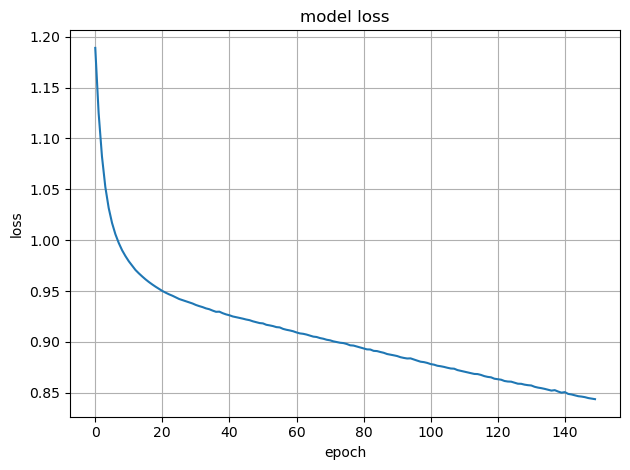

In [58]:
# summarize history for loss
plt.figure()
plt.grid()
plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
# plt.legend(['Training', 'Validation'], loc='upper left')
plt.tight_layout()
# plt.savefig('autoencoder_learning_curve_loss.png', dpi=300)
plt.show()

In [59]:
test_loss, test_acc = comp_model.evaluate(x_test_scaled, disease_labels_test, verbose=2)

print('\nTest accuracy:', test_acc)

3/3 - 0s - loss: 0.8572 - accuracy: 0.5256 - 101ms/epoch - 34ms/step

Test accuracy: 0.5256410241127014


In [65]:
y_pred_probs = comp_model.predict(x_test_scaled)
y_pred = np.argmax(y_pred_probs, axis=1)
y_pred

3/3 [==============================] - 0s 2ms/step


array([1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int64)

In [ ]:
from sklearn.metrics import accuracy_score, f1_score

In [66]:
accuracy_score(disease_labels_test, y_pred)

0.5256410256410257

In [67]:
y_pred_binary = y_pred.copy()
y_pred_binary[y_pred_binary==2] = 1

In [68]:
accuracy_score(disease_labels_test, y_pred_binary)

0.5256410256410257

In [61]:
x_test_scaled.iloc[[0],:]

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,MICA,LOC646430,LOC441956,ITGAV,SMCHD1,ASPN,TMEM97,LOC389458,PTPN7,RPS12P31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.84188,0.930171,0.886737,0.835678,0.297964,0.668498,0.26667,0.278122,0.93352,...,0.799811,0.0,0.0,0.315927,0.580699,0.652889,0.283662,0.02108,0.271046,0.0


In [62]:
comp_model.save("../data/models/cd_clf")

INFO:tensorflow:Assets written to: ../data/models/cd_clf\assets
